# **Quantitative Analysis to predicting index prices in emerging markets**

### **1. Packages and Preparation**

In [123]:
# Standard Packages
import pandas as pd
import matplotlib as plt
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import shap

# ML Models
# Linear Models
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from sklearn.linear_model import ElasticNet

# Tree-based models
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
import xgboost as xgb

# Others
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from scipy.stats import t
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.metrics import balanced_accuracy_score, roc_auc_score, make_scorer
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import MinMaxScaler

#### Load files

In [124]:
# Loading data for each country which is stored in different sheets:
# ------------------------------------------------------------------

# UNITED STATES
df_us = pd.read_excel('data.xlsx', sheet_name=('USA'))
df_us['Date'] = pd.to_datetime(df_us['Date'], format='%Y/%m/%d')
df_us.set_index('Date', inplace=True)
df_us.sort_index(inplace=True)
df_us = df_us.asfreq('D')
df_us = df_us.ffill()
df_us = df_us.asfreq('ME')
df_us['Price_log'] = np.log(df_us['Price'])

# CHINA
df_china = pd.read_excel('data.xlsx', sheet_name=('CHINA'))
df_china['Date'] = pd.to_datetime(df_china['Date'], format='%Y/%m/%d')
df_china.set_index('Date', inplace=True)
df_china.sort_index(inplace=True)
df_china = df_china.asfreq('D')
df_china = df_china.ffill()
df_china = df_china.asfreq('ME')
df_china['Price_log'] = np.log(df_china['Price'])

# INDIA
df_india = pd.read_excel('data.xlsx', sheet_name=('INDIA'))
df_india['Date'] = pd.to_datetime(df_india['Date'], format='%Y/%m/%d')
df_india.set_index('Date', inplace=True)
df_india.sort_index(inplace=True)
df_india = df_india.asfreq('D')
df_india = df_india.ffill()
df_india = df_india.asfreq('ME')
df_india['Price_log'] = np.log(df_india['Price'])

# INDONESIA
df_indonesia = pd.read_excel('data.xlsx', sheet_name=('INDONESIA'))
df_indonesia['Date'] = pd.to_datetime(df_indonesia['Date'], format='%Y/%m/%d')
df_indonesia.set_index('Date', inplace=True)
df_indonesia.sort_index(inplace=True)
df_indonesia = df_indonesia.asfreq('D')
df_indonesia = df_indonesia.ffill()
df_indonesia = df_indonesia.asfreq('ME')
df_indonesia['Price_log'] = np.log(df_indonesia['Price'])

# BRAZIL
df_brazil = pd.read_excel('data.xlsx', sheet_name=('BRAZIL'))
df_brazil['Date'] = pd.to_datetime(df_brazil['Date'], format='%Y/%m/%d')
df_brazil.set_index('Date', inplace=True)
df_brazil.sort_index(inplace=True)
df_brazil = df_brazil.asfreq('D')
df_brazil = df_brazil.ffill()
df_brazil = df_brazil.asfreq('ME')
df_brazil['Price_log'] = np.log(df_brazil['Price'])

# MEXICO
df_mexico = pd.read_excel('data.xlsx', sheet_name=('MEXICO'))
df_mexico['Date'] = pd.to_datetime(df_mexico['Date'], format='%Y/%m/%d')
df_mexico.set_index('Date', inplace=True)
df_mexico.sort_index(inplace=True)
df_mexico = df_mexico.asfreq('D')
df_mexico = df_mexico.ffill()
df_mexico = df_mexico.asfreq('ME')
df_mexico['Price_log'] = np.log(df_mexico['Price'])

# ARGENTINA
df_argentina = pd.read_excel('data.xlsx', sheet_name=('ARGENTINA'))
df_argentina['Date'] = pd.to_datetime(df_argentina['Date'], format='%Y/%m/%d')
df_argentina.set_index('Date', inplace=True)
df_argentina.sort_index(inplace=True)
df_argentina = df_argentina.asfreq('D')
df_argentina = df_argentina.ffill()
df_argentina = df_argentina.asfreq('ME')
df_argentina['Price_log'] = np.log(df_argentina['Price'])

# RUSSIA
df_russia = pd.read_excel('data.xlsx', sheet_name=('RUSSIA'))
df_russia['Date'] = pd.to_datetime(df_russia['Date'], format='%Y/%m/%d')
df_russia.set_index('Date', inplace=True)
df_russia.sort_index(inplace=True)
df_russia = df_russia.asfreq('D')
df_russia = df_russia.ffill()
df_russia = df_russia.asfreq('ME')
df_russia['Price_log'] = np.log(df_russia['Price'])

# POLAND
df_poland = pd.read_excel('data.xlsx', sheet_name=('POLAND'))
df_poland['Date'] = pd.to_datetime(df_poland['Date'], format='%Y/%m/%d')
df_poland.set_index('Date', inplace=True)
df_poland.sort_index(inplace=True)
df_poland = df_poland.asfreq('D')
df_poland = df_poland.ffill()
df_poland = df_poland.asfreq('ME')
df_poland['Price_log'] = np.log(df_poland['Price'])

# HUNGARY
df_hungary = pd.read_excel('data.xlsx', sheet_name=('HUNGARY'))
df_hungary['Date'] = pd.to_datetime(df_hungary['Date'], format='%Y/%m/%d')
df_hungary.set_index('Date', inplace=True)
df_hungary.sort_index(inplace=True)
df_hungary = df_hungary.asfreq('D')
df_hungary = df_hungary.ffill()
df_hungary = df_hungary.asfreq('ME')
df_hungary['Price_log'] = np.log(df_hungary['Price'])

# SOUTH AFRICA
df_safrica = pd.read_excel('data.xlsx', sheet_name=('SOUTH AFRICA'))
df_safrica['Date'] = pd.to_datetime(df_safrica['Date'], format='%Y/%m/%d')
df_safrica.set_index('Date', inplace=True)
df_safrica.sort_index(inplace=True)
df_safrica = df_safrica.asfreq('D')
df_safrica = df_safrica.ffill()
df_safrica = df_safrica.asfreq('ME')
df_safrica['Price_log'] = np.log(df_safrica['Price'])


# EGYPT
df_egypt = pd.read_excel('data.xlsx', sheet_name=('EGYPT'))
df_egypt['Date'] = pd.to_datetime(df_egypt['Date'], format='%Y/%m/%d')
df_egypt.set_index('Date', inplace=True)
df_egypt.sort_index(inplace=True)
df_egypt = df_egypt.asfreq('D')
df_egypt = df_egypt.ffill()
df_egypt = df_egypt.asfreq('ME')
df_egypt['Price_log'] = np.log(df_egypt['Price'])

# TURKEY
df_turkey = pd.read_excel('data.xlsx', sheet_name=('TURKEY'))
df_turkey['Date'] = pd.to_datetime(df_turkey['Date'], format='%Y/%m/%d')
df_turkey.set_index('Date', inplace=True)
df_turkey.sort_index(inplace=True)
df_turkey = df_turkey.asfreq('D')
df_turkey = df_turkey.ffill()
df_turkey = df_turkey.asfreq('ME')
df_turkey['Price_log'] = np.log(df_turkey['Price'])

# UAE
df_uae = pd.read_excel('data.xlsx', sheet_name=('UAE'))
df_uae['Date'] = pd.to_datetime(df_uae['Date'], format='%Y/%m/%d')
df_uae.set_index('Date', inplace=True)
df_uae.sort_index(inplace=True)
df_uae = df_uae.asfreq('D')
df_uae = df_uae.ffill()
df_uae = df_uae.asfreq('ME')
df_uae['Price_log'] = np.log(df_uae['Price'])


In [125]:
# Inspect the entire dataset
pd.set_option('display.max_columns', None)  # Show all columns
df_us.head(3)

,Price,P/E,P/B,P/S,D/E,ROE,ROA,P/CF,OpMargin,EV/EBITDA,D/A,FCFYield,NetProfMargin,EV/Sales,CurrRatio,Price_log
Date,,,,,,,,,,,,,,,,
2009-08-31,1020.63,17.6164,2.2528,1.1044,156.8641,5.7856,1.1301,9.2418,8.6329,9.6769,30.7683,6.6824,3.2861,1.5559,1.2816,6.928175
2009-09-30,1057.08,18.2267,2.1653,1.1439,156.6339,5.7656,1.1278,9.4437,8.6454,9.9607,30.7680,6.4807,3.2765,1.6012,1.2823,6.963266
2009-10-31,1036.20,17.8402,2.2332,1.1196,156.6316,5.9021,1.1526,8.9036,8.6484,9.7979,30.7678,6.6220,3.3434,1.5724,1.2823,6.943315


We have to check for NaN values to see if we obtained a full dataset.

This is done by creating a dicstionary of the countries for which have defined the dataframes above and then iterating through an NaN test.

In [126]:
# Initiate dictionary
dataframes = {
    'USA': df_us,
    'China': df_china,
    'India': df_india,
    'Indonesia': df_indonesia,
    'Brazil': df_brazil,
    'Mexico': df_mexico,
    'Argentina': df_argentina,
    'Russia': df_russia,
    'Poland': df_poland,
    'Hungary': df_hungary,
    'South Africa': df_safrica,
    'Egypt': df_egypt,
    'Turkey': df_turkey,
    'UAE': df_uae,
}

# Initialize list
results = []

# Iteration
for country, df in dataframes.items():
    columns_with_nan = df.columns[df.isna().any()].tolist()
    if columns_with_nan:
        results.append({'Country': country, 'Columns with NaN': columns_with_nan})

# Convert for viewing and display 
df_nan = pd.DataFrame(results)
if not df_nan.empty:
    print(df_nan)
else:
    print("No NaN values found in any of the dataframes.")

  Country                                   Columns with NaN
0   Egypt  [P/E, P/B, P/S, D/E, ROE, ROA, P/CF, OpMargin,...


[Status Aug 29, 2024: Egypt has NaN values at the beginning of the time series and we will drop it for conducting a first analysis and to set up the models first. After that, we will check if we can find data for Egypt and if not, perform the same analysis on a reduced dataset. 

In general, it still needs to be checked (probably manually) which countries do not have a consistant dataset and whether the filling method applied above is skewing the data. For example, not all financial ratios are available for China which reduces the available information and thus, prevents perfect comparability between all countries.]

In [127]:
# Basic transformations to create the target variable and one additional lagged variable to the observed value in t:
for country, df in dataframes.items():
    features_to_scale = df.columns.difference(['Price', 'Price_log']) # Filter for features
    
    # Scaling features
    scaler = StandardScaler()
    df[features_to_scale] = scaler.fit_transform(df[features_to_scale])
    
    # Create target and lagged value
    df['Price_log_t1'] = df['Price_log'].shift(-1)                          # Target
    df['Price_log_lagged'] = df['Price_log'].shift(1)                       # Lagged target
    
    df.drop(columns=['Price'], inplace=True)                                # Dropping 'Price' from table
    
    df.dropna(subset=['Price_log_t1', 'Price_log_lagged'], inplace=True)    # Droping the NaN rows that emerge after shifting:

In [128]:
df_us.head()

,P/E,P/B,P/S,D/E,ROE,ROA,P/CF,OpMargin,EV/EBITDA,D/A,FCFYield,NetProfMargin,EV/Sales,CurrRatio,Price_log,Price_log_t1,Price_log_lagged
Date,,,,,,,,,,,,,,,,,
2009-09-30,-0.292991,0.731300,-1.500447,3.554699,-3.070422,-3.273689,-1.074153,-2.980783,-0.882434,2.876620,1.303563,-3.501386,-1.228705,-0.874715,6.963266,6.943315,6.928175
2009-10-31,-0.392064,0.974972,-1.544752,3.554485,-3.021892,-3.230654,-1.279830,-2.978634,-0.947588,2.876509,1.429665,-3.460910,-1.283192,-0.874715,6.943315,6.999085,6.963266
2009-11-30,0.218907,0.587393,-1.311922,2.514719,-3.144017,-3.217813,-1.163111,-3.021396,-0.593244,2.299331,1.097765,-3.396958,-1.118596,-0.206274,6.999085,7.016699,6.943315
2009-12-31,0.317980,0.359153,-1.271628,2.501341,-3.155999,-3.227531,-1.189577,-3.044031,-0.489389,2.296101,1.015304,-3.407546,-1.050109,-0.187222,7.016699,6.979024,6.999085
2010-01-31,0.119629,0.955594,-1.363885,2.501332,-3.105300,-3.178944,-1.433107,-3.071322,-0.615615,2.296101,1.224938,-3.363439,-1.148867,-0.187222,6.979024,7.007139,7.016699


### **3. Dictionary Model Evaluation**

In [129]:
# Initialize dicitonaries to store testing results and create tables
model_evaluations = {}
model_residuals = {}
model_predictions = {}
models = {}
X_tests = {}

# Set up a list again: Egypt excluded for now, but will be included later again.
countries = {
    'USA': df_us,
    'China': df_china,
    'India': df_india,
    'Indonesia': df_indonesia,
    'Brazil': df_brazil,
    'Mexico': df_mexico,
    'Argentina': df_argentina,
    'Russia': df_russia,
    'Poland': df_poland,
    'Hungary': df_hungary,
    'South Africa': df_safrica,
    'Turkey': df_turkey,
    'UAE': df_uae,
}

# Model evaluation
def update_model_evaluation(model_name, country, y_test, y_pred):
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_test, y_pred)
    
    if country not in model_evaluations:
        model_evaluations[country] = {}
    if country not in model_predictions:
        model_predictions[country] = {}
        
    # Updating and adding evaluation metric dependent on existing name for country
    model_evaluations[country][model_name] = {
        'MSE': mse,
        'RMSE': rmse,
        'R2': r2
    }
    model_predictions[country][model_name] = y_pred  # Store predicted values for y

# Displaying the evaluation tables
def display_evaluation_tables(metrics=['R2', 'RMSE']):
    for metric in metrics:
        data = {}
        
        for country, evaluations in model_evaluations.items():
            for model, metrics in evaluations.items():
                if model not in data:
                    data[model] = {}
                data[model][country] = metrics[metric]
        
        df_eval = pd.DataFrame(data)
        
        print(f"--- {metric} Evaluation Table ---")
        display(df_eval)

### **4. Machine Learning Models**

In [130]:
# List of countries [To be harmonized with list above: Initiate only once]
countries = {
    'USA': df_us,
    'China': df_china,
    'India': df_india,
    'Indonesia': df_indonesia,
    'Brazil': df_brazil,
    'Mexico': df_mexico,
    'Argentina': df_argentina,
    'Russia': df_russia,
    'Poland': df_poland,
    'Hungary': df_hungary,
    'South Africa': df_safrica,
    'Turkey': df_turkey,
    'UAE': df_uae,
}

#### **1. Linear Regression**

In [131]:
# Check dataframe again before executing machine learning applications
df_us.head()

,P/E,P/B,P/S,D/E,ROE,ROA,P/CF,OpMargin,EV/EBITDA,D/A,FCFYield,NetProfMargin,EV/Sales,CurrRatio,Price_log,Price_log_t1,Price_log_lagged
Date,,,,,,,,,,,,,,,,,
2009-09-30,-0.292991,0.731300,-1.500447,3.554699,-3.070422,-3.273689,-1.074153,-2.980783,-0.882434,2.876620,1.303563,-3.501386,-1.228705,-0.874715,6.963266,6.943315,6.928175
2009-10-31,-0.392064,0.974972,-1.544752,3.554485,-3.021892,-3.230654,-1.279830,-2.978634,-0.947588,2.876509,1.429665,-3.460910,-1.283192,-0.874715,6.943315,6.999085,6.963266
2009-11-30,0.218907,0.587393,-1.311922,2.514719,-3.144017,-3.217813,-1.163111,-3.021396,-0.593244,2.299331,1.097765,-3.396958,-1.118596,-0.206274,6.999085,7.016699,6.943315
2009-12-31,0.317980,0.359153,-1.271628,2.501341,-3.155999,-3.227531,-1.189577,-3.044031,-0.489389,2.296101,1.015304,-3.407546,-1.050109,-0.187222,7.016699,6.979024,6.999085
2010-01-31,0.119629,0.955594,-1.363885,2.501332,-3.105300,-3.178944,-1.433107,-3.071322,-0.615615,2.296101,1.224938,-3.363439,-1.148867,-0.187222,6.979024,7.007139,7.016699


In [132]:
model_name = 'Linear Regression'
model_linear = LinearRegression()

# Iteration for countries
for country, df in countries.items():
        
    features = df.columns.difference(['Price_log_t1'])
    target_column = 'Price_log_t1'
    
    train_df = df[(df.index >= '2009-09-01') & (df.index <= '2020-12-31')]
    test_df = df[(df.index >= '2021-01-01') & (df.index <= '2024-12-31')]
    
    X_train = train_df[features]
    y_train = train_df[target_column]
    X_test = test_df[features]
    y_test = test_df[target_column]
    
    model_linear.fit(X_train, y_train)
    y_pred = model_linear.predict(X_test)

    models[f'model_linear_{country}'] = model_linear
    X_tests[country] = X_test
    
    # Update evaluations
    update_model_evaluation(model_name, country, y_test, y_pred)
    
    residuals = y_test - y_pred
    if country not in model_residuals:
        model_residuals[country] = {}
    model_residuals[country][model_name] = residuals

display_evaluation_tables(['R2', 'MSE', 'RMSE'])

--- R2 Evaluation Table ---


,Linear Regression
USA,0.391993
China,-0.158996
India,0.295948
Indonesia,0.612949
Brazil,-1.489173
Mexico,-1.215612
Argentina,0.811296
Russia,0.856806
Poland,0.527268
Hungary,-0.007221


--- MSE Evaluation Table ---


,Linear Regression
USA,0.006201
China,0.005368
India,0.012141
Indonesia,0.001479
Brazil,0.014823
Mexico,0.009497
Argentina,0.242288
Russia,0.006574
Poland,0.009892
Hungary,0.031218


--- RMSE Evaluation Table ---


,Linear Regression
USA,0.078746
China,0.073265
India,0.110186
Indonesia,0.038452
Brazil,0.121748
Mexico,0.097452
Argentina,0.492227
Russia,0.081078
Poland,0.099456
Hungary,0.176685


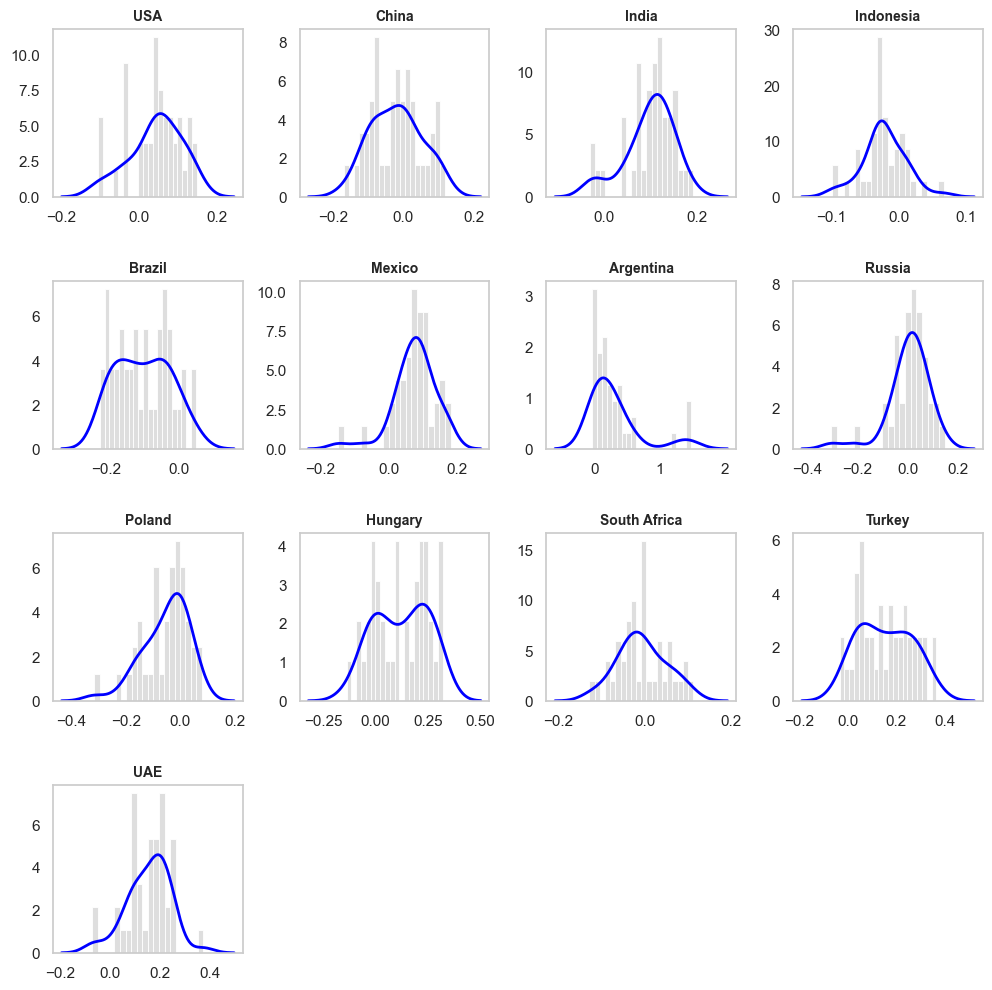

In [133]:
plt.close('all')  # Close figures clearing cache (Previously ran into an error without this part)

sns.set(style="whitegrid")

n_countries = len(countries)
n_cols = 4 
n_rows = (n_countries // n_cols) + (n_countries % n_cols > 0)

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(12, 3 * n_rows))
fig.subplots_adjust(hspace=0.5, wspace=0.3)

axes = axes.flatten()

for i, (country, residual_dict) in enumerate(model_residuals.items()):
    ax = axes[i]
    if 'Linear Regression' in residual_dict:
        residuals = residual_dict['Linear Regression']

        sns.histplot(residuals, bins=20, kde=False, color="lightgrey", ax=ax, stat="density")
        sns.kdeplot(residuals, color="blue", ax=ax, lw=2)

        ax.set_title(f'{country}', fontsize=10, fontweight='bold')
        ax.set_xlabel(None)
        ax.set_ylabel(None)
        ax.grid(False)

for j in range(i + 1, len(axes)):
    axes[j].set_visible(False)

plt.show()

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/2905539675.py:63: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


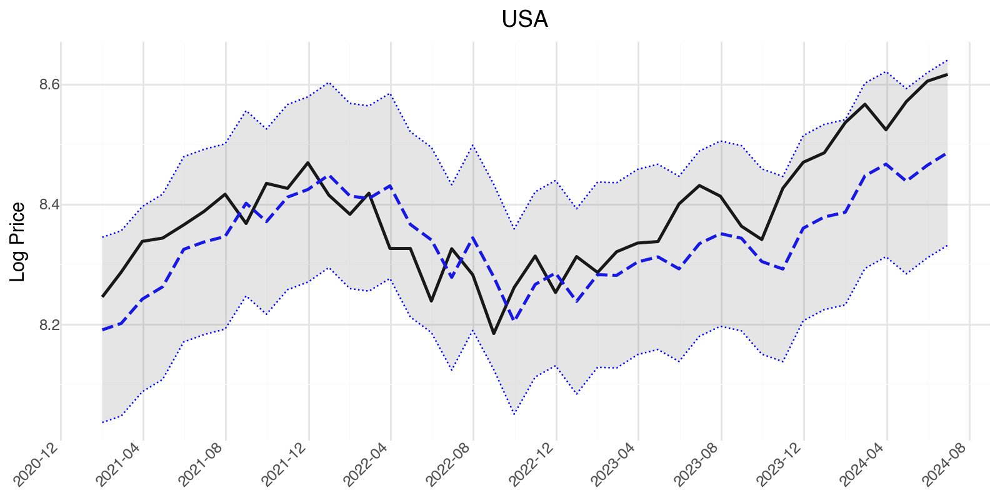

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/2905539675.py:63: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


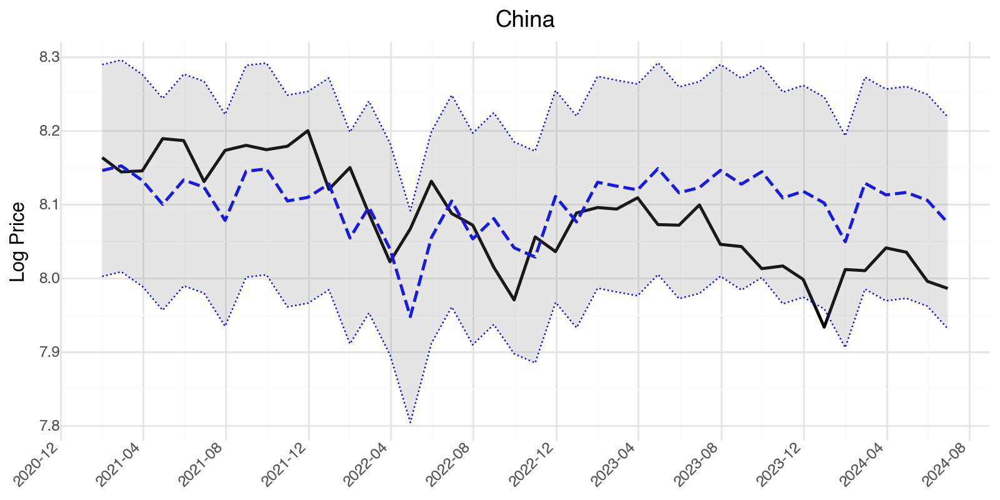

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/2905539675.py:63: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


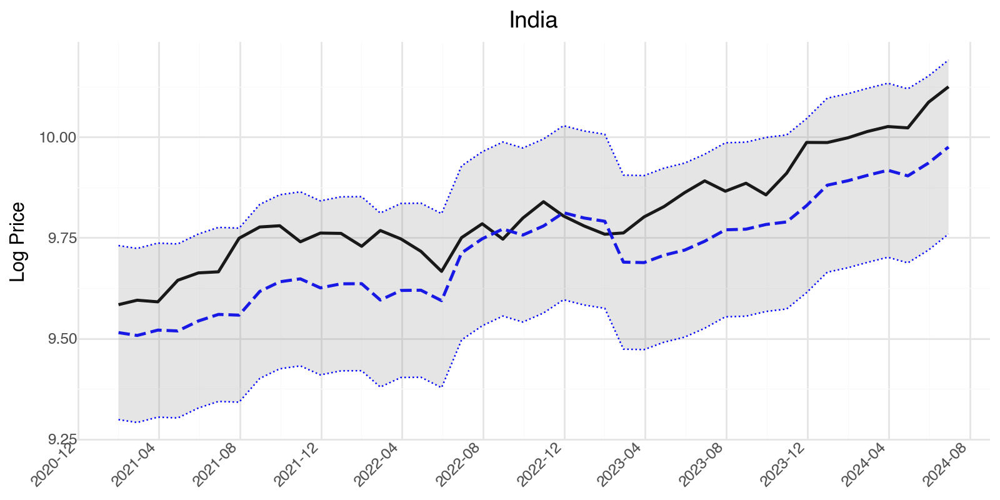

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/2905539675.py:63: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


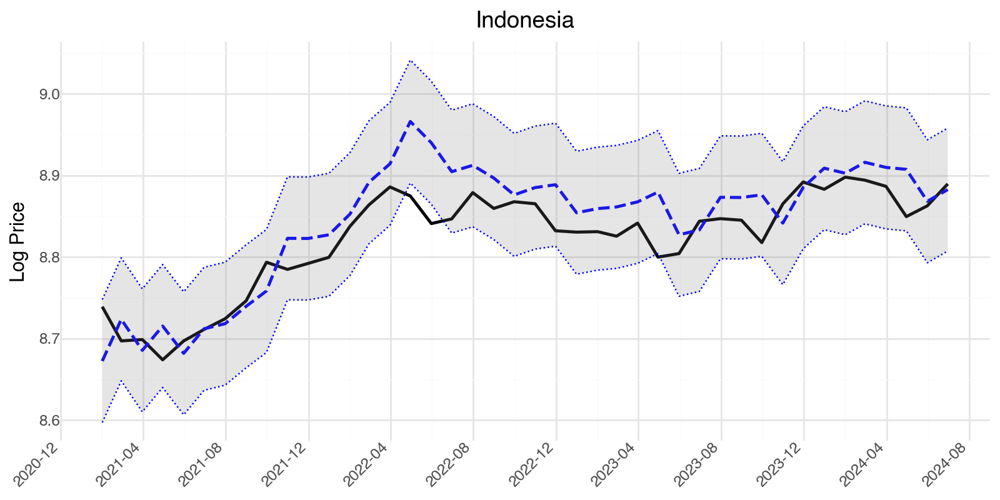

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/2905539675.py:63: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


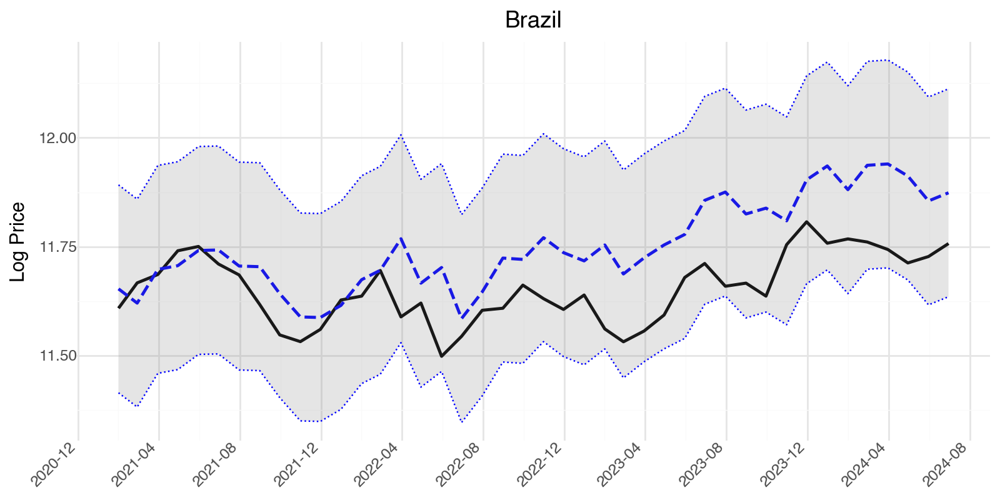

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/2905539675.py:63: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


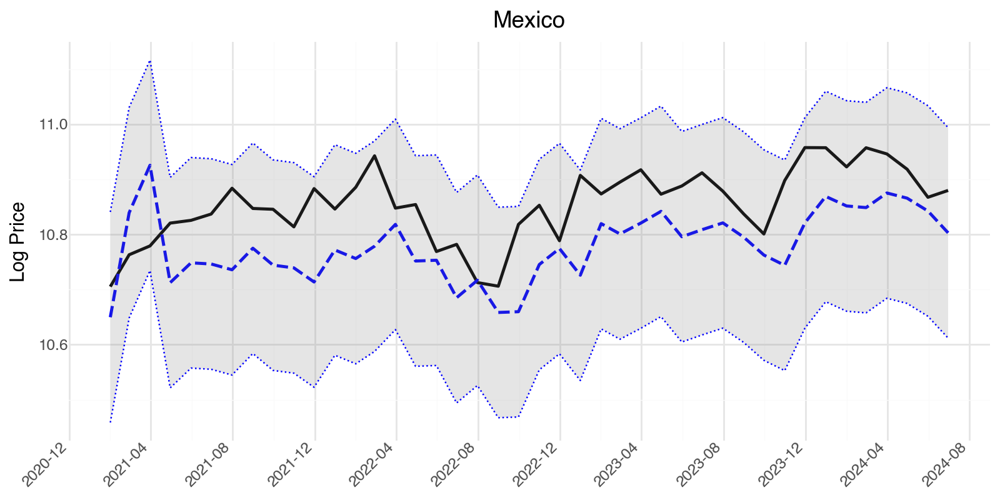

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/2905539675.py:63: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


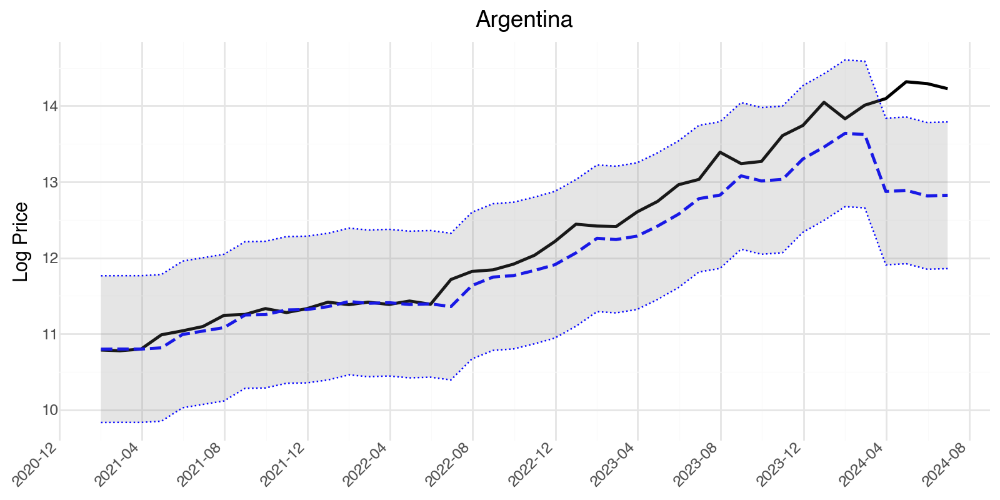

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/2905539675.py:63: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


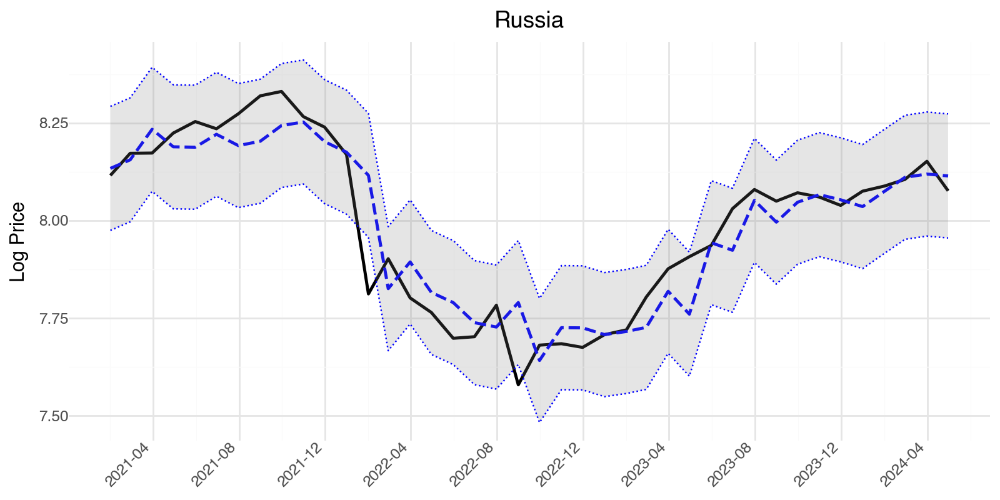

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/2905539675.py:63: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


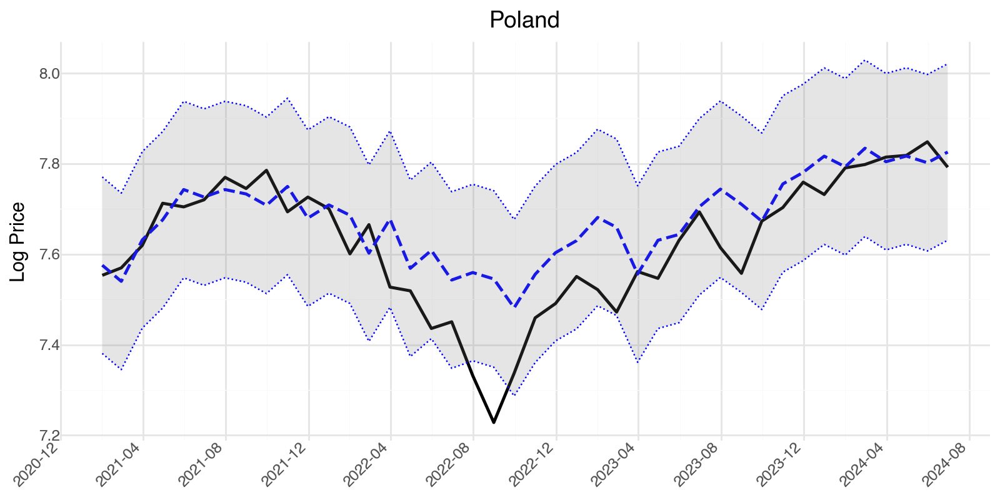

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/2905539675.py:63: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


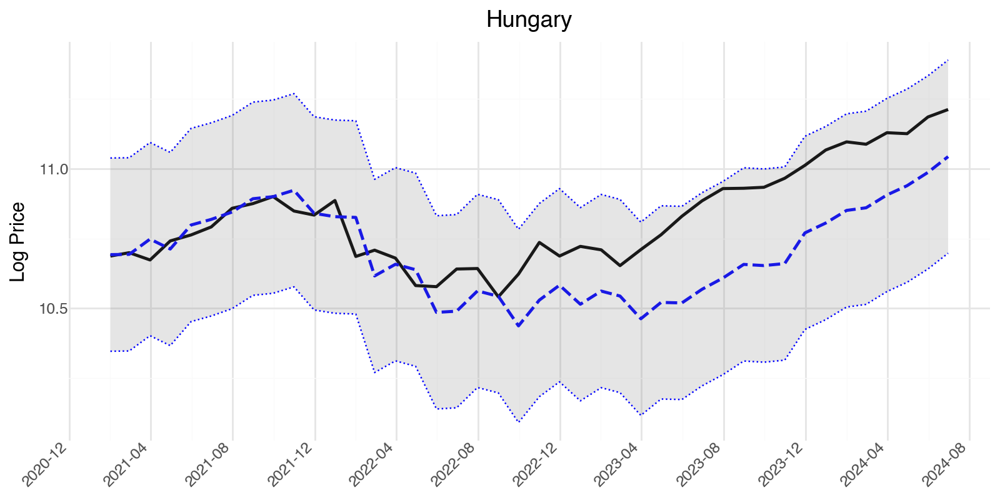

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/2905539675.py:63: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


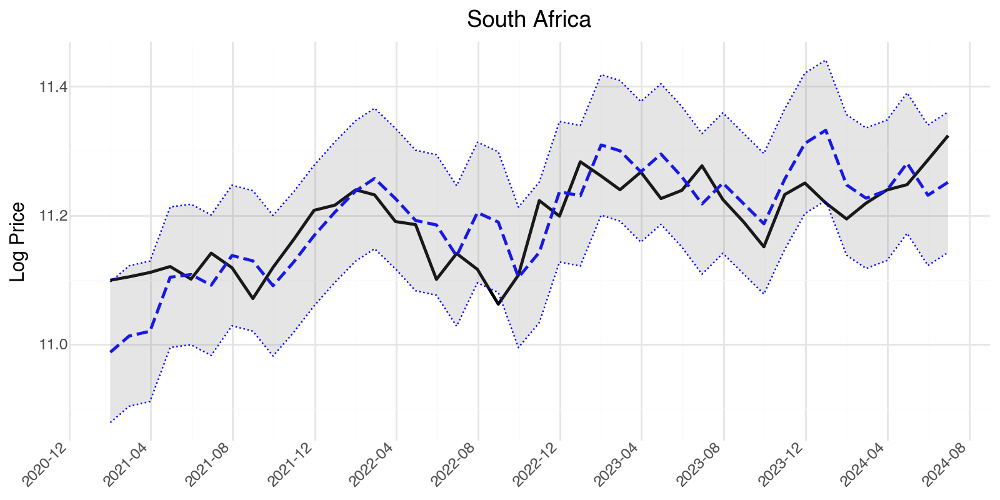

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/2905539675.py:63: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


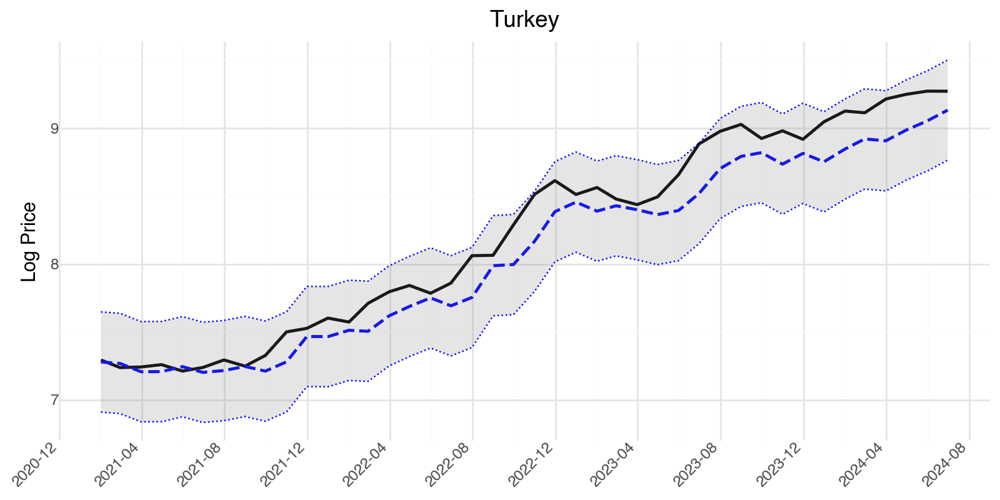

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/2905539675.py:63: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


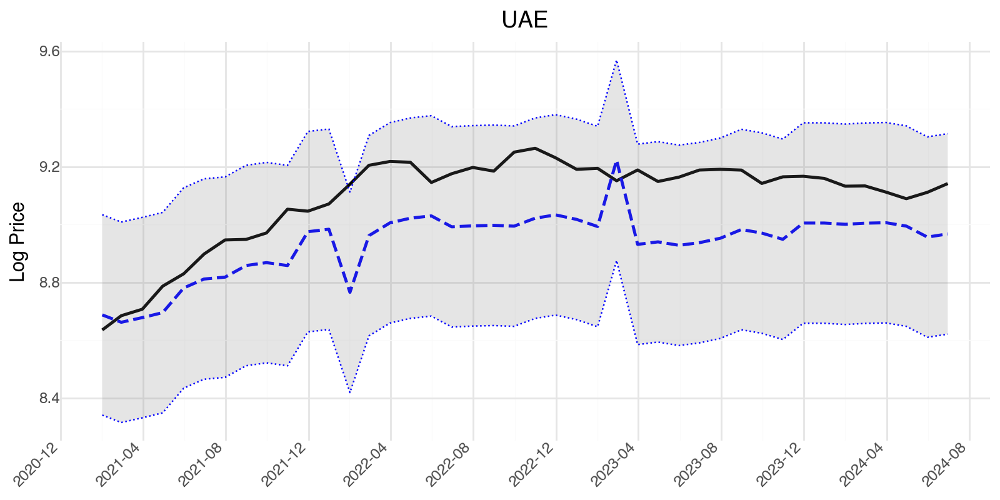

In [134]:
from plotnine import *

def calculate_confidence_intervals(y_pred, y_test, confidence=0.95):
    """
    Calculate the confidence intervals for predictions.
    """
    mse = mean_squared_error(y_test, y_pred)
    se = np.sqrt(mse)
    ci_range = se * 1.96
    lower_bound = y_pred - ci_range
    upper_bound = y_pred + ci_range
    return lower_bound, upper_bound

def plot_actual_vs_predicted_ggplot(countries_data, predictions, original_dfs):
    """
    Create ggplot-style subplots of actual vs. predicted values for each country with confidence intervals.
    """
    plots = []
    for country, test_df in countries_data.items():
        original_df = original_dfs[country]

        y_actual = original_df.loc[test_df.index, 'Price_log_t1']
        y_pred = predictions[country]['Linear Regression']
        
        # Confidence intervals
        lower_bound, upper_bound = calculate_confidence_intervals(y_pred, y_actual)
        
        df_plot = pd.DataFrame({
            'Date': test_df.index,
            'Actual': y_actual,
            'Predicted': y_pred,
            'Lower': lower_bound,
            'Upper': upper_bound
        })
        
        # ggplot
        p = (ggplot(df_plot, aes(x='Date')) +
             geom_line(aes(y='Actual'), color='black', size=1.0) +
             geom_line(aes(y='Predicted'), color='blue', linetype='dashed', size=1.0) +
             geom_ribbon(aes(ymin='Lower', ymax='Upper'), alpha=0.2, fill='grey') +
             geom_line(aes(y='Lower'), linetype='dotted', color='blue', size=0.5) +  # Lower bound
             geom_line(aes(y='Upper'), linetype='dotted', color='blue', size=0.5) +  # Upper bound
             ggtitle(f'{country}') +
             scale_x_datetime(date_labels='%Y-%m', date_breaks='4 months') +
             xlab('') + 
             ylab('Log Price') +
             theme_minimal() +
             theme(
                 axis_text_x=element_text(rotation=45, hjust=1),
                 figure_size=(8, 4),
             ))
        
        plots.append(p)
    
    return plots

plots = plot_actual_vs_predicted_ggplot(X_tests, model_predictions, countries)

for p in plots:
    print(p)


SHAP value analysis

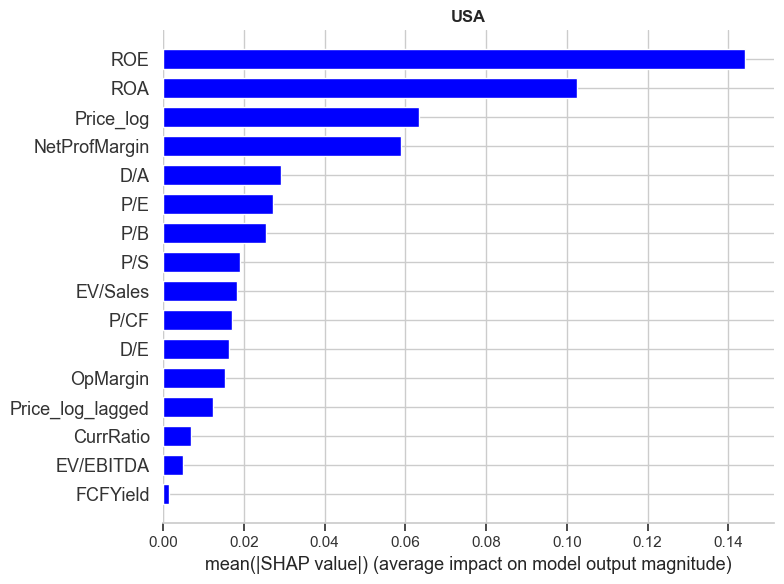

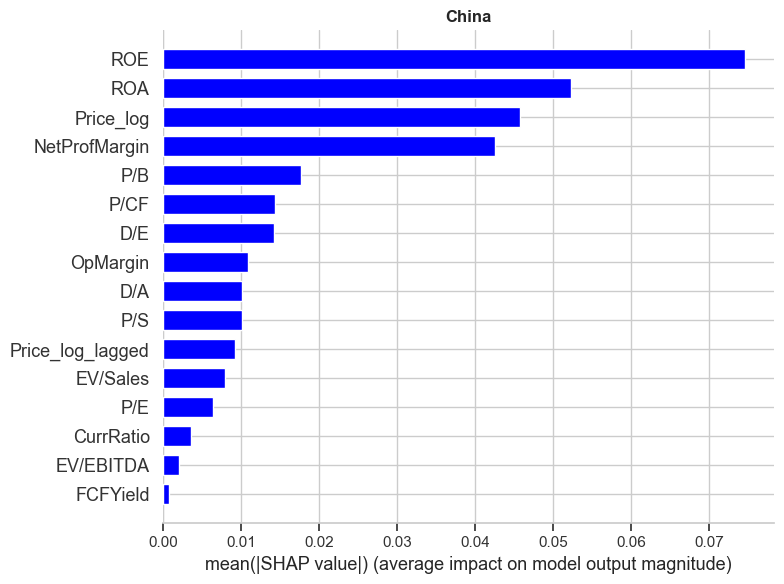

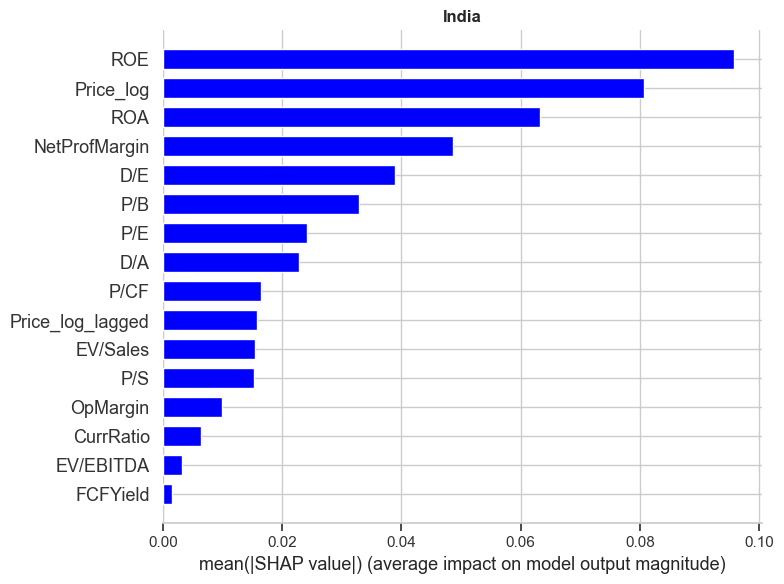

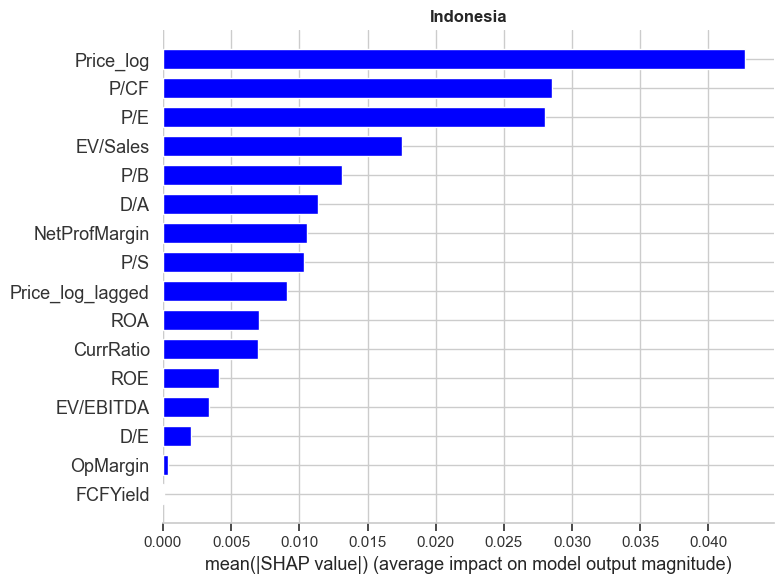

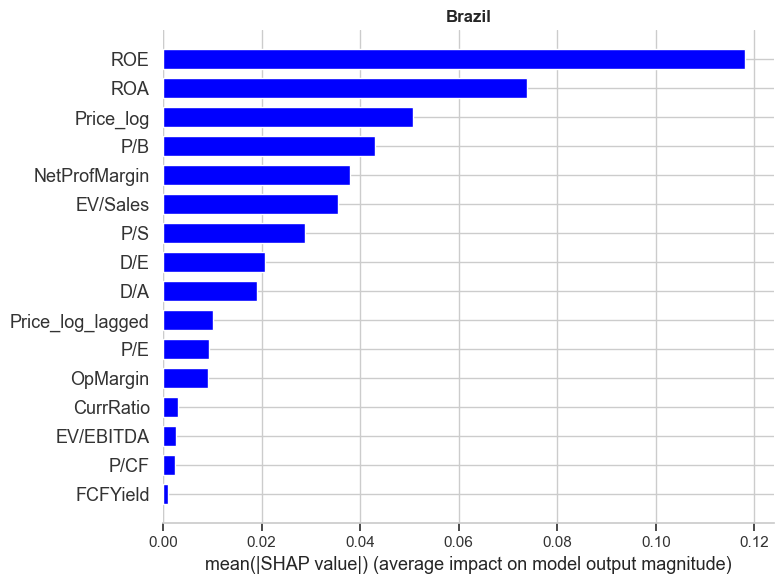

...

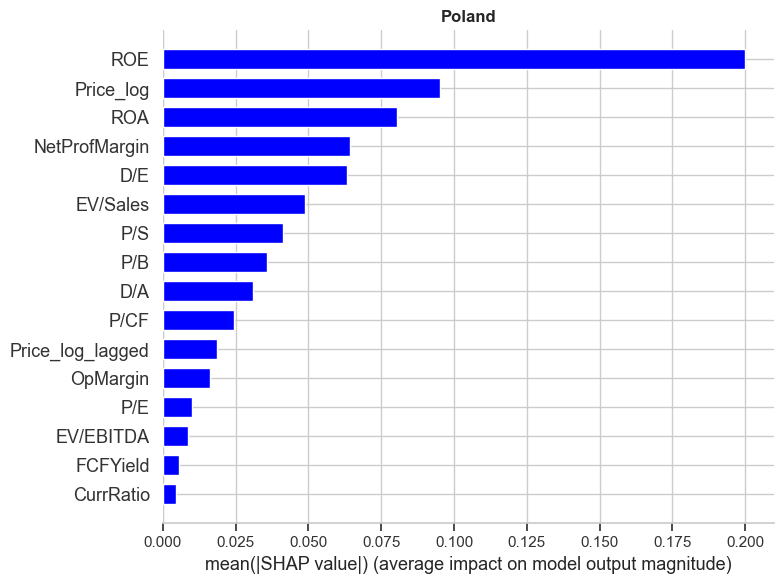

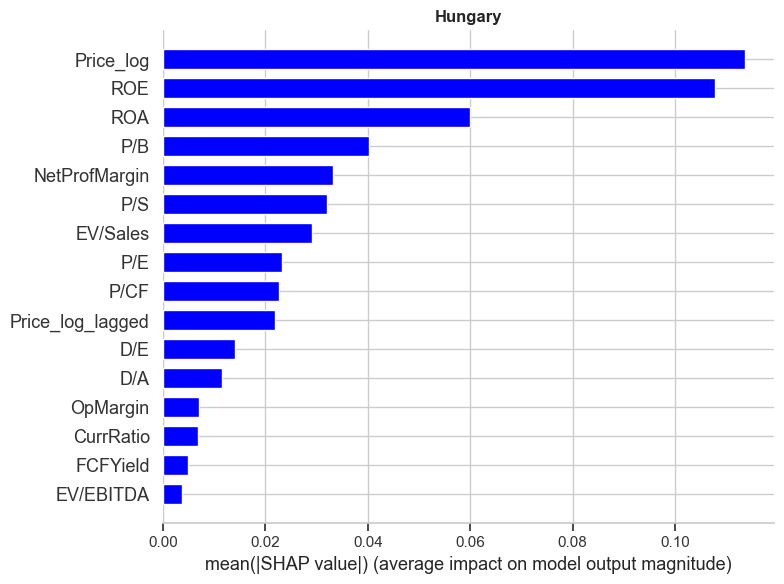

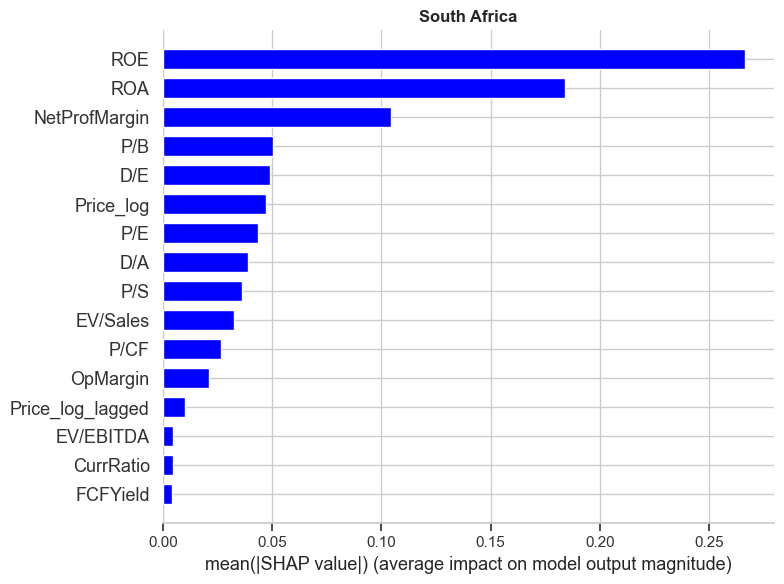

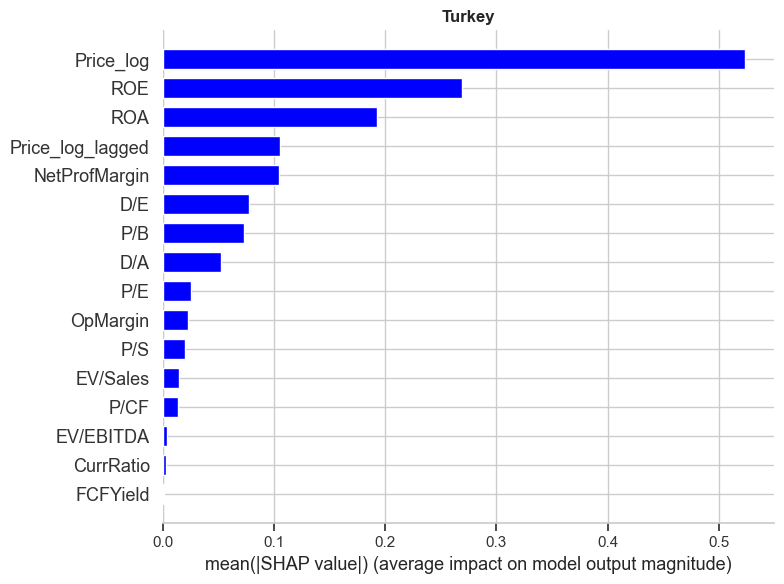

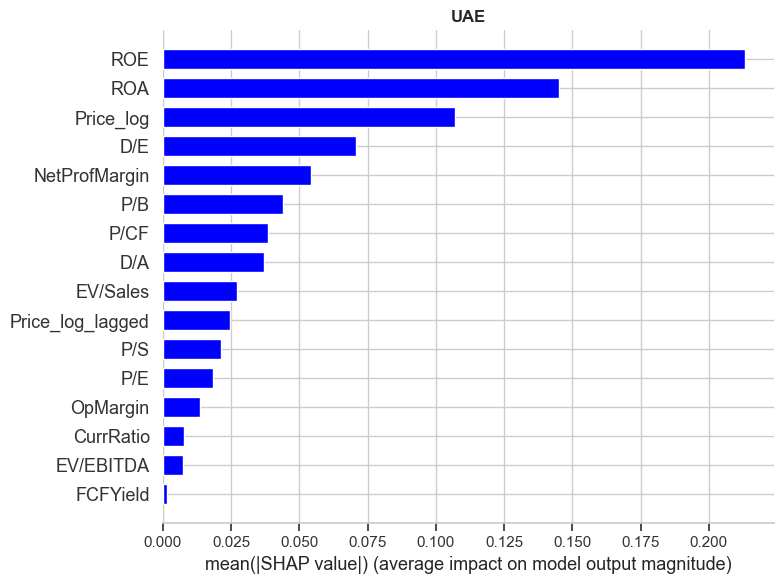

In [135]:
def plot_shap_summary_linear(models, X_tests):
    
    for country in X_tests:
        model_key = f'model_linear_{country}'
        model = models.get(model_key)
        X_test = X_tests.get(country)

        if model is not None and X_test is not None:
            # Initialize SHAP Explainer
            explainer = shap.Explainer(model, X_test)
            shap_values = explainer(X_test)

            # Plotting values
            plt.figure()
            plt.title(f'{country}', fontweight='bold')
            shap.summary_plot(shap_values, X_test, plot_type="bar", plot_size=(8, 6), color='blue')
        else:
            print(f"Model or X_test not found for {country} using Linear Regression.")

plot_shap_summary_linear(models, X_tests)

#### **2. Lasso Regression**

In [136]:
model_name = 'Lasso Regression'
lasso = Lasso(max_iter=250000)
parameters = {'alpha': [1e-4, 1e-3, 1e-2, 1, 5, 10, 20]}

for country, df in countries.items():
        
    features = df.columns.difference(['Price_log_t1'])
    target_column = 'Price_log_t1'
    
    train_df = df[(df.index >= '2009-09-01') & (df.index <= '2020-12-31')]
    test_df = df[(df.index >= '2021-01-01') & (df.index <= '2024-12-31')]
    
    X_train = train_df[features]
    y_train = train_df[target_column]
    X_test = test_df[features]
    y_test = test_df[target_column]
    
    tscv = TimeSeriesSplit(n_splits=5)
    model_lasso = GridSearchCV(lasso, parameters, scoring='neg_mean_squared_error', cv=tscv)
    model_lasso.fit(X_train, y_train)
    y_pred = model_lasso.predict(X_test)

    models[f'model_lasso_{country}'] = model_lasso
    X_tests[country] = X_test
    
    update_model_evaluation(model_name, country, y_test, y_pred)
    
    residuals = y_test - y_pred
    if country not in model_residuals:
        model_residuals[country] = {}
    model_residuals[country][model_name] = residuals

display_evaluation_tables(['R2', 'MSE', 'RMSE'])

--- R2 Evaluation Table ---


,Linear Regression,Lasso Regression
USA,0.391993,0.589591
China,-0.158996,0.022098
India,0.295948,-0.214268
Indonesia,0.612949,0.718325
Brazil,-1.489173,-25.170222
Mexico,-1.215612,-1.103536
Argentina,0.811296,0.961424
Russia,0.856806,0.842237
Poland,0.527268,0.406225
Hungary,-0.007221,-0.085244


--- MSE Evaluation Table ---


,Linear Regression,Lasso Regression
USA,0.006201,0.004186
China,0.005368,0.004529
India,0.012141,0.020939
Indonesia,0.001479,0.001076
Brazil,0.014823,0.155839
Mexico,0.009497,0.009017
Argentina,0.242288,0.049530
Russia,0.006574,0.007242
Poland,0.009892,0.012424
Hungary,0.031218,0.033636


--- RMSE Evaluation Table ---


,Linear Regression,Lasso Regression
USA,0.078746,0.064696
China,0.073265,0.067299
India,0.110186,0.144704
Indonesia,0.038452,0.032803
Brazil,0.121748,0.394764
Mexico,0.097452,0.094955
Argentina,0.492227,0.222553
Russia,0.081078,0.085102
Poland,0.099456,0.111464
Hungary,0.176685,0.183401


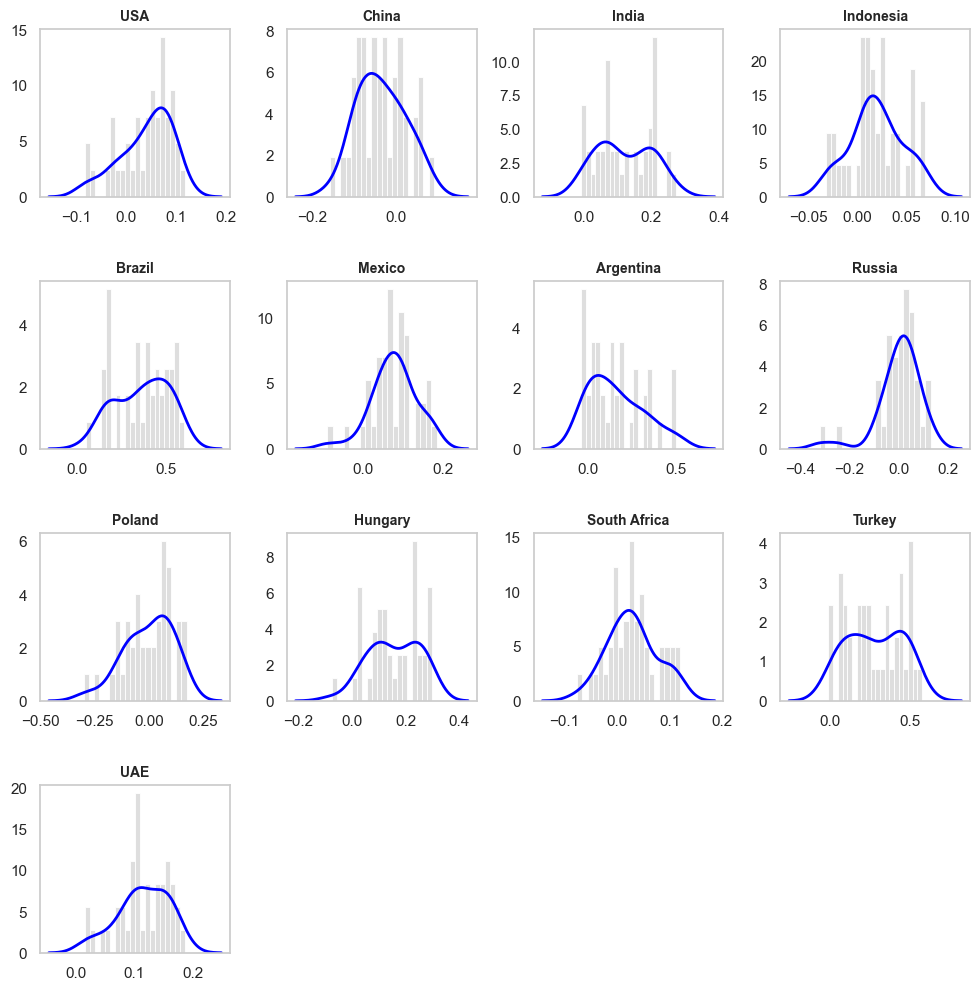

In [137]:
plt.close('all')
sns.set(style="whitegrid")

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(12, 3 * n_rows))
fig.subplots_adjust(hspace=0.5, wspace=0.3)
axes = axes.flatten()

for i, (country, residual_dict) in enumerate(model_residuals.items()):
    ax = axes[i]
    if 'Lasso Regression' in residual_dict:
        residuals = residual_dict['Lasso Regression']
        sns.histplot(residuals, bins=20, kde=False, color="lightgrey", ax=ax, stat="density")
        sns.kdeplot(residuals, color="blue", ax=ax, lw=2)
        ax.set_title(f'{country}', fontsize=10, fontweight='bold')
        ax.set_xlabel(None)
        ax.set_ylabel(None)
        ax.grid(False)

for j in range(i + 1, len(axes)):
    axes[j].set_visible(False)

plt.show()

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/790982506.py:58: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


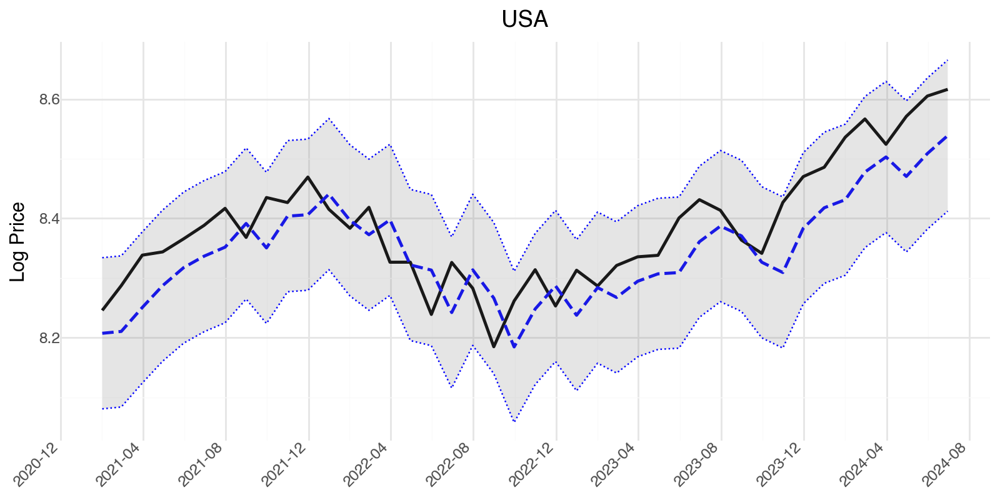

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/790982506.py:58: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


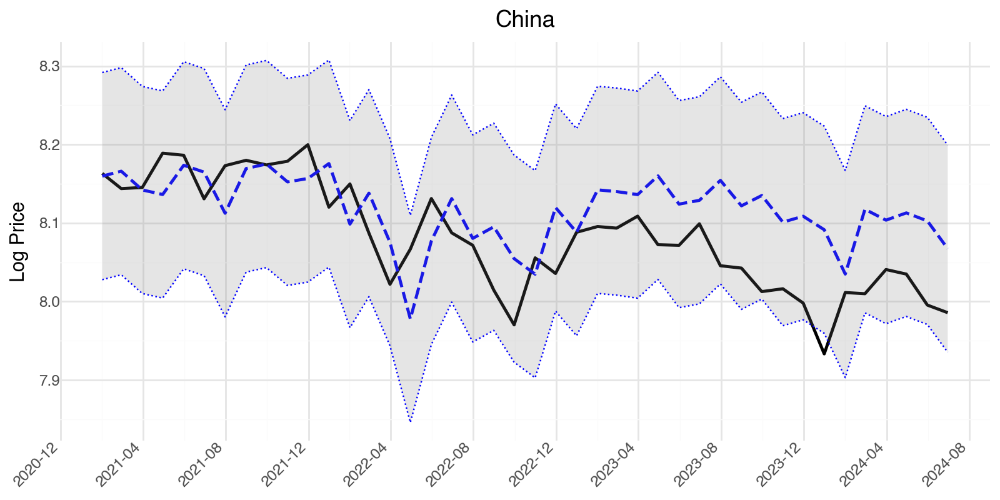

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/790982506.py:58: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


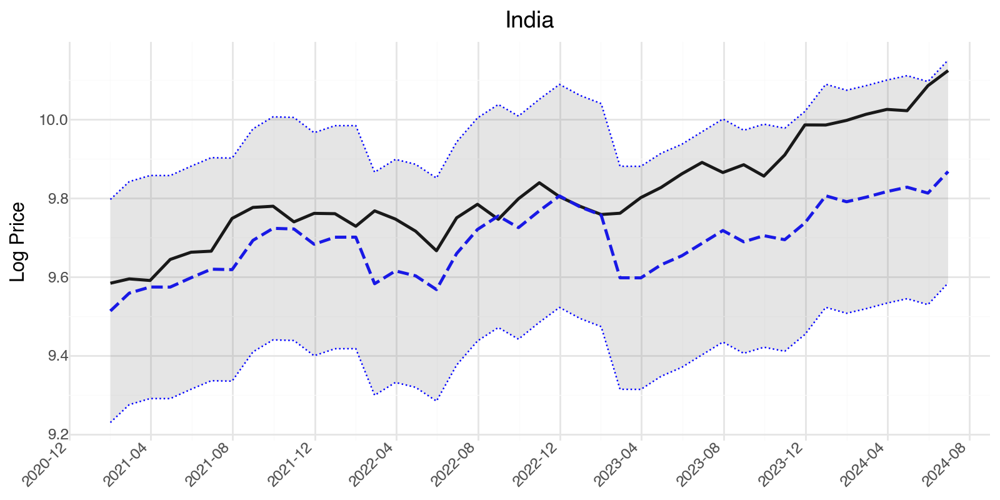

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/790982506.py:58: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


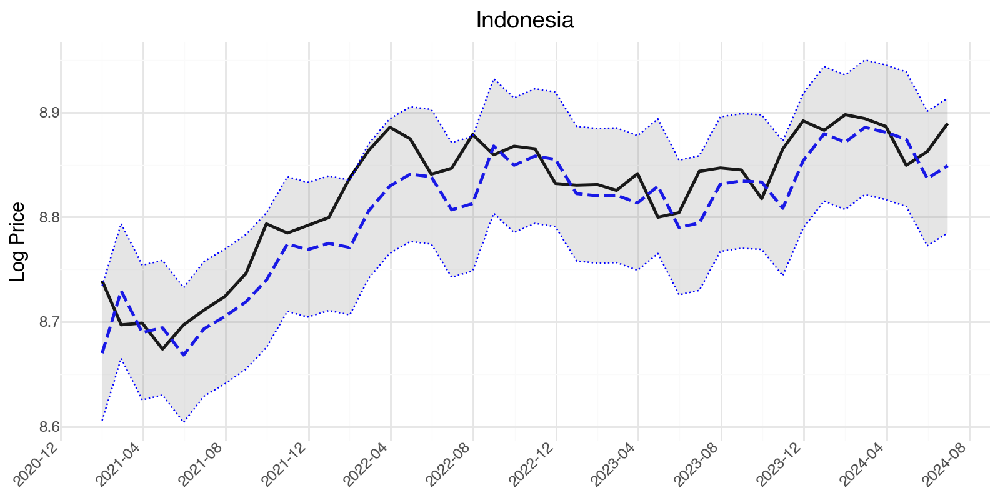

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/790982506.py:58: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


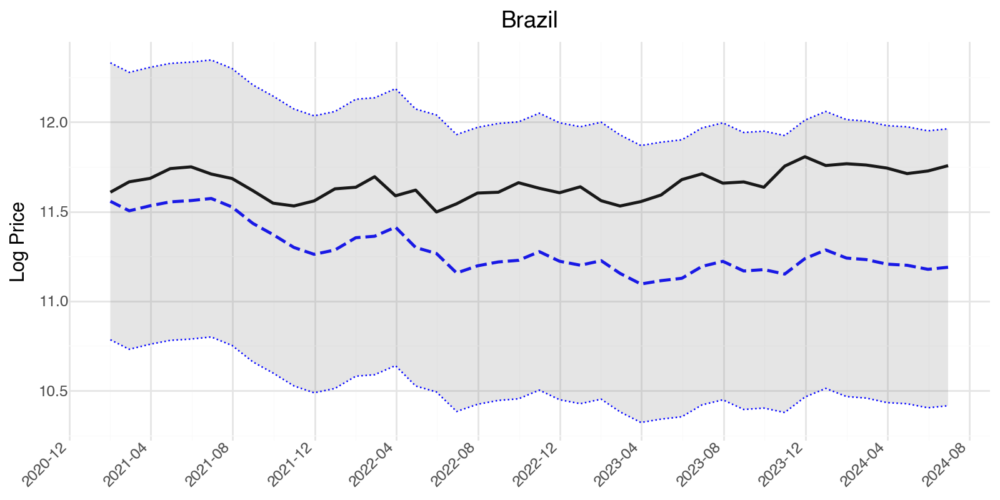

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/790982506.py:58: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


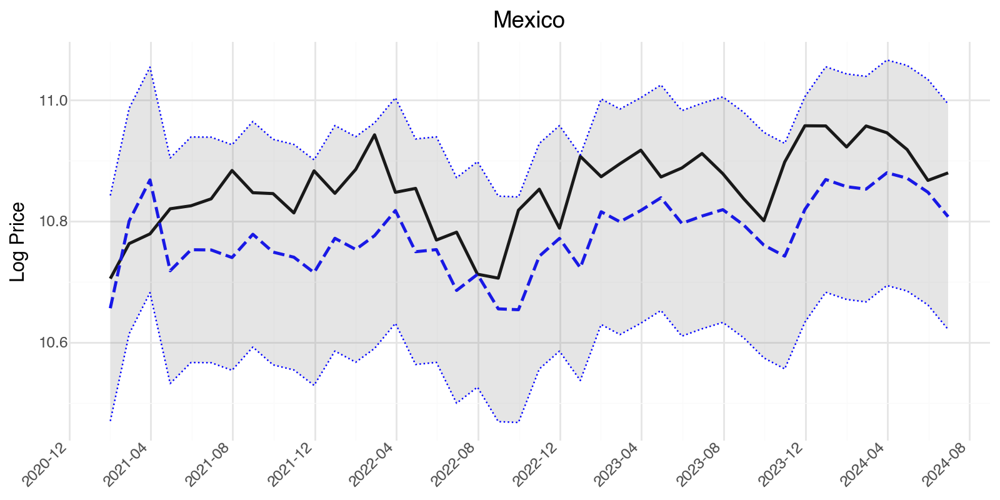

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/790982506.py:58: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


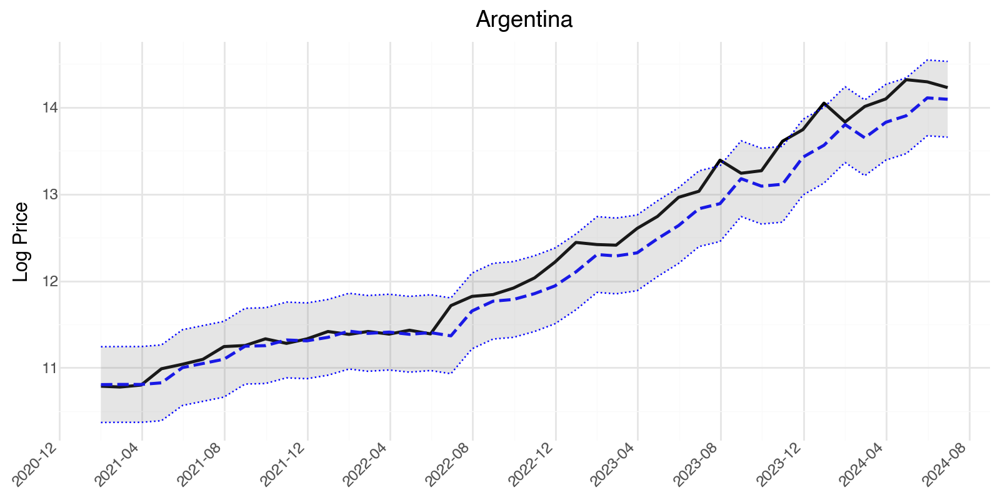

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/790982506.py:58: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


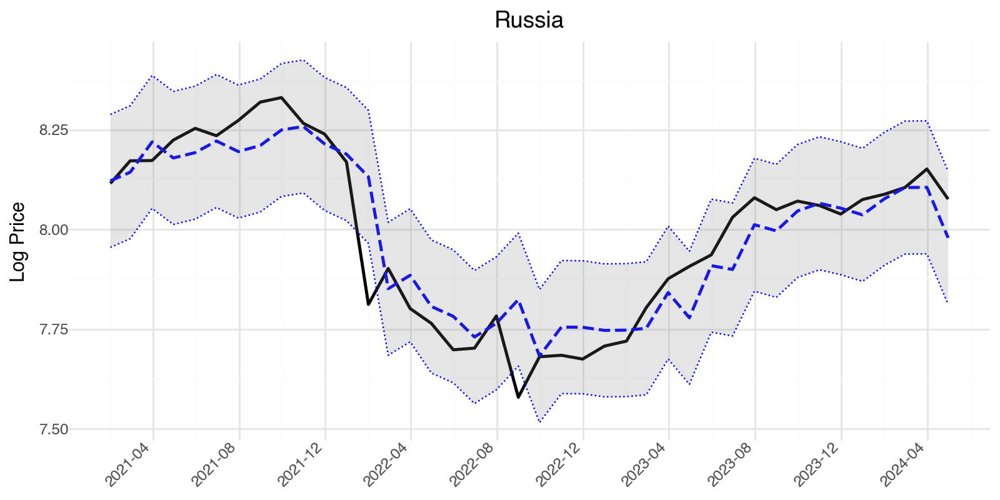

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/790982506.py:58: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


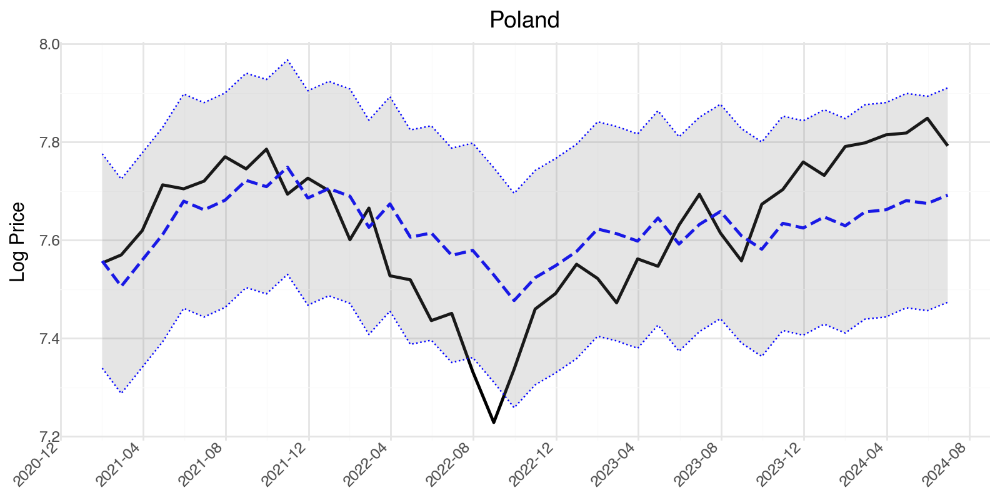

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/790982506.py:58: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


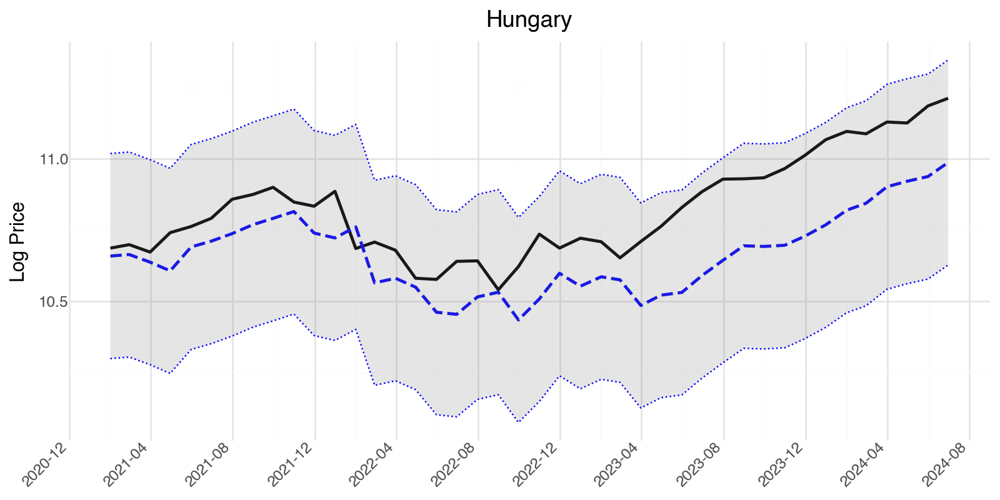

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/790982506.py:58: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


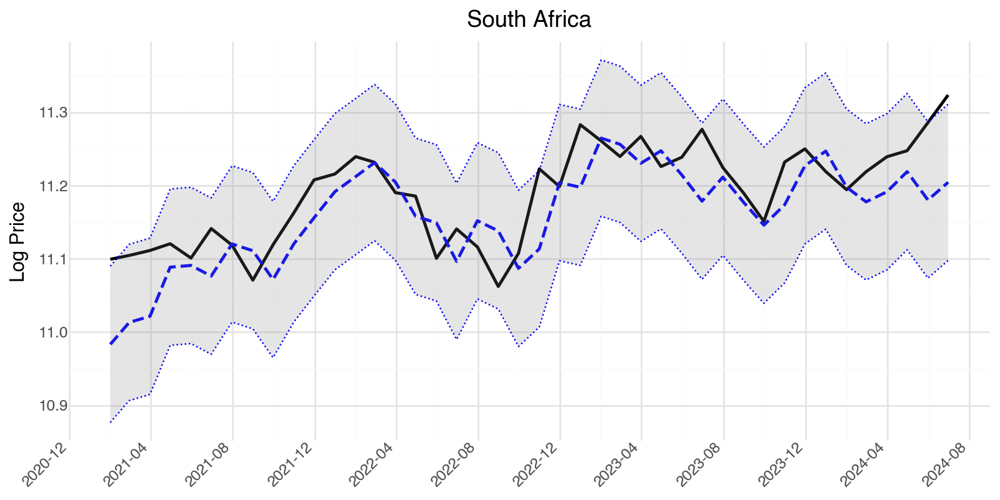

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/790982506.py:58: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


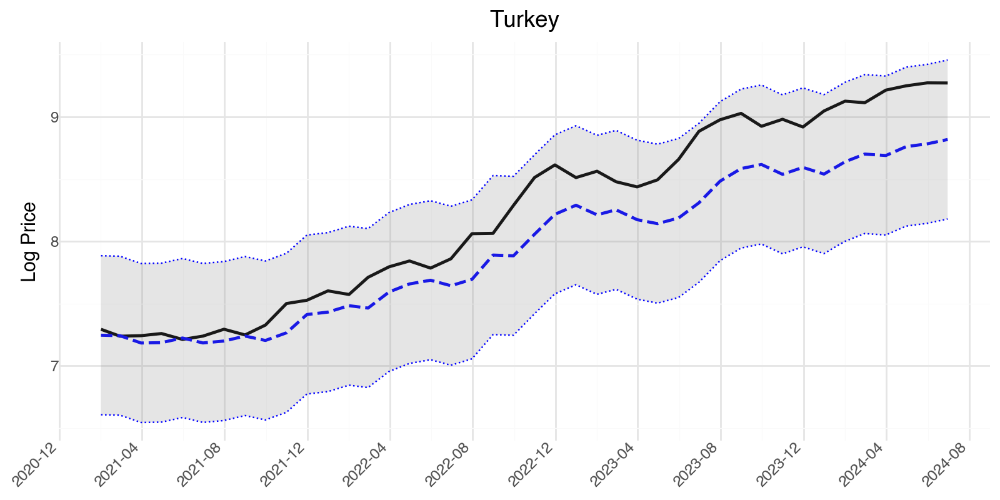

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/790982506.py:58: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


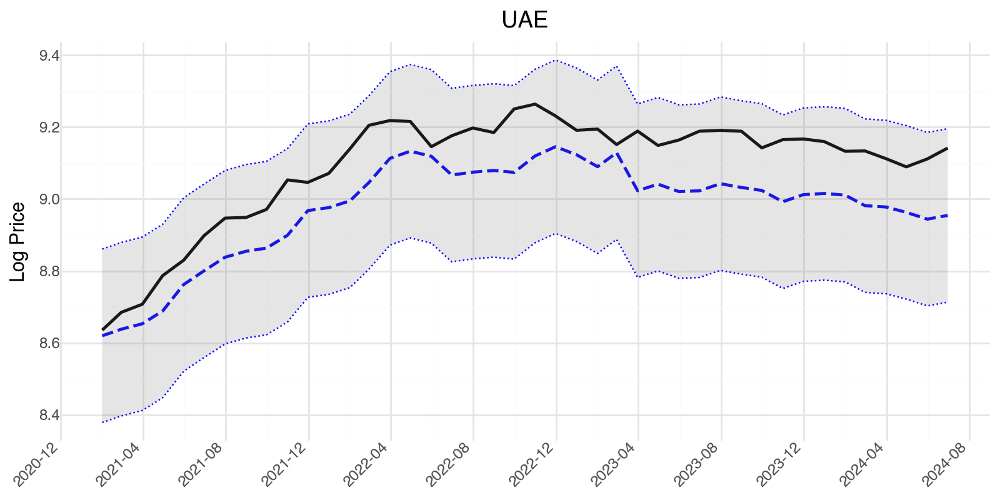

In [138]:
from plotnine import *

def calculate_confidence_intervals(y_pred, y_test, confidence=0.95):
    mse = mean_squared_error(y_test, y_pred)
    se = np.sqrt(mse)
    ci_range = se * 1.96
    lower_bound = y_pred - ci_range
    upper_bound = y_pred + ci_range
    return lower_bound, upper_bound

def plot_actual_vs_predicted_ggplot_lasso(countries_data, predictions, original_dfs):
    plots = []
    for country, test_df in countries_data.items():
        original_df = original_dfs[country]

        y_actual = original_df.loc[test_df.index, 'Price_log_t1']
        y_pred = predictions[country]['Lasso Regression']

        lower_bound, upper_bound = calculate_confidence_intervals(y_pred, y_actual)

        df_plot = pd.DataFrame({
            'Date': test_df.index,
            'Actual': y_actual,
            'Predicted': y_pred,
            'Lower': lower_bound,
            'Upper': upper_bound
        })

        p = (ggplot(df_plot, aes(x='Date')) +
             geom_line(aes(y='Actual'), color='black', size=1.0) +
             geom_line(aes(y='Predicted'), color='blue', linetype='dashed', size=1.0) +
             geom_ribbon(aes(ymin='Lower', ymax='Upper'), alpha=0.2, fill='grey') +
             geom_line(aes(y='Lower'), linetype='dotted', color='blue', size=0.5) +
             geom_line(aes(y='Upper'), linetype='dotted', color='blue', size=0.5) +
             ggtitle(f'{country}') +
             scale_x_datetime(date_labels='%Y-%m', date_breaks='4 months') +
             xlab('') + 
             ylab('Log Price') +
             theme_minimal() +
             theme(
                 axis_text_x=element_text(rotation=45, hjust=1),
                 figure_size=(8, 4),
             ))

        plots.append(p)

    return plots

plots = plot_actual_vs_predicted_ggplot_lasso(X_tests, model_predictions, countries)

for p in plots:
    print(p)

SHAP value analysis

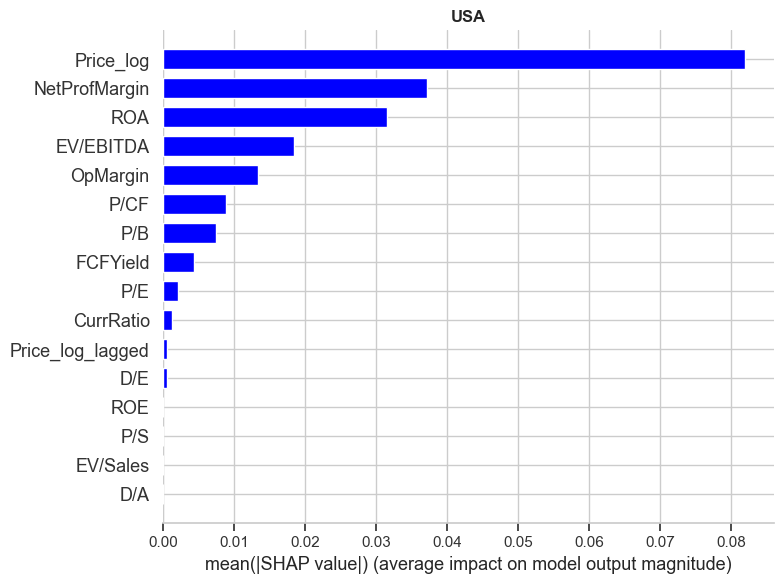

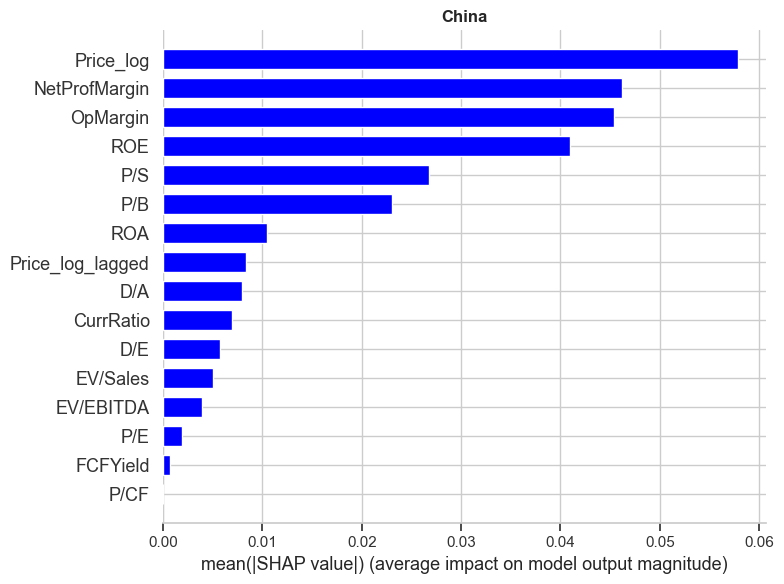

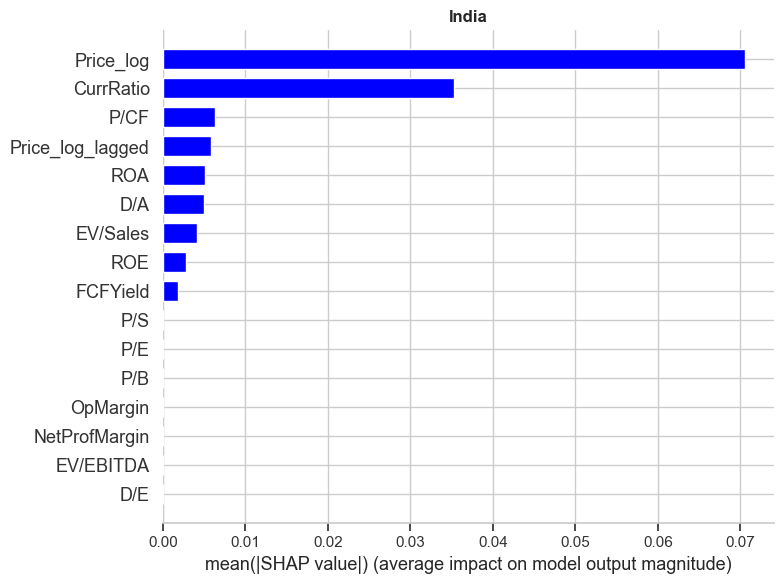

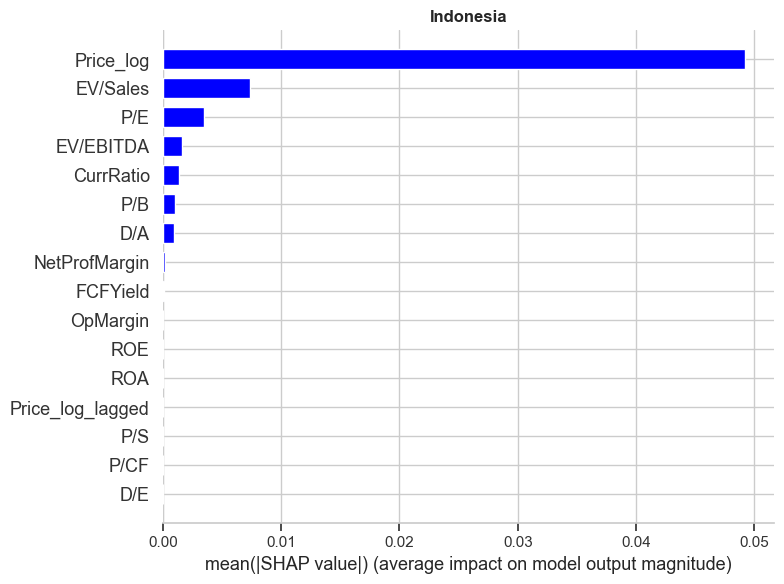

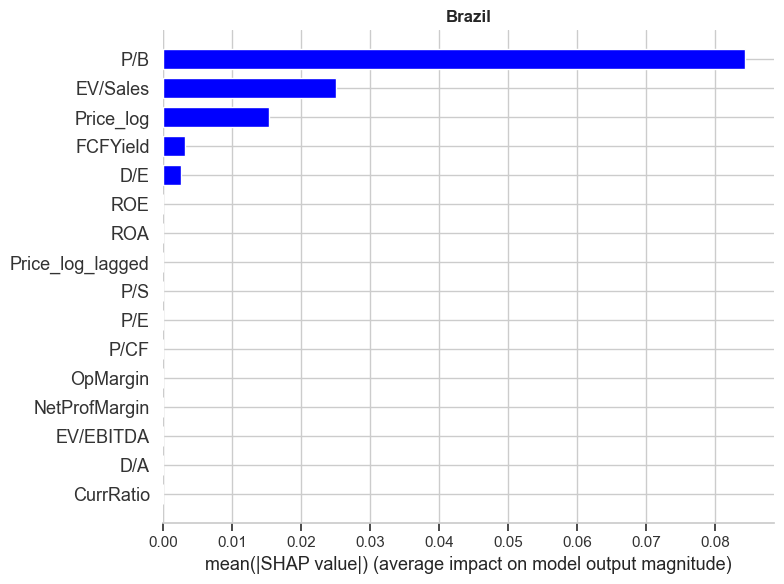

...

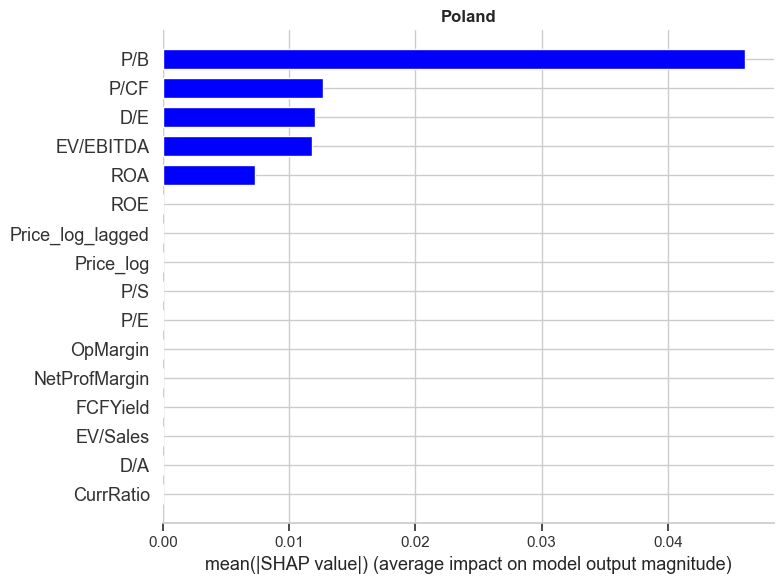

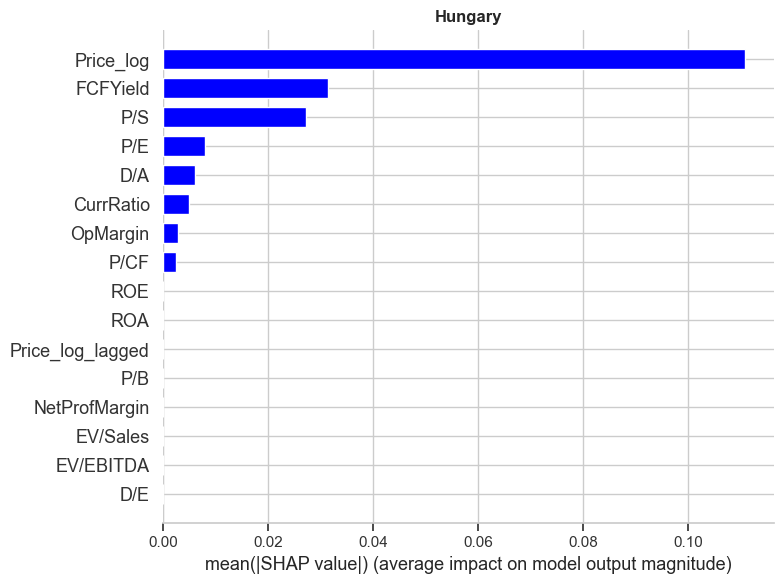

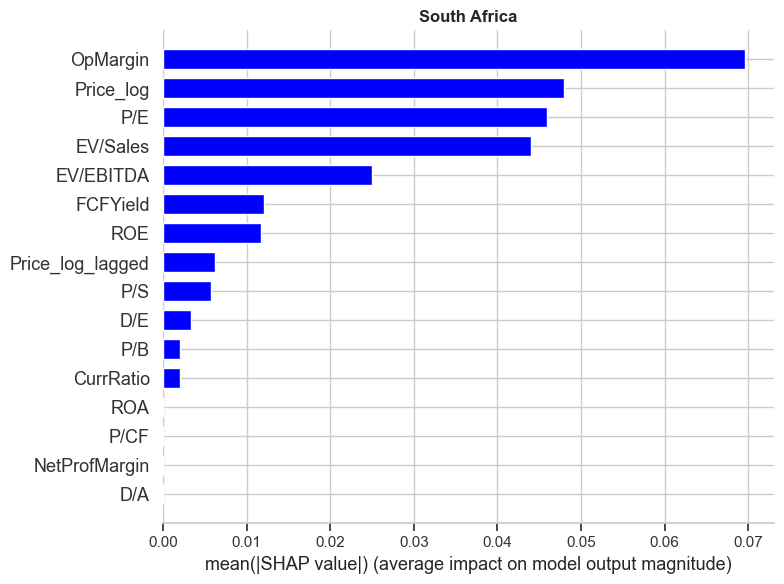

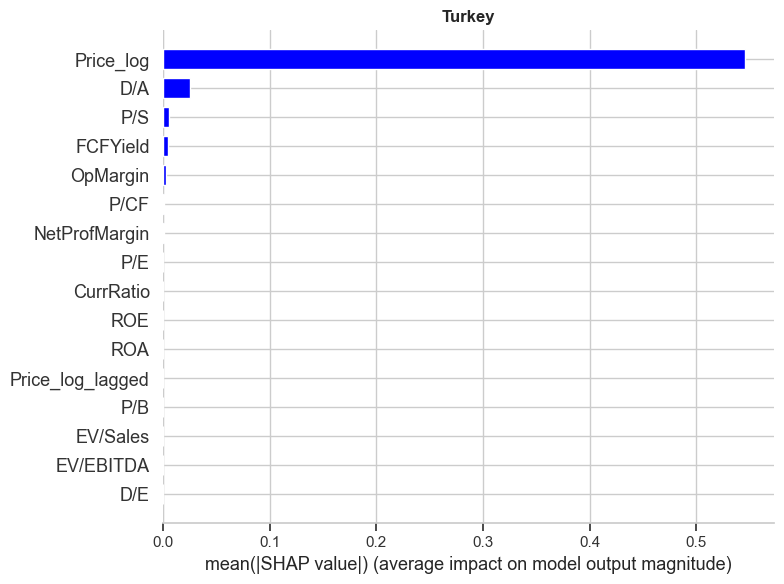

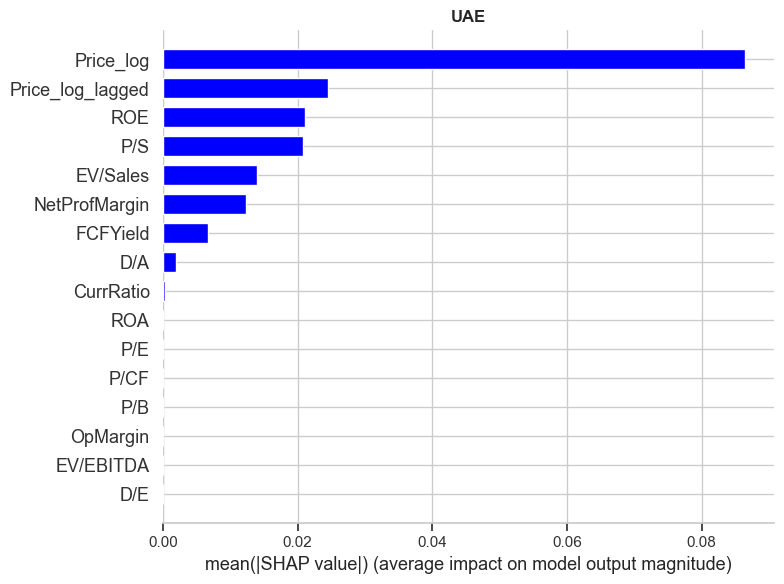

In [139]:
def plot_shap_summary_lasso(models, X_tests):

    for country in X_tests:
        model_key = f'model_lasso_{country}'
        model = models.get(model_key)
        X_test = X_tests.get(country)

        if model is not None and X_test is not None:
            best_model = model.best_estimator_

            explainer = shap.Explainer(best_model, X_test)
            shap_values = explainer(X_test)

            plt.figure()
            plt.title(f'{country}', fontweight='bold')
            shap.summary_plot(shap_values, X_test, plot_type="bar", plot_size=(8, 6), color='blue')
        else:
            print(f"Model or X_test not found for {country} using Lasso Regression.")

plot_shap_summary_lasso(models, X_tests)

#### **3. Ridge Regression**

In [140]:
model_name = 'Ridge Regression'
ridge = Ridge(max_iter=50000)
parameters = {'alpha': [1e-4, 1e-3, 1e-2, 1, 5, 10, 20]}

for country, df in countries.items():
    
    features = df.columns.difference(['Price_log_t1'])
    target_column = 'Price_log_t1'
    
    train_df = df[(df.index >= '2009-09-01') & (df.index <= '2020-12-31')]
    test_df = df[(df.index >= '2021-01-01') & (df.index <= '2024-12-31')]
    
    X_train = train_df[features]
    y_train = train_df[target_column]
    X_test = test_df[features]
    y_test = test_df[target_column]
    
    tscv = TimeSeriesSplit(n_splits=5)
    model_ridge = GridSearchCV(ridge, parameters, scoring='neg_mean_squared_error', cv=tscv)
    model_ridge.fit(X_train, y_train)
    y_pred = model_ridge.predict(X_test)

    models[f'model_ridge_{country}'] = model_ridge
    X_tests[country] = X_test
    
    update_model_evaluation(model_name, country, y_test, y_pred)
    
    residuals = y_test - y_pred
    if country not in model_residuals:
        model_residuals[country] = {}
    model_residuals[country][model_name] = residuals

display_evaluation_tables(['R2', 'MSE', 'RMSE'])

--- R2 Evaluation Table ---


,Linear Regression,Lasso Regression,Ridge Regression
USA,0.391993,0.589591,0.347337
China,-0.158996,0.022098,-0.082900
India,0.295948,-0.214268,-3.235641
Indonesia,0.612949,0.718325,0.296158
Brazil,-1.489173,-25.170222,-12.479498
Mexico,-1.215612,-1.103536,-1.452950
Argentina,0.811296,0.961424,0.932782
Russia,0.856806,0.842237,0.856484
Poland,0.527268,0.406225,0.543432
Hungary,-0.007221,-0.085244,0.080886


--- MSE Evaluation Table ---


,Linear Regression,Lasso Regression,Ridge Regression
USA,0.006201,0.004186,0.006656
China,0.005368,0.004529,0.005015
India,0.012141,0.020939,0.073041
Indonesia,0.001479,0.001076,0.002689
Brazil,0.014823,0.155839,0.080268
Mexico,0.009497,0.009017,0.010514
Argentina,0.242288,0.049530,0.086305
Russia,0.006574,0.007242,0.006588
Poland,0.009892,0.012424,0.009553
Hungary,0.031218,0.033636,0.028487


--- RMSE Evaluation Table ---


,Linear Regression,Lasso Regression,Ridge Regression
USA,0.078746,0.064696,0.081586
China,0.073265,0.067299,0.070819
India,0.110186,0.144704,0.270261
Indonesia,0.038452,0.032803,0.051853
Brazil,0.121748,0.394764,0.283316
Mexico,0.097452,0.094955,0.102539
Argentina,0.492227,0.222553,0.293777
Russia,0.081078,0.085102,0.081169
Poland,0.099456,0.111464,0.097741
Hungary,0.176685,0.183401,0.168781


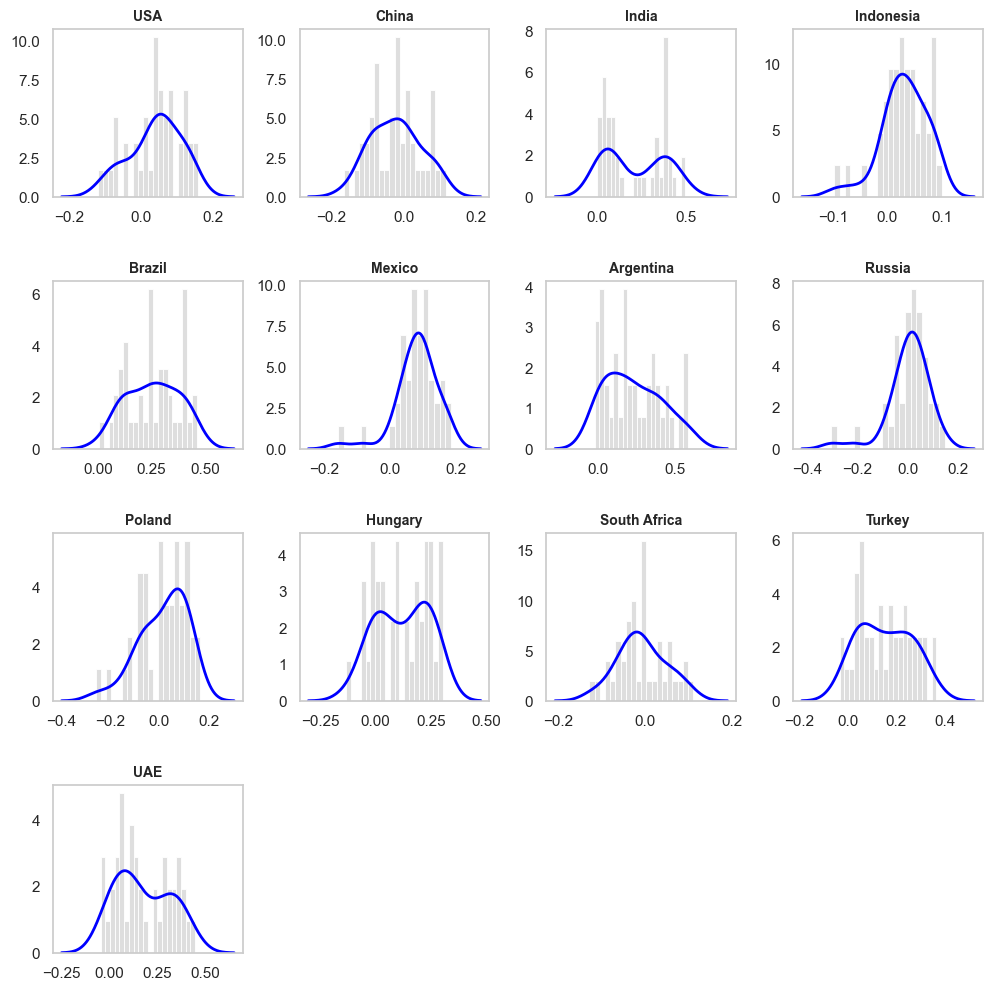

In [141]:
plt.close('all')
sns.set(style="whitegrid")

n_countries = len(countries)
n_cols = 4
n_rows = (n_countries // n_cols) + (n_countries % n_cols > 0)

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(12, 3 * n_rows))
fig.subplots_adjust(hspace=0.5, wspace=0.3)

axes = axes.flatten()

for i, (country, residual_dict) in enumerate(model_residuals.items()):
    ax = axes[i]
    if 'Ridge Regression' in residual_dict:
        residuals = residual_dict['Ridge Regression']

        sns.histplot(residuals, bins=20, kde=False, color="lightgrey", ax=ax, stat="density")
        sns.kdeplot(residuals, color="blue", ax=ax, lw=2)

        ax.set_title(f'{country}', fontsize=10, fontweight='bold')
        ax.set_xlabel(None)
        ax.set_ylabel(None)
        ax.grid(False)

for j in range(i + 1, len(axes)):
    axes[j].set_visible(False)

plt.show()

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1758713325.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


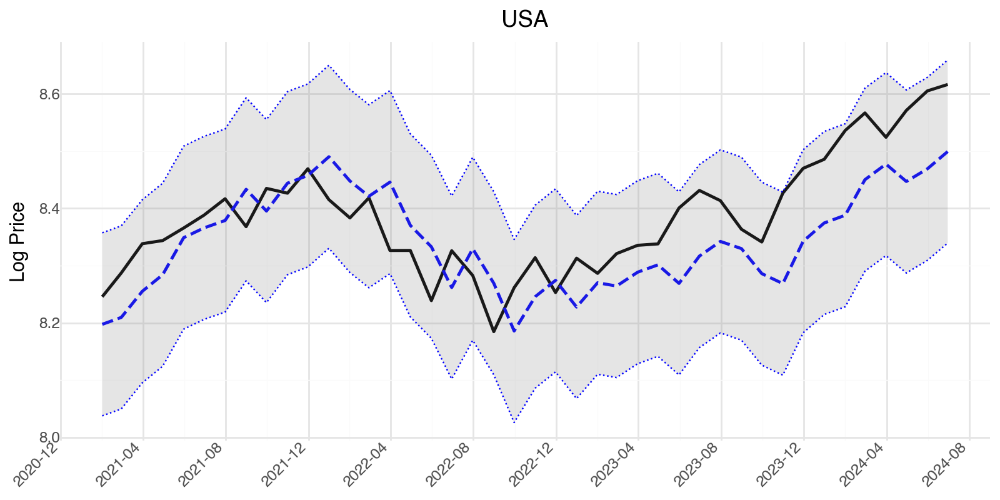

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1758713325.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


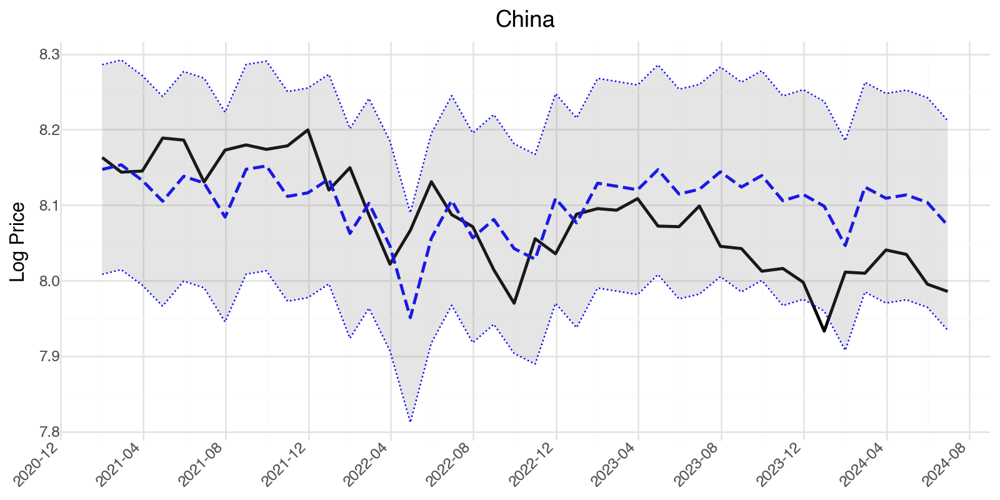

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1758713325.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


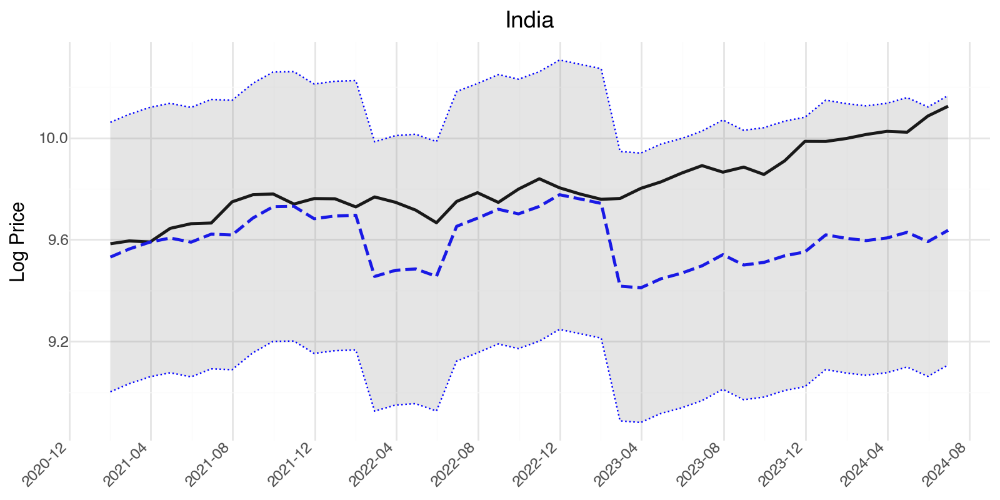

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1758713325.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


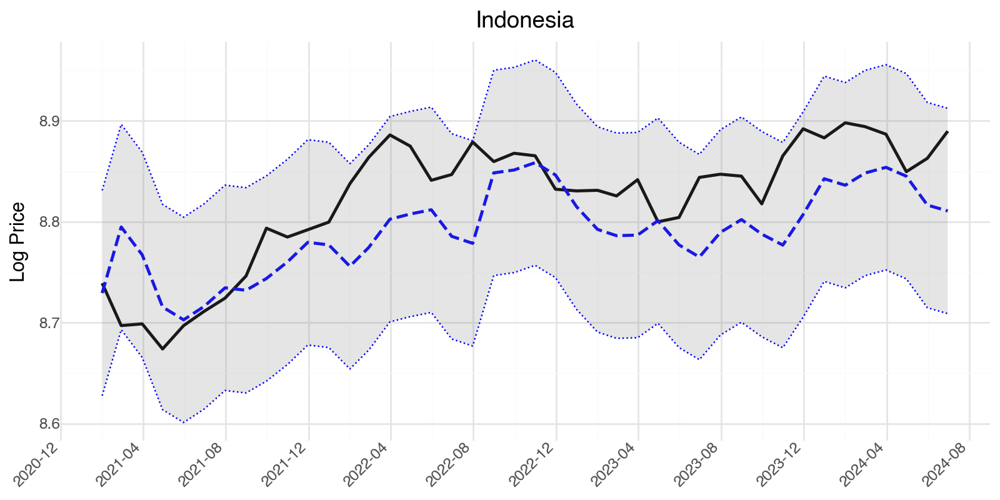

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1758713325.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


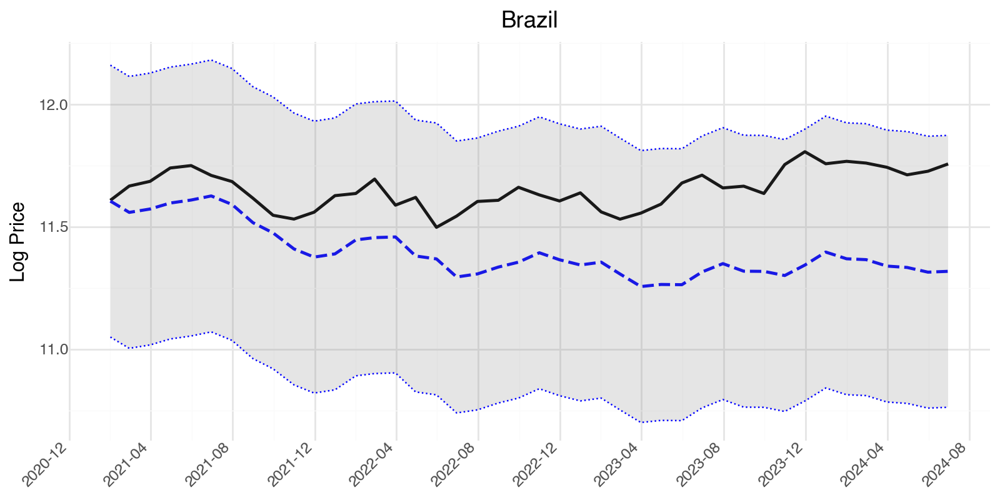

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1758713325.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


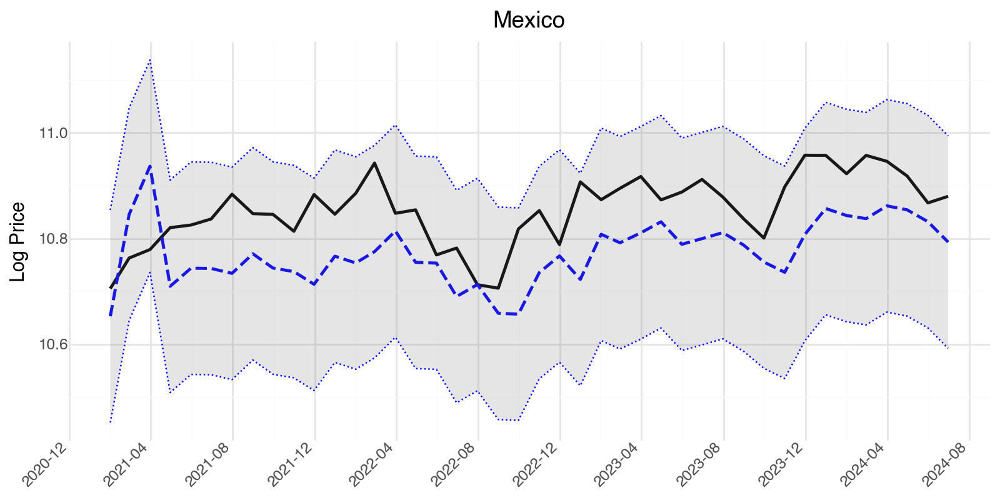

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1758713325.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


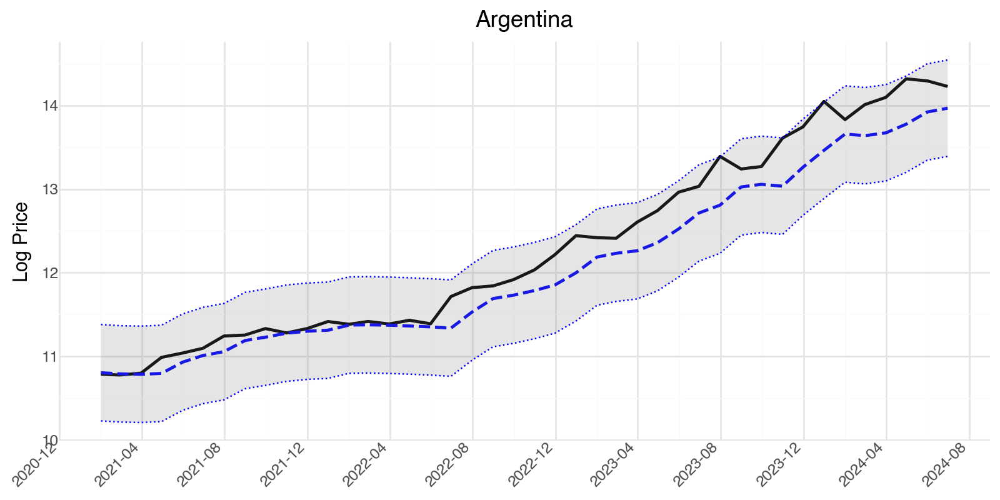

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1758713325.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


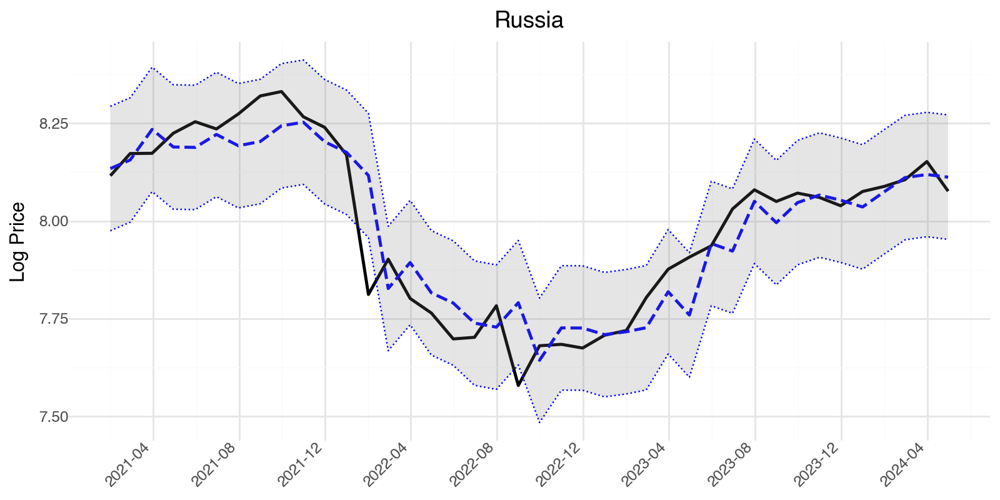

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1758713325.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


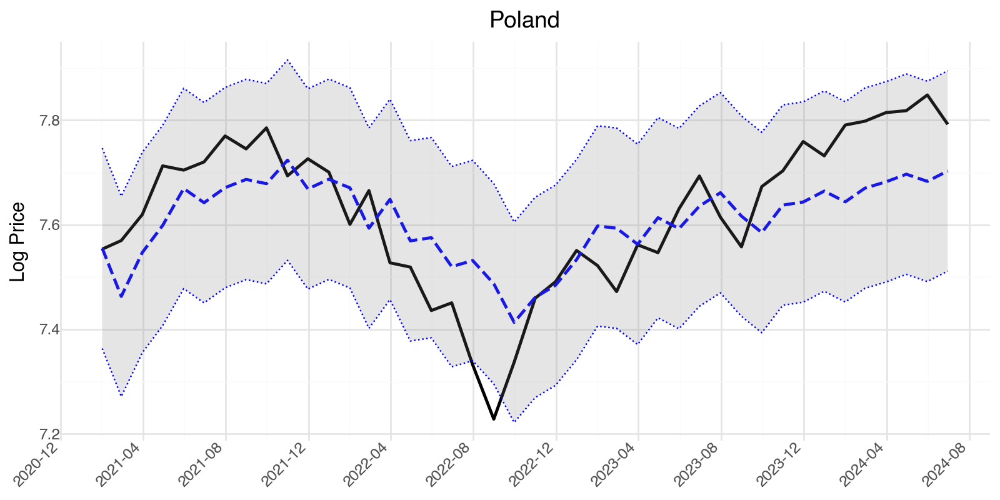

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1758713325.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


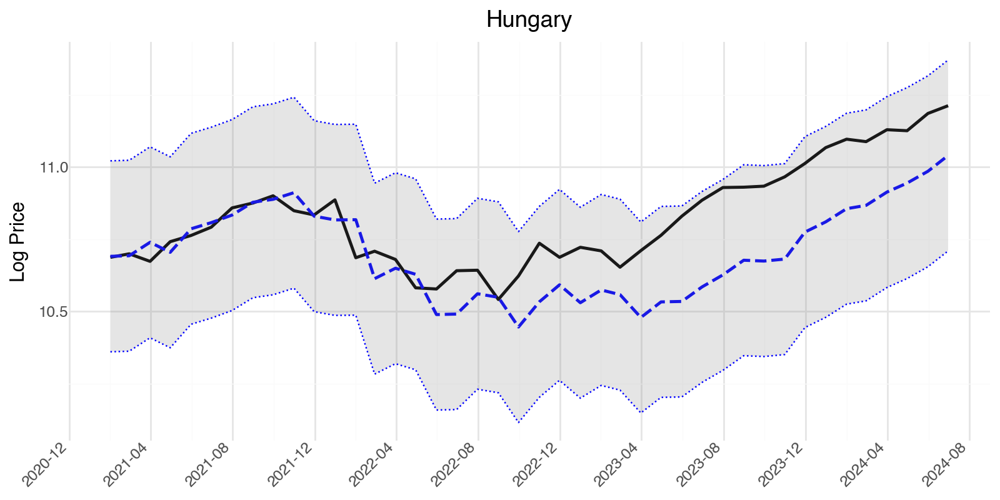

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1758713325.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


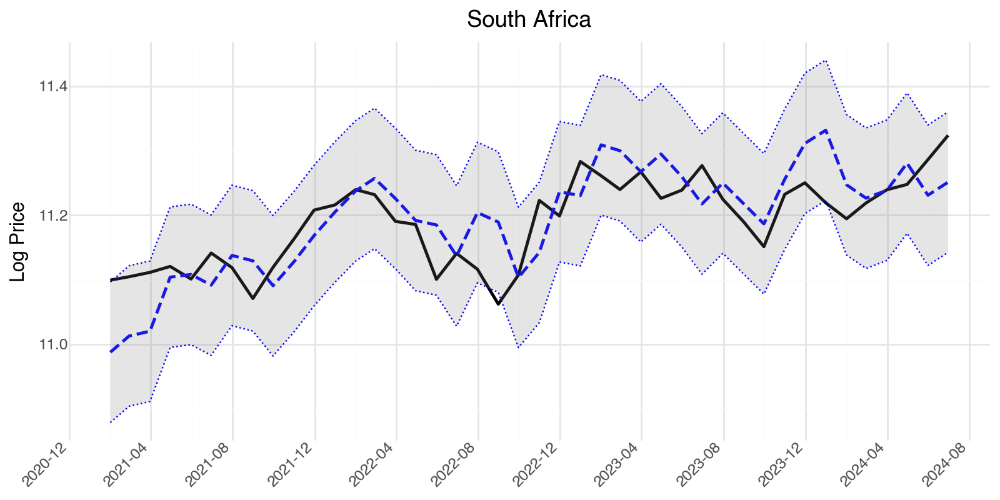

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1758713325.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


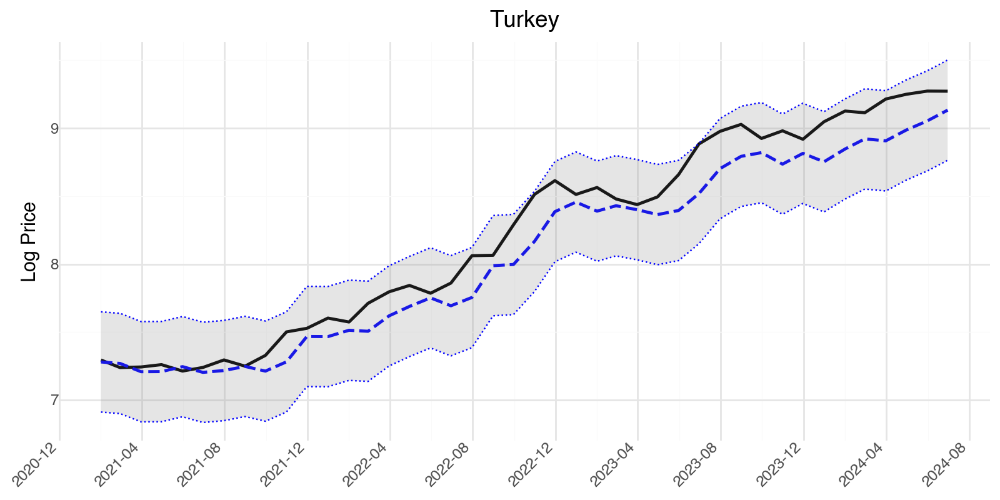

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1758713325.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


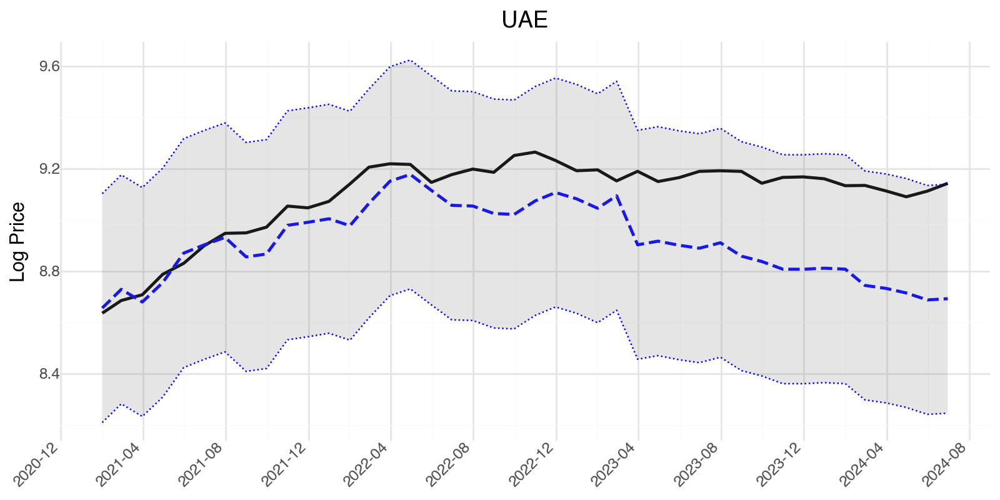

In [142]:
def plot_actual_vs_predicted_ggplot_ridge(countries_data, predictions, original_dfs):
    plots = []
    for country, test_df in countries_data.items():
        original_df = original_dfs[country]

        y_actual = original_df.loc[test_df.index, 'Price_log_t1']
        y_pred = predictions[country]['Ridge Regression']

        lower_bound, upper_bound = calculate_confidence_intervals(y_pred, y_actual)

        df_plot = pd.DataFrame({
            'Date': test_df.index,
            'Actual': y_actual,
            'Predicted': y_pred,
            'Lower': lower_bound,
            'Upper': upper_bound
        })

        p = (ggplot(df_plot, aes(x='Date')) +
             geom_line(aes(y='Actual'), color='black', size=1.0) +
             geom_line(aes(y='Predicted'), color='blue', linetype='dashed', size=1.0) +
             geom_ribbon(aes(ymin='Lower', ymax='Upper'), alpha=0.2, fill='grey') +
             geom_line(aes(y='Lower'), linetype='dotted', color='blue', size=0.5) +
             geom_line(aes(y='Upper'), linetype='dotted', color='blue', size=0.5) +
             ggtitle(f'{country}') +
             scale_x_datetime(date_labels='%Y-%m', date_breaks='4 months') +
             xlab('') + 
             ylab('Log Price') +
             theme_minimal() +
             theme(
                 axis_text_x=element_text(rotation=45, hjust=1),
                 figure_size=(8, 4),
             ))

        plots.append(p)

    return plots

plots = plot_actual_vs_predicted_ggplot_ridge(X_tests, model_predictions, countries)
for p in plots:
    print(p)

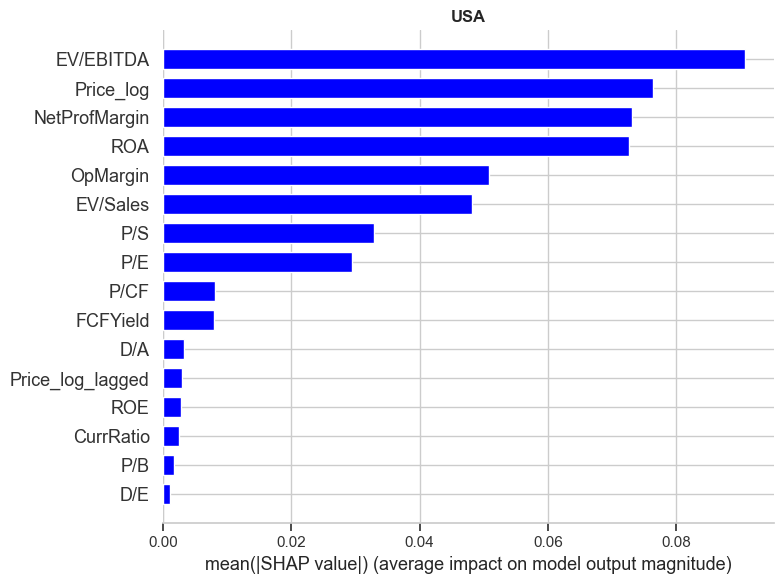

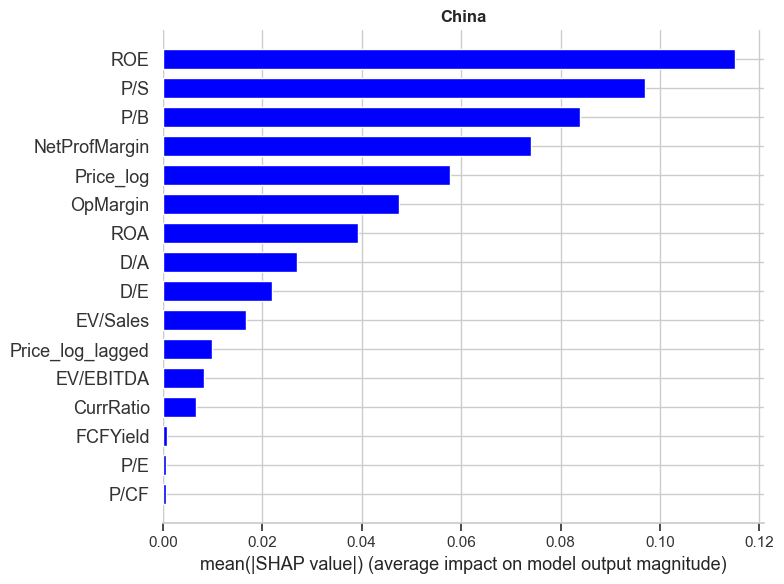

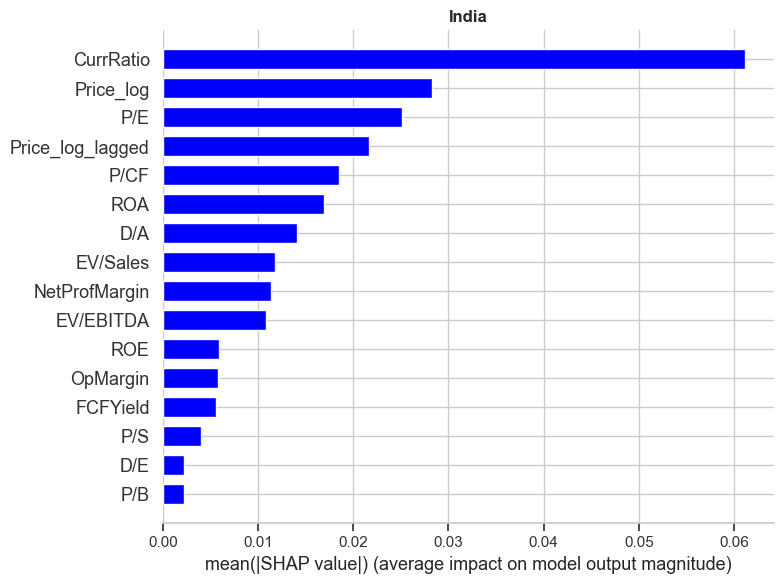

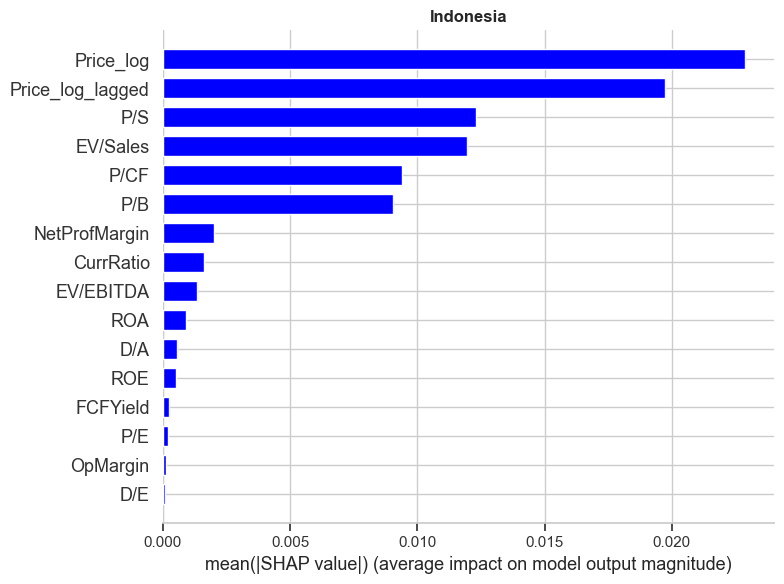

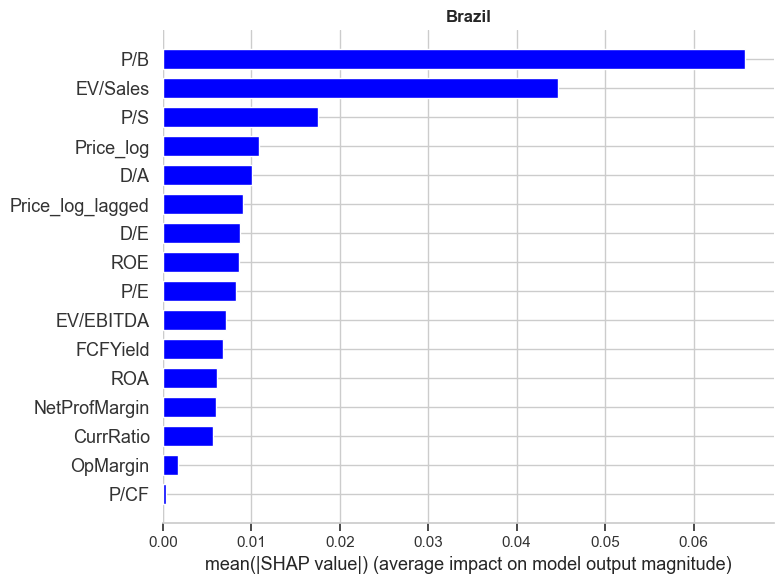

...

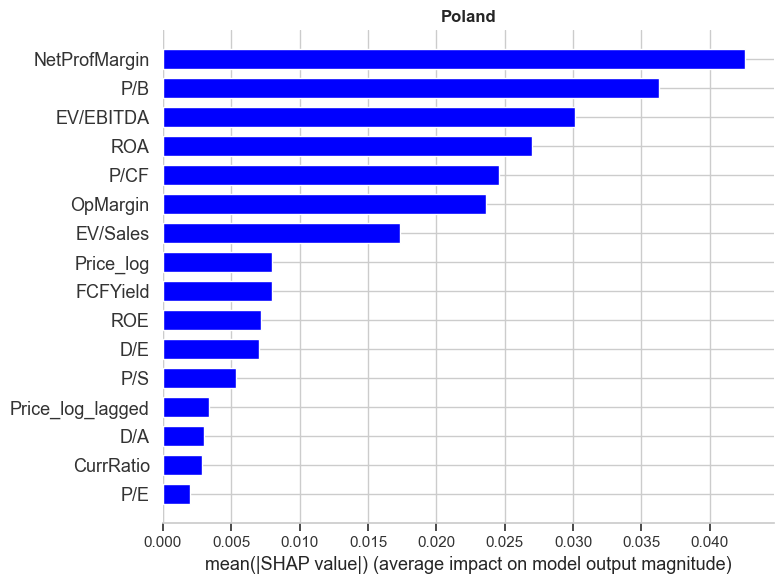

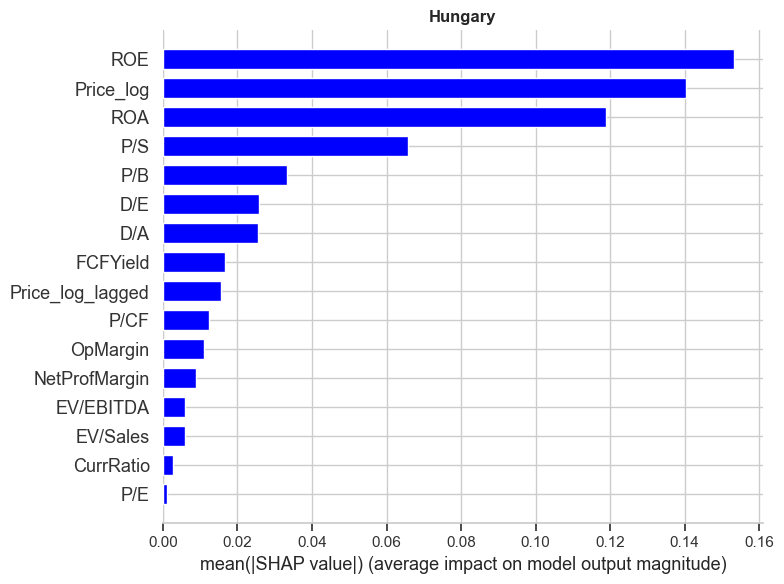

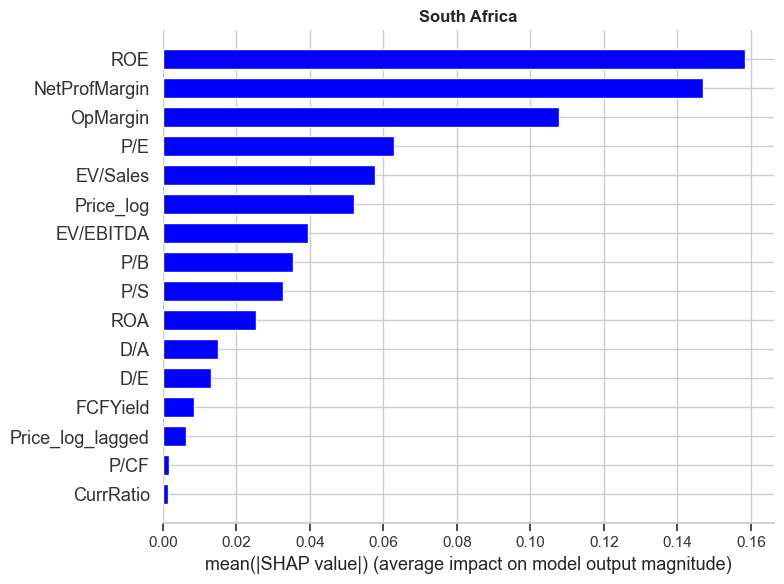

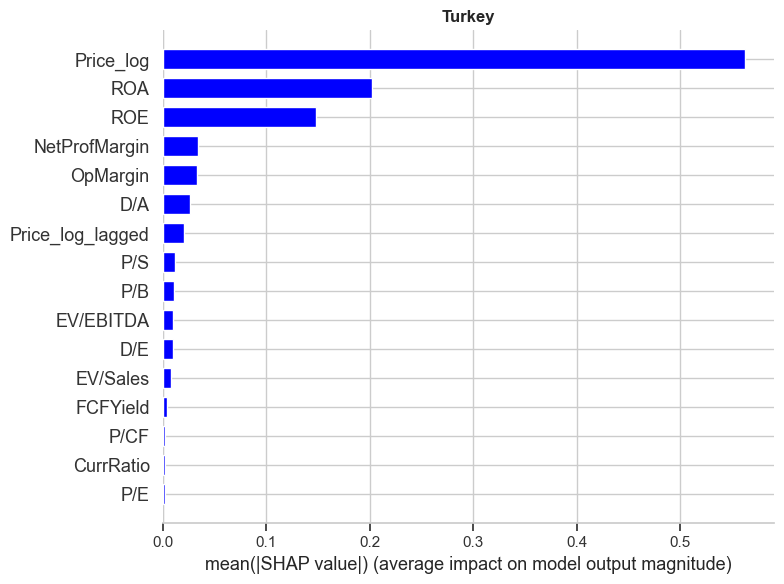

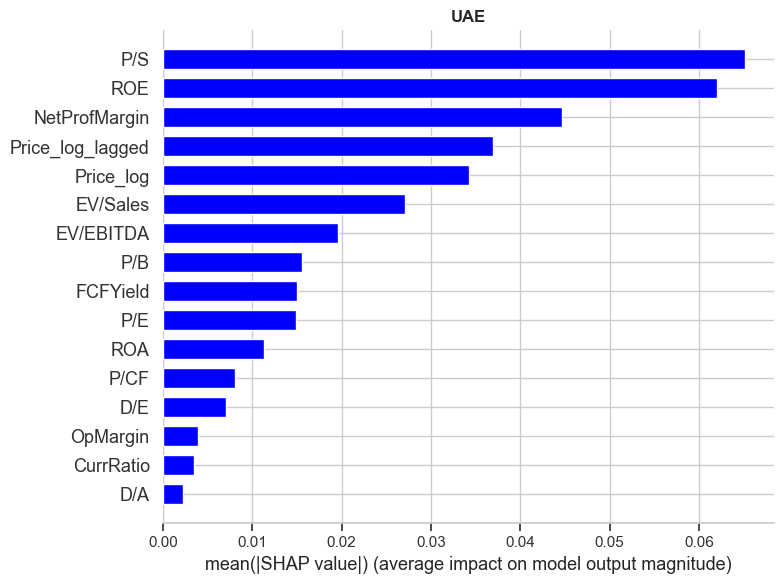

In [143]:
def plot_shap_summary_ridge(models, X_tests):

    for country in X_tests:
        model_key = f'model_ridge_{country}'
        model = models.get(model_key)
        X_test = X_tests.get(country)

        if model is not None and X_test is not None:

            best_model = model.best_estimator_

            explainer = shap.Explainer(best_model, X_test)
            shap_values = explainer(X_test)

            plt.figure()
            plt.title(f'{country}', fontweight='bold')
            shap.summary_plot(shap_values, X_test, plot_type="bar", plot_size=(8, 6), color='blue')
        else:
            print(f"Model or X_test not found for {country} using Ridge Regression.")

plot_shap_summary_ridge(models, X_tests)

#### **4. Elastic Net**

In [144]:
model_name = 'Elastic Net'
elastic_net = ElasticNet(max_iter=250000, tol=1e-5)
parameters = {'alpha': [1e-4, 1e-3, 1e-2, 1, 5, 7.5, 10, 15, 20, 22.5, 25],
              'l1_ratio': [0.1, 0.25, 0.5, 0.75, 0.9, 0.95]}

for country, df in countries.items():
        
    features = df.columns.difference(['Price_log_t1'])
    target_column = 'Price_log_t1'
    
    train_df = df[(df.index >= '2009-09-01') & (df.index <= '2020-12-31')]
    test_df = df[(df.index >= '2021-01-01') & (df.index <= '2024-12-31')]
    
    X_train = train_df[features]
    y_train = train_df[target_column]
    X_test = test_df[features]
    y_test = test_df[target_column]
    
    tscv = TimeSeriesSplit(n_splits=5)
    model_en = GridSearchCV(elastic_net, parameters, scoring='neg_mean_squared_error', cv=tscv)
    model_en.fit(X_train, y_train)
    y_pred = model_en.predict(X_test)

    models[f'model_en_{country}'] = model_en
    X_tests[country] = X_test
    
    update_model_evaluation(model_name, country, y_test, y_pred)
    
    residuals = y_test - y_pred
    if country not in model_residuals:
        model_residuals[country] = {}
    model_residuals[country][model_name] = residuals

display_evaluation_tables(['R2', 'MSE', 'RMSE'])

--- R2 Evaluation Table ---


,Linear Regression,Lasso Regression,Ridge Regression,Elastic Net
USA,0.391993,0.589591,0.347337,0.588683
China,-0.158996,0.022098,-0.082900,0.021688
India,0.295948,-0.214268,-3.235641,-0.163115
Indonesia,0.612949,0.718325,0.296158,0.720917
Brazil,-1.489173,-25.170222,-12.479498,-11.535942
Mexico,-1.215612,-1.103536,-1.452950,-1.508953
Argentina,0.811296,0.961424,0.932782,0.936916
Russia,0.856806,0.842237,0.856484,0.847849
Poland,0.527268,0.406225,0.543432,0.399354
Hungary,-0.007221,-0.085244,0.080886,-0.123347


--- MSE Evaluation Table ---


,Linear Regression,Lasso Regression,Ridge Regression,Elastic Net
USA,0.006201,0.004186,0.006656,0.004195
China,0.005368,0.004529,0.005015,0.004531
India,0.012141,0.020939,0.073041,0.020057
Indonesia,0.001479,0.001076,0.002689,0.001066
Brazil,0.014823,0.155839,0.080268,0.074649
Mexico,0.009497,0.009017,0.010514,0.010754
Argentina,0.242288,0.049530,0.086305,0.080997
Russia,0.006574,0.007242,0.006588,0.006985
Poland,0.009892,0.012424,0.009553,0.012568
Hungary,0.031218,0.033636,0.028487,0.034817


--- RMSE Evaluation Table ---


,Linear Regression,Lasso Regression,Ridge Regression,Elastic Net
USA,0.078746,0.064696,0.081586,0.064768
China,0.073265,0.067299,0.070819,0.067313
India,0.110186,0.144704,0.270261,0.141624
Indonesia,0.038452,0.032803,0.051853,0.032651
Brazil,0.121748,0.394764,0.283316,0.273220
Mexico,0.097452,0.094955,0.102539,0.103703
Argentina,0.492227,0.222553,0.293777,0.284599
Russia,0.081078,0.085102,0.081169,0.083575
Poland,0.099456,0.111464,0.097741,0.112107
Hungary,0.176685,0.183401,0.168781,0.186593


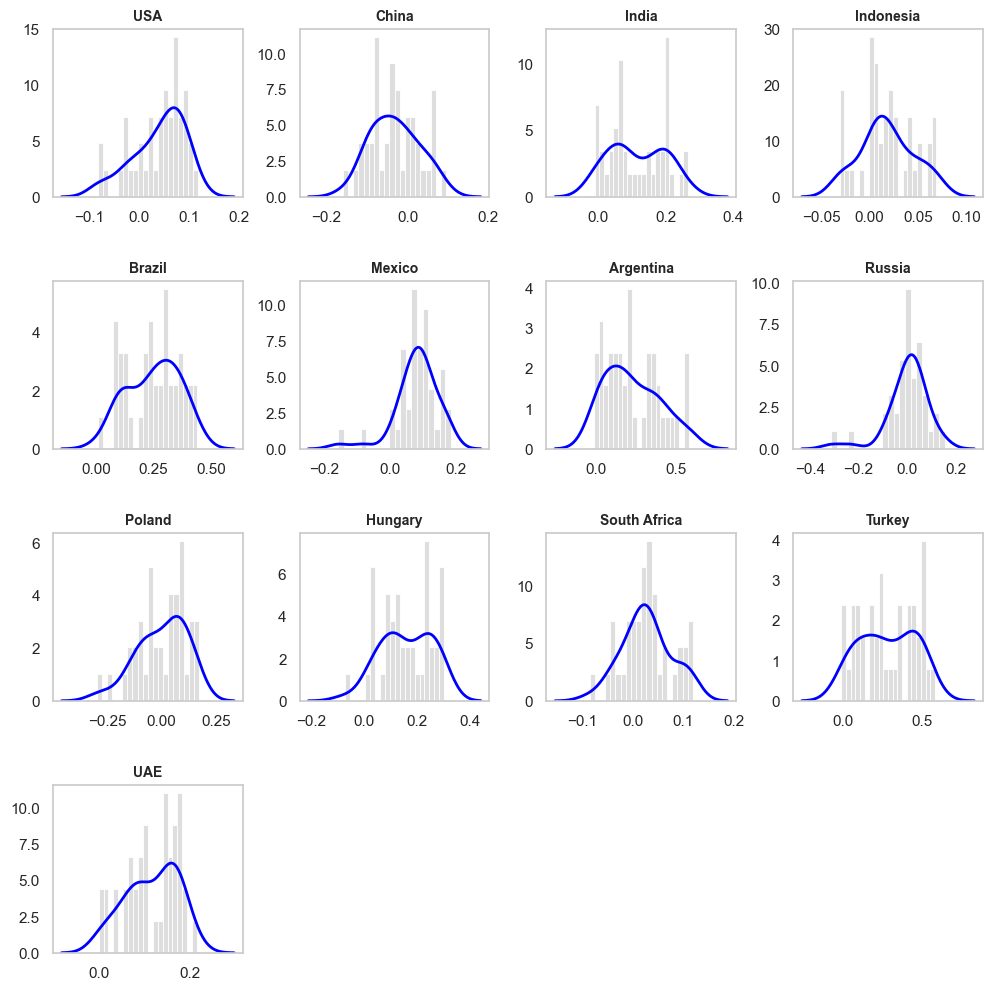

In [145]:
plt.close('all')
sns.set(style="whitegrid")

n_countries = len(countries)
n_cols = 4
n_rows = (n_countries // n_cols) + (n_countries % n_cols > 0)

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(12, 3 * n_rows))
fig.subplots_adjust(hspace=0.5, wspace=0.3)

axes = axes.flatten()

for i, (country, residual_dict) in enumerate(model_residuals.items()):
    ax = axes[i]
    if 'Elastic Net' in residual_dict:
        residuals = residual_dict['Elastic Net']

        sns.histplot(residuals, bins=20, kde=False, color="lightgrey", ax=ax, stat="density")
        sns.kdeplot(residuals, color="blue", ax=ax, lw=2)

        ax.set_title(f'{country}', fontsize=10, fontweight='bold')
        ax.set_xlabel(None)
        ax.set_ylabel(None)
        ax.grid(False)

for j in range(i + 1, len(axes)):
    axes[j].set_visible(False)

plt.show()

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1607902849.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


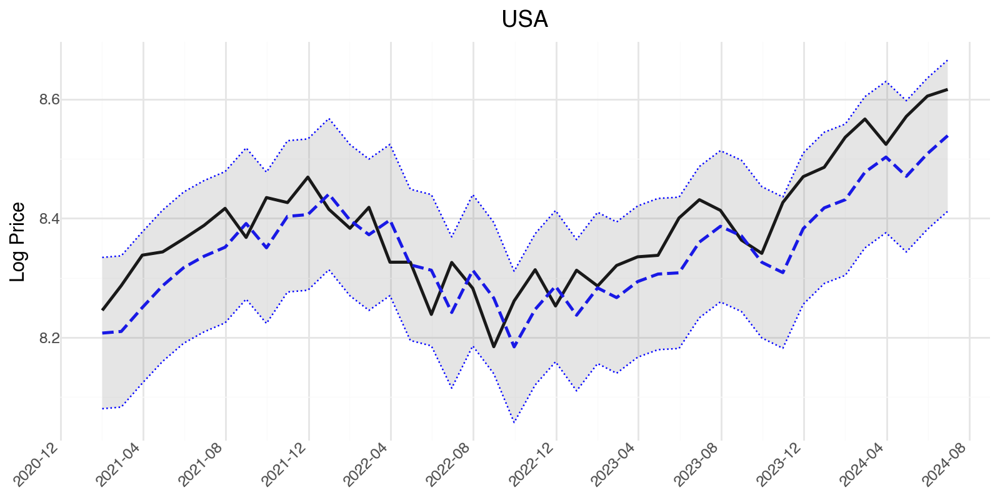

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1607902849.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


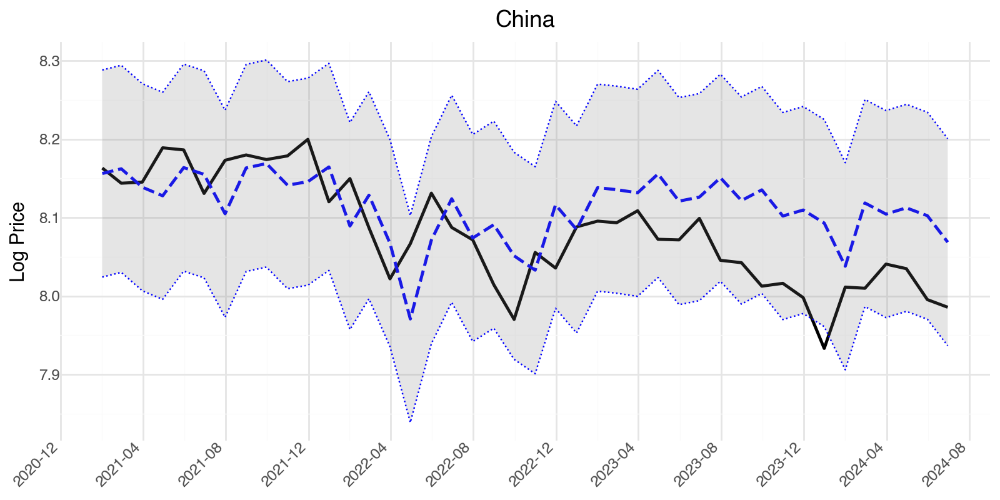

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1607902849.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


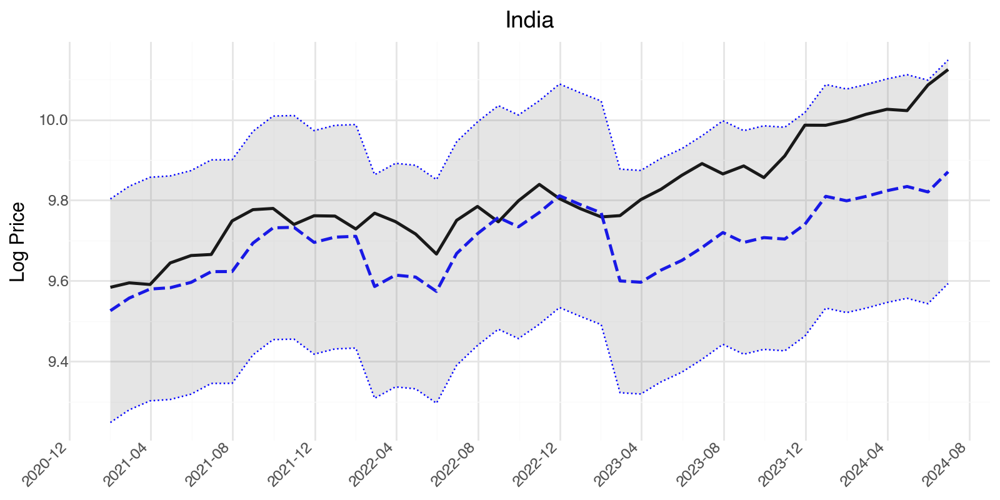

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1607902849.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


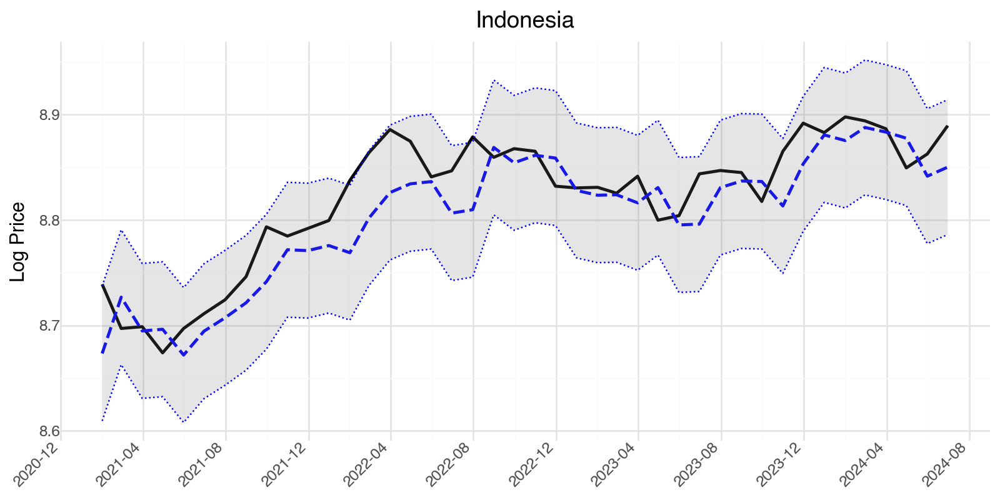

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1607902849.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


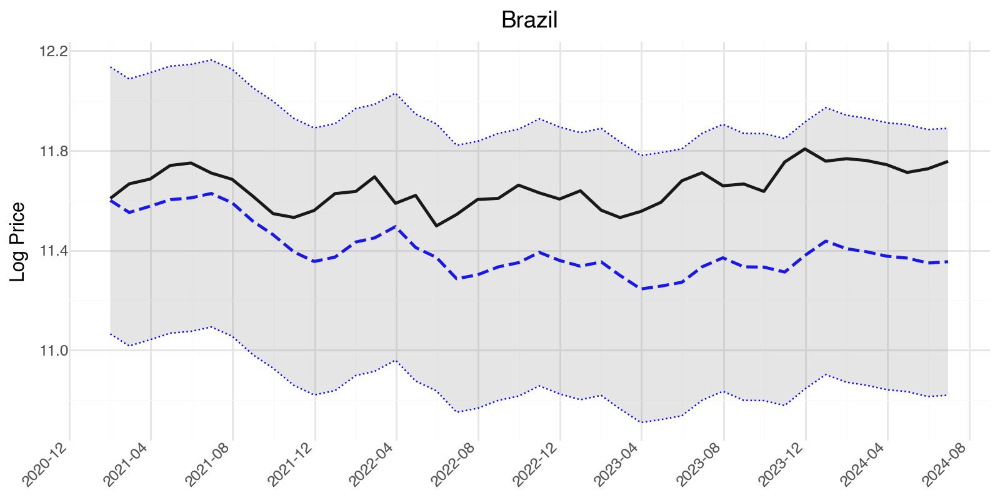

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1607902849.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


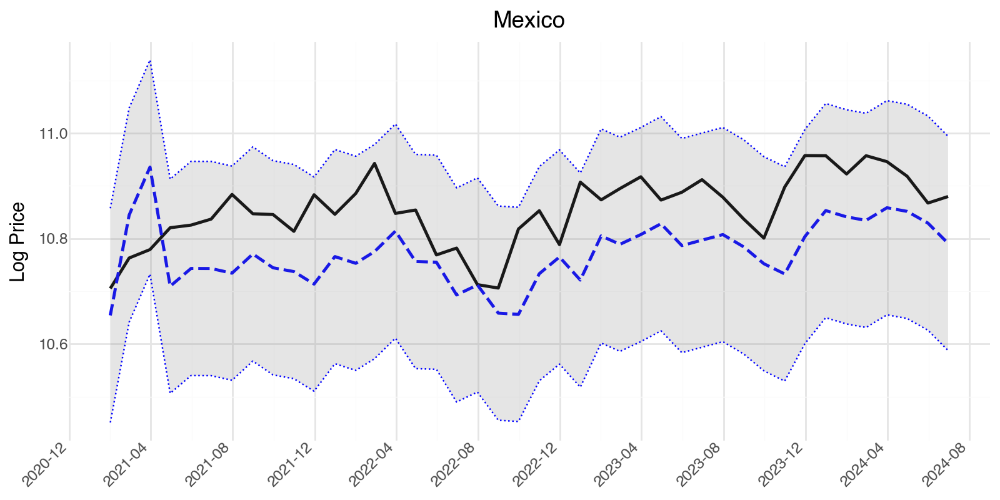

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1607902849.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


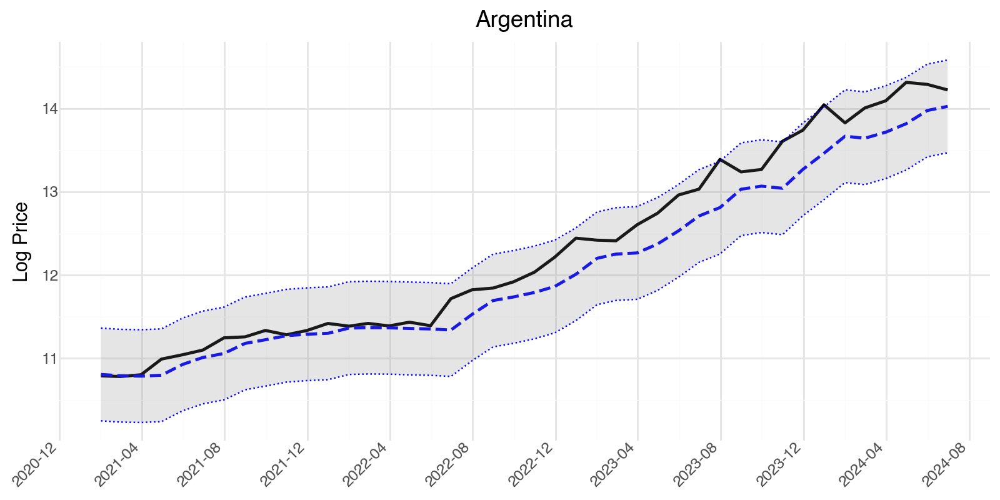

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1607902849.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


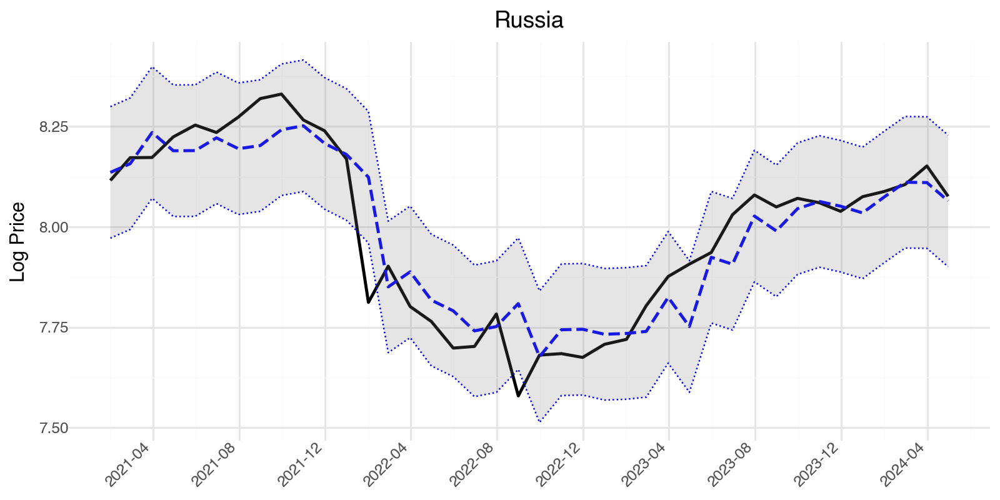

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1607902849.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


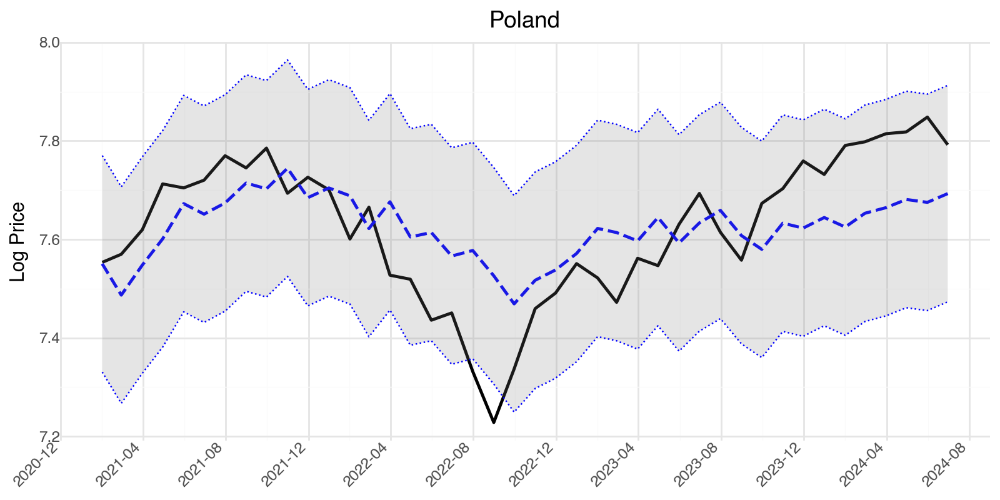

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1607902849.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


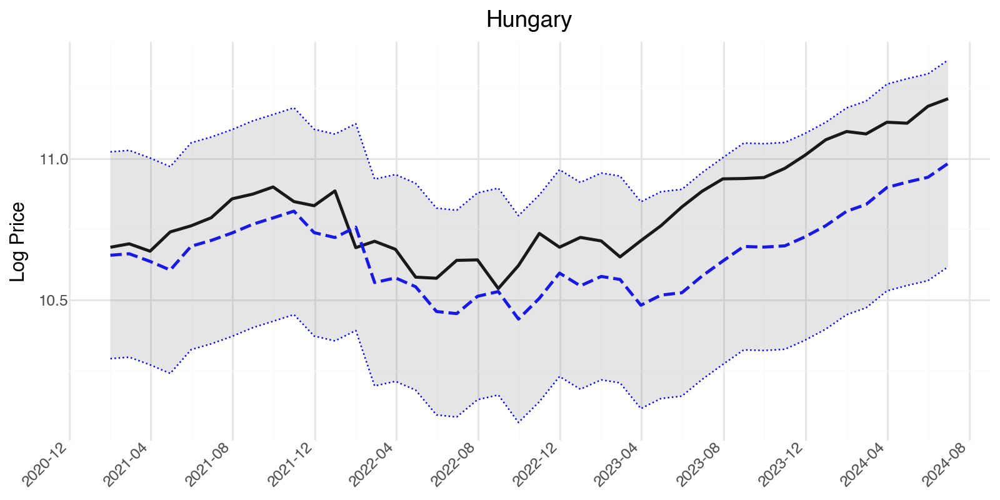

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1607902849.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


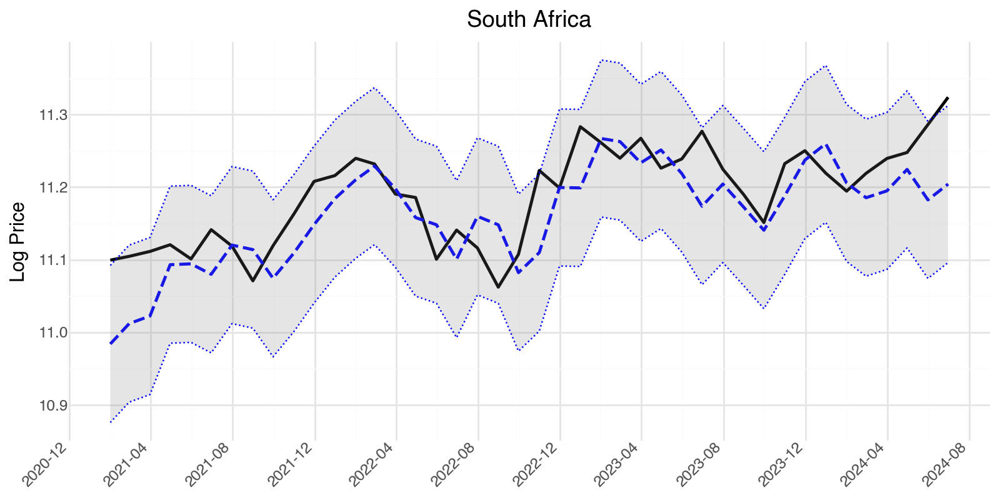

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1607902849.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


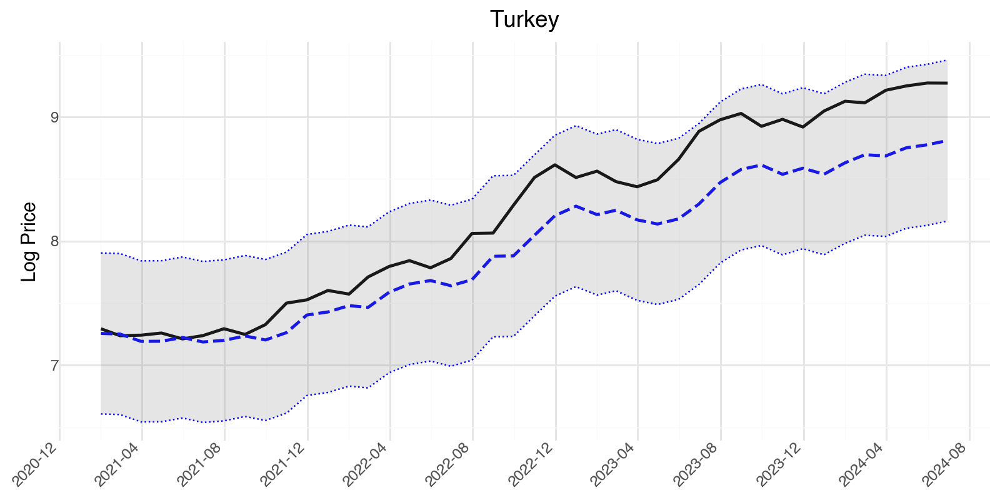

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/1607902849.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


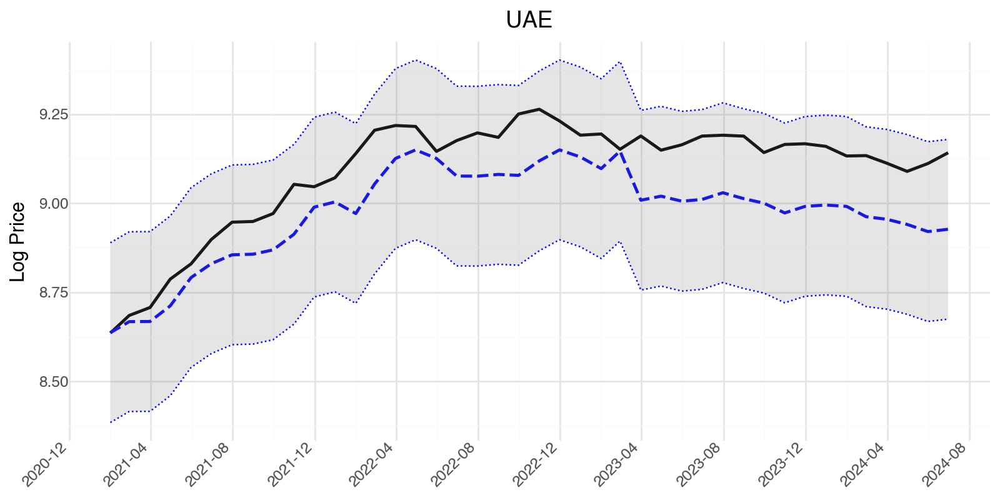

In [146]:
def plot_actual_vs_predicted_ggplot_elasticnet(countries_data, predictions, original_dfs):
    plots = []
    for country, test_df in countries_data.items():
        original_df = original_dfs[country]

        y_actual = original_df.loc[test_df.index, 'Price_log_t1']
        y_pred = predictions[country]['Elastic Net']

        lower_bound, upper_bound = calculate_confidence_intervals(y_pred, y_actual)

        df_plot = pd.DataFrame({
            'Date': test_df.index,
            'Actual': y_actual,
            'Predicted': y_pred,
            'Lower': lower_bound,
            'Upper': upper_bound
        })

        p = (ggplot(df_plot, aes(x='Date')) +
             geom_line(aes(y='Actual'), color='black', size=1.0) +
             geom_line(aes(y='Predicted'), color='blue', linetype='dashed', size=1.0) +
             geom_ribbon(aes(ymin='Lower', ymax='Upper'), alpha=0.2, fill='grey') +
             geom_line(aes(y='Lower'), linetype='dotted', color='blue', size=0.5) +
             geom_line(aes(y='Upper'), linetype='dotted', color='blue', size=0.5) +
             ggtitle(f'{country}') +
             scale_x_datetime(date_labels='%Y-%m', date_breaks='4 months') +
             xlab('') + 
             ylab('Log Price') +
             theme_minimal() +
             theme(
                 axis_text_x=element_text(rotation=45, hjust=1),
                 figure_size=(8, 4),
             ))

        plots.append(p)

    return plots

plots = plot_actual_vs_predicted_ggplot_elasticnet(X_tests, model_predictions, countries)
for p in plots:
    print(p)

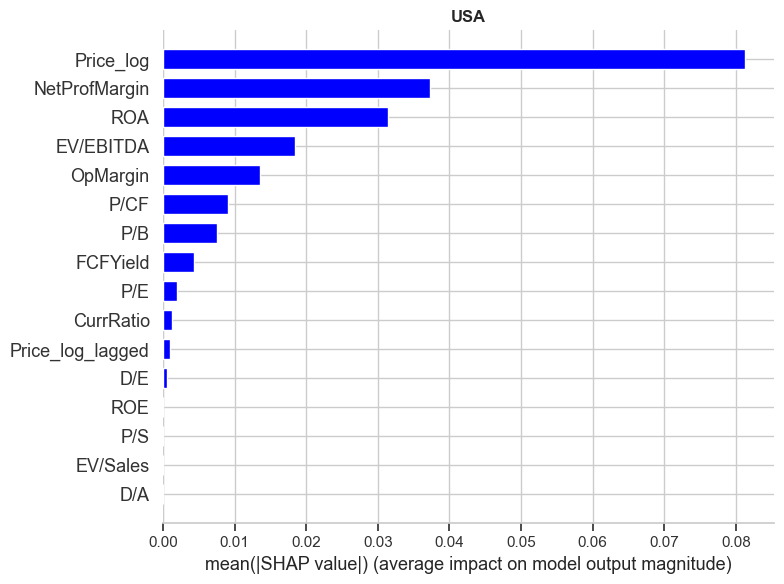

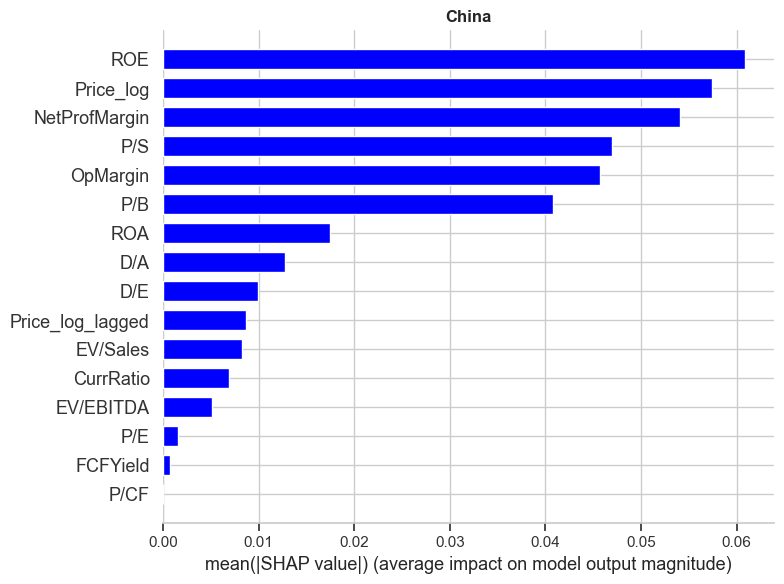

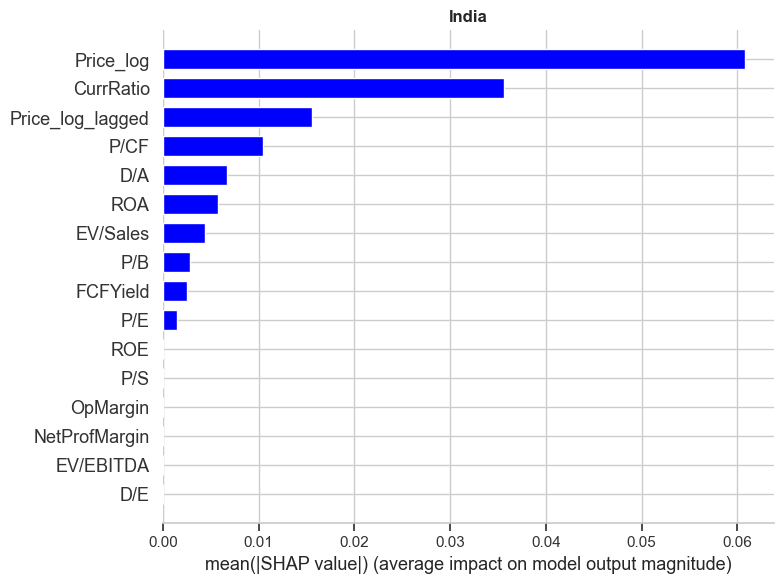

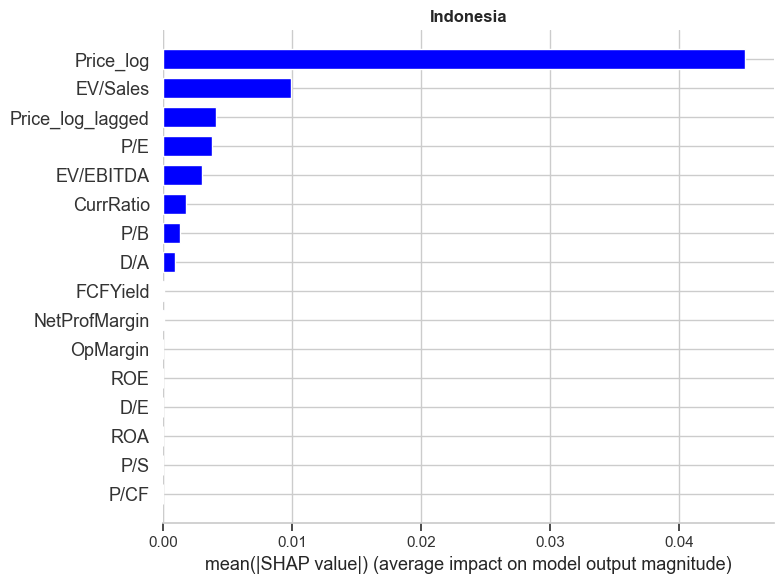

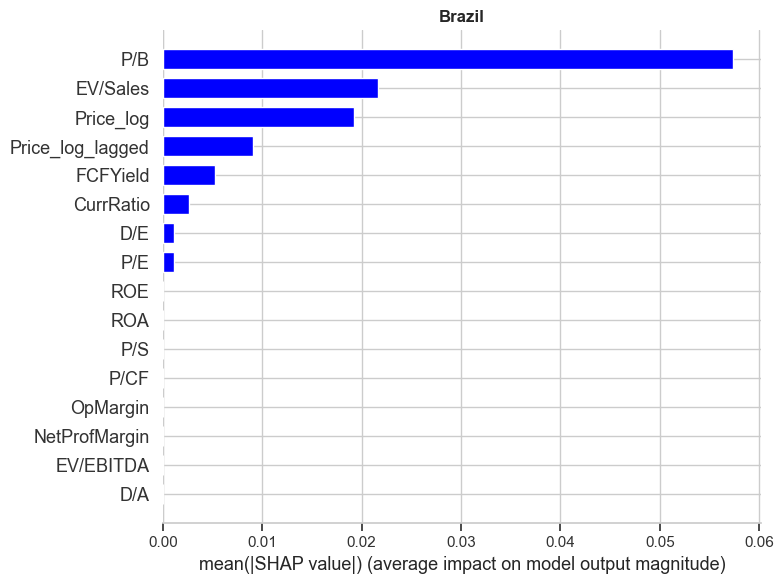

...

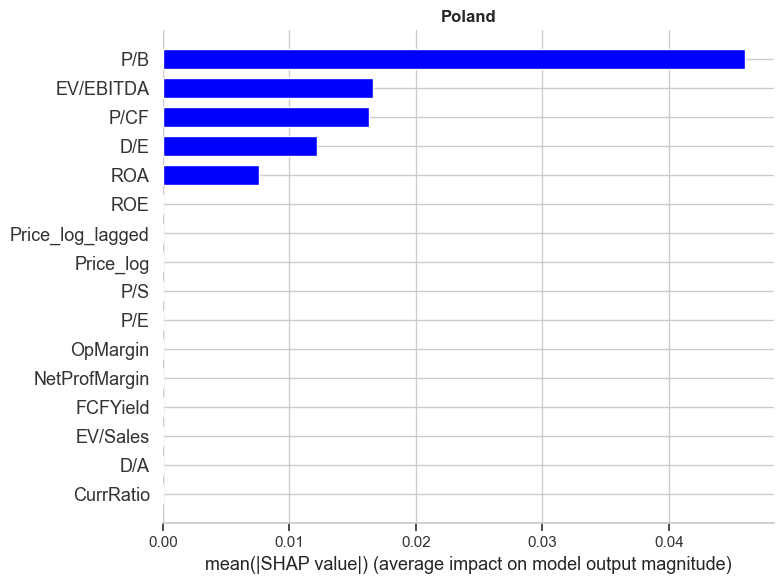

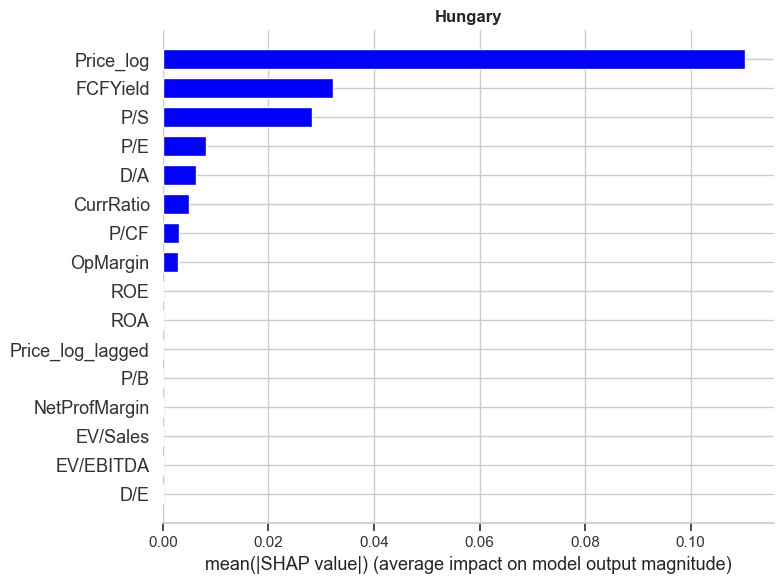

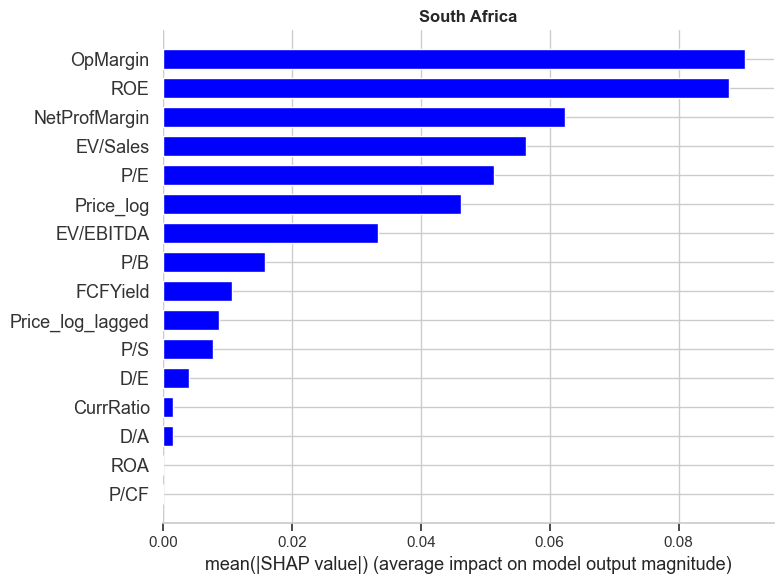

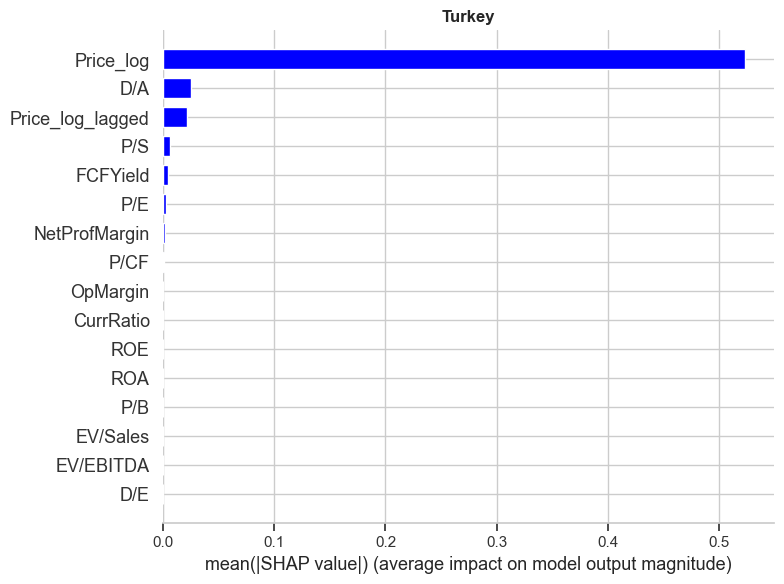

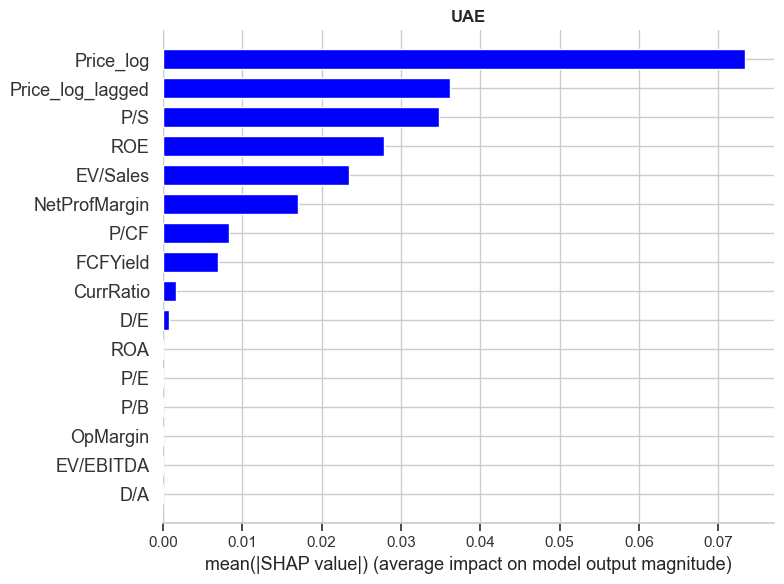

In [147]:
def plot_shap_summary_elastic_net(models, X_tests):

    for country in X_tests:
        model_key = f'model_en_{country}'
        model = models.get(model_key)
        X_test = X_tests.get(country)

        if model is not None and X_test is not None:
    
            best_model = model.best_estimator_
    
            explainer = shap.Explainer(best_model, X_test)
            shap_values = explainer(X_test)

            plt.figure()
            plt.title(f'{country}', fontweight='bold')
            shap.summary_plot(shap_values, X_test, plot_type="bar", plot_size=(8, 6), color='blue')
        else:
            print(f"Model or X_test not found for {country} using Elastic Net.")

plot_shap_summary_elastic_net(models, X_tests)

#### **5. Random Forest**

Execution time: **~5-7 min.**

In [148]:
model_name = 'Random Forest'
randomforest = RandomForestRegressor()
parameters = {
    'n_estimators': [10, 50, 100, 200, 300, 400, 500],
    'max_features': [None, 'sqrt', 'log2', 0.25, 0.5],
    'max_depth': [None] + list(np.arange(3, 20)),
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

for country, df in countries.items():

    features = df.columns.difference(['Price_log_t1'])
    target_column = 'Price_log_t1'
    
    train_df = df[(df.index >= '2009-09-01') & (df.index <= '2020-12-31')]
    test_df = df[(df.index >= '2021-01-01') & (df.index <= '2024-12-31')]
    
    X_train = train_df[features]
    y_train = train_df[target_column]
    X_test = test_df[features]
    y_test = test_df[target_column]
   
    tscv = TimeSeriesSplit(n_splits=5)
    model_rf = RandomizedSearchCV(randomforest, parameters, n_iter=100, scoring='neg_mean_squared_error', cv=tscv, random_state=42, n_jobs=-1)
    model_rf.fit(X_train, y_train)
    y_pred = model_rf.predict(X_test)

    models[f'model_rf_{country}'] = model_rf
    X_tests[country] = X_test
    
    update_model_evaluation(model_name, country, y_test, y_pred)
    
    residuals = y_test - y_pred
    if country not in model_residuals:
        model_residuals[country] = {}
    model_residuals[country][model_name] = residuals

display_evaluation_tables(['R2', 'MSE', 'RMSE'])

--- R2 Evaluation Table ---


,Linear Regression,Lasso Regression,Ridge Regression,Elastic Net,Random Forest
USA,0.391993,0.589591,0.347337,0.588683,-9.398111
China,-0.158996,0.022098,-0.082900,0.021688,0.116516
India,0.295948,-0.214268,-3.235641,-0.163115,-14.326011
Indonesia,0.612949,0.718325,0.296158,0.720917,-1.291548
Brazil,-1.489173,-25.170222,-12.479498,-11.535942,-13.991495
Mexico,-1.215612,-1.103536,-1.452950,-1.508953,-1.556815
Argentina,0.811296,0.961424,0.932782,0.936916,-2.831204
Russia,0.856806,0.842237,0.856484,0.847849,-0.465590
Poland,0.527268,0.406225,0.543432,0.399354,0.504019
Hungary,-0.007221,-0.085244,0.080886,-0.123347,-1.373188


--- MSE Evaluation Table ---


,Linear Regression,Lasso Regression,Ridge Regression,Elastic Net,Random Forest
USA,0.006201,0.004186,0.006656,0.004195,0.106047
China,0.005368,0.004529,0.005015,0.004531,0.004092
India,0.012141,0.020939,0.073041,0.020057,0.264288
Indonesia,0.001479,0.001076,0.002689,0.001066,0.008754
Brazil,0.014823,0.155839,0.080268,0.074649,0.089271
Mexico,0.009497,0.009017,0.010514,0.010754,0.010959
Argentina,0.242288,0.049530,0.086305,0.080997,4.919097
Russia,0.006574,0.007242,0.006588,0.006985,0.067281
Poland,0.009892,0.012424,0.009553,0.012568,0.010378
Hungary,0.031218,0.033636,0.028487,0.034817,0.073554


--- RMSE Evaluation Table ---


,Linear Regression,Lasso Regression,Ridge Regression,Elastic Net,Random Forest
USA,0.078746,0.064696,0.081586,0.064768,0.325648
China,0.073265,0.067299,0.070819,0.067313,0.063967
India,0.110186,0.144704,0.270261,0.141624,0.514090
Indonesia,0.038452,0.032803,0.051853,0.032651,0.093562
Brazil,0.121748,0.394764,0.283316,0.273220,0.298783
Mexico,0.097452,0.094955,0.102539,0.103703,0.104687
Argentina,0.492227,0.222553,0.293777,0.284599,2.217904
Russia,0.081078,0.085102,0.081169,0.083575,0.259385
Poland,0.099456,0.111464,0.097741,0.112107,0.101873
Hungary,0.176685,0.183401,0.168781,0.186593,0.271209


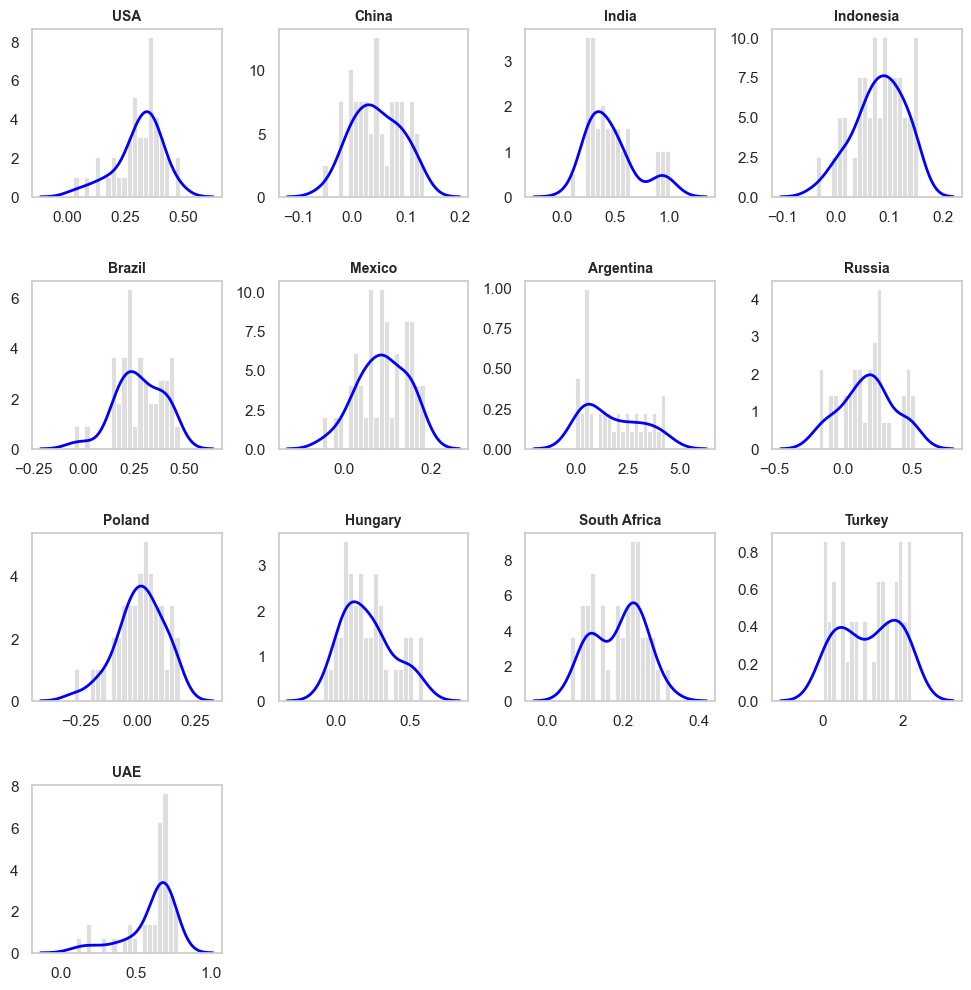

In [149]:
plt.close('all')
sns.set(style="whitegrid")

n_countries = len(countries)
n_cols = 4
n_rows = (n_countries // n_cols) + (n_countries % n_cols > 0)

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(12, 3 * n_rows))
fig.subplots_adjust(hspace=0.5, wspace=0.3)

axes = axes.flatten()

for i, (country, residual_dict) in enumerate(model_residuals.items()):
    ax = axes[i]
    if 'Random Forest' in residual_dict:
        residuals = residual_dict['Random Forest']

        sns.histplot(residuals, bins=20, kde=False, color="lightgrey", ax=ax, stat="density")
        sns.kdeplot(residuals, color="blue", ax=ax, lw=2)

        ax.set_title(f'{country}', fontsize=10, fontweight='bold')
        ax.set_xlabel(None)
        ax.set_ylabel(None)
        ax.grid(False)

for j in range(i + 1, len(axes)):
    axes[j].set_visible(False)

plt.show()

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/4020756557.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


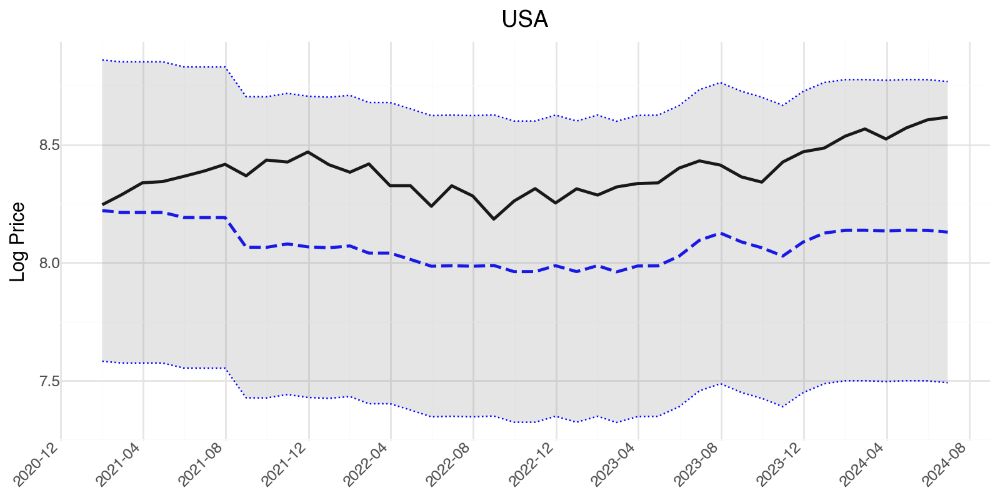

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/4020756557.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


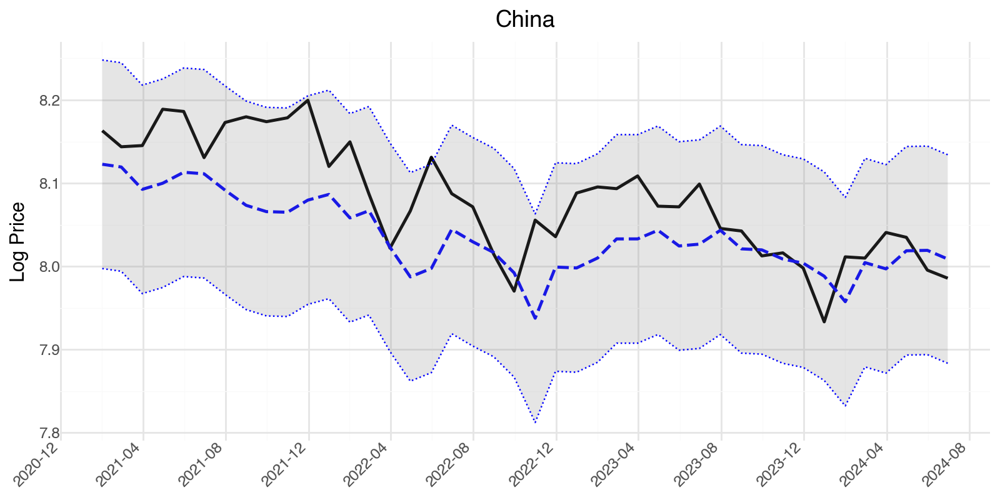

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/4020756557.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


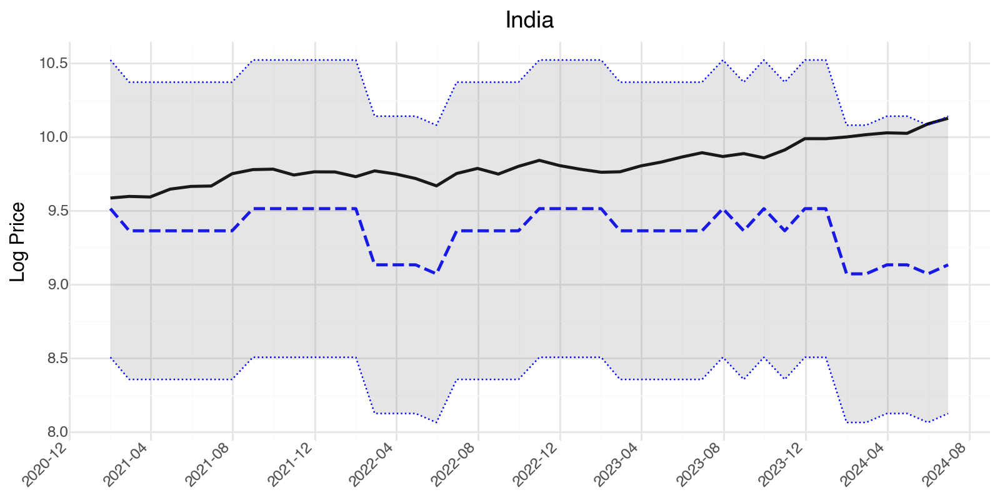

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/4020756557.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


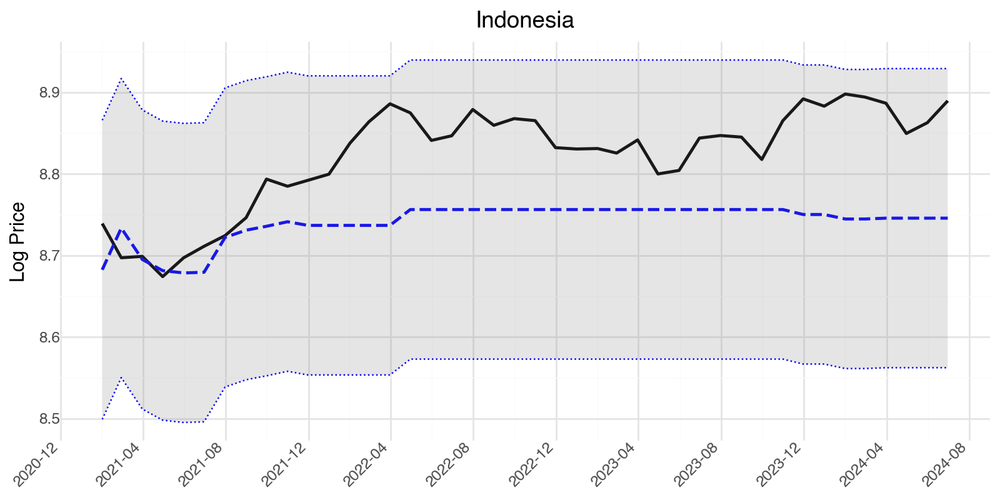

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/4020756557.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


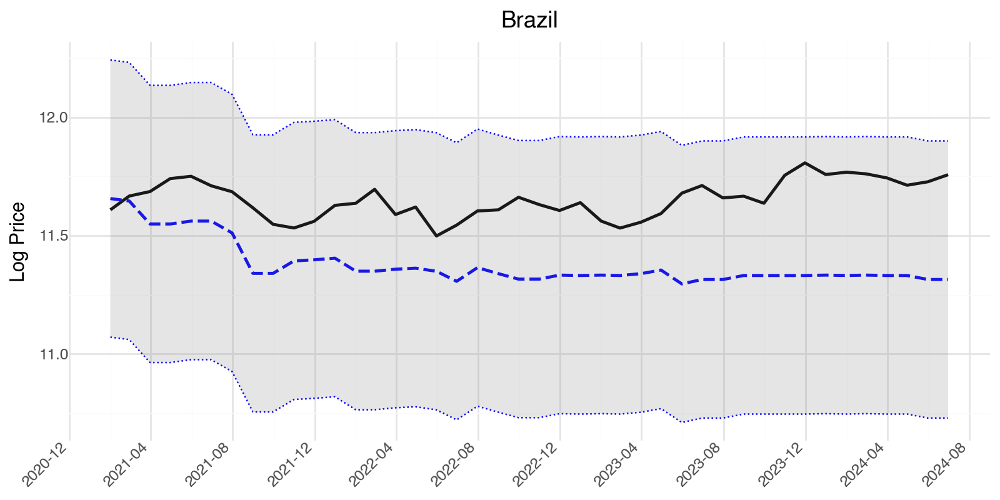

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/4020756557.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


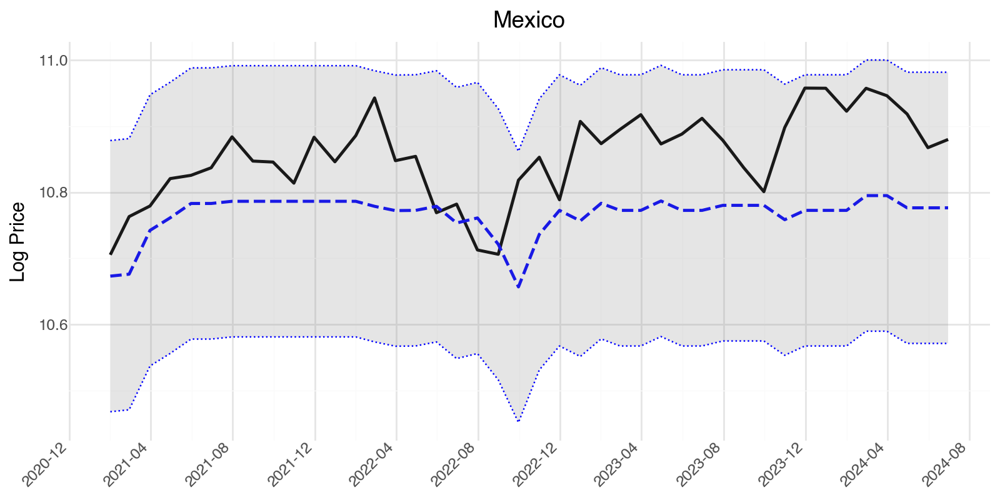

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/4020756557.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


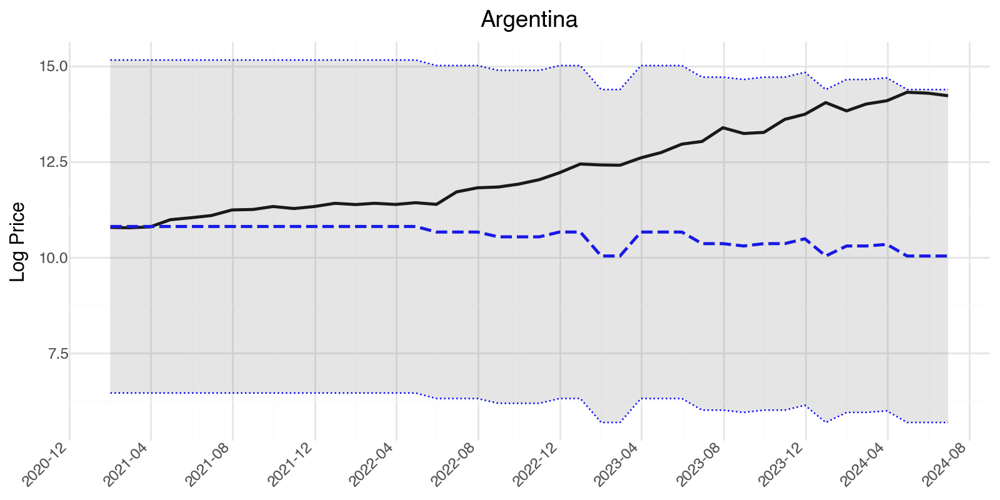

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/4020756557.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


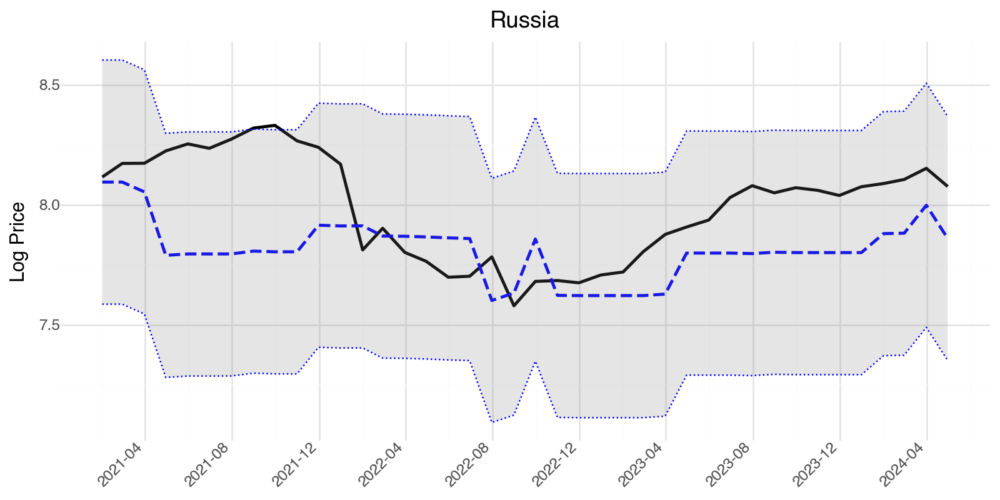

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/4020756557.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


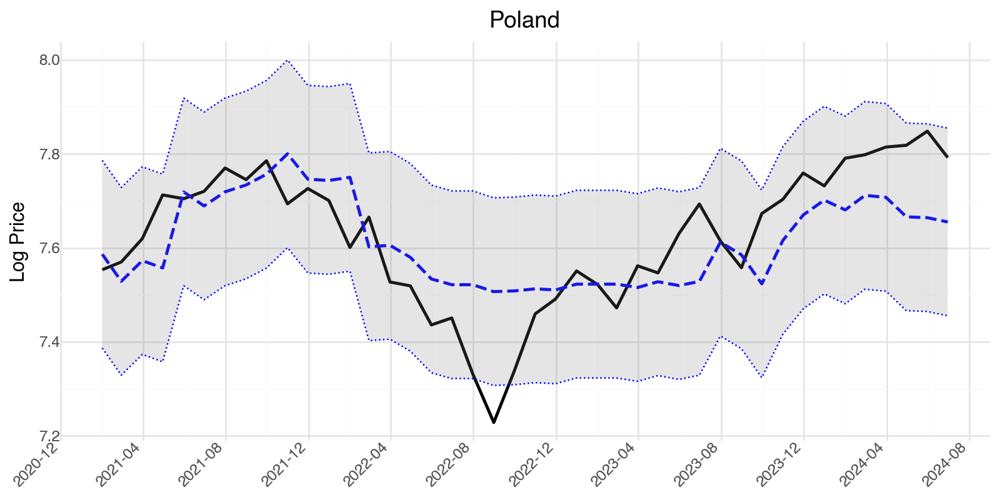

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/4020756557.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


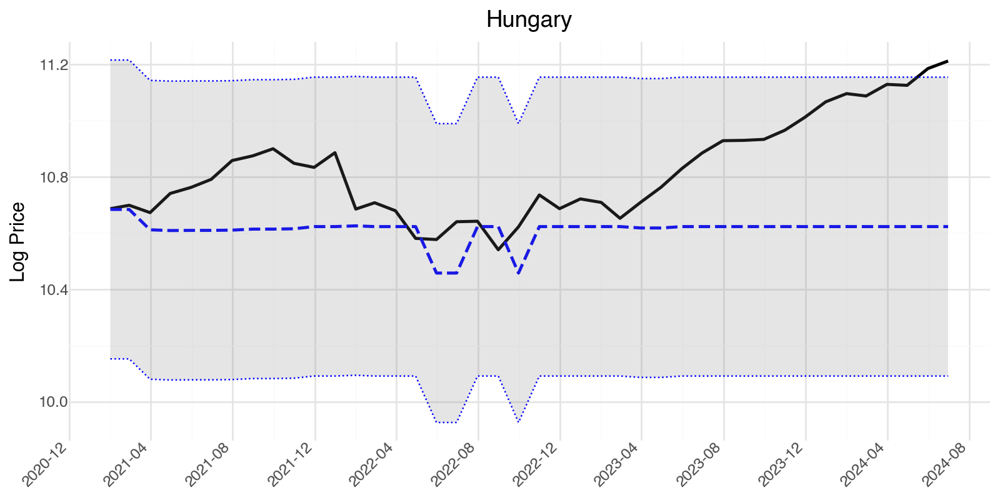

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/4020756557.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


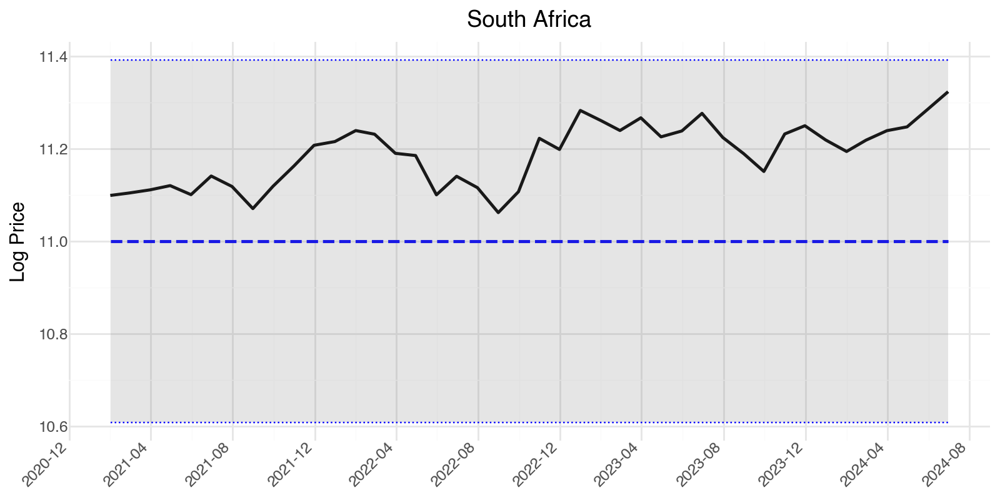

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/4020756557.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


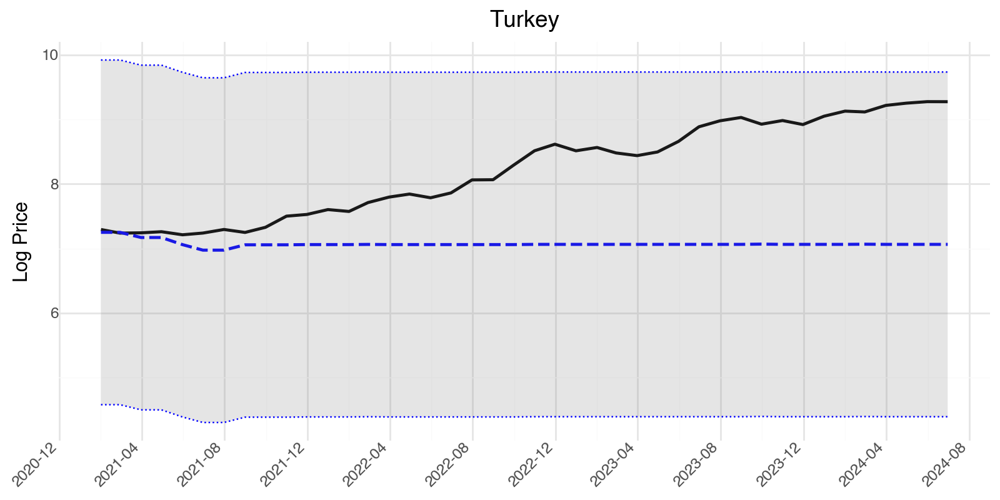

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/4020756557.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


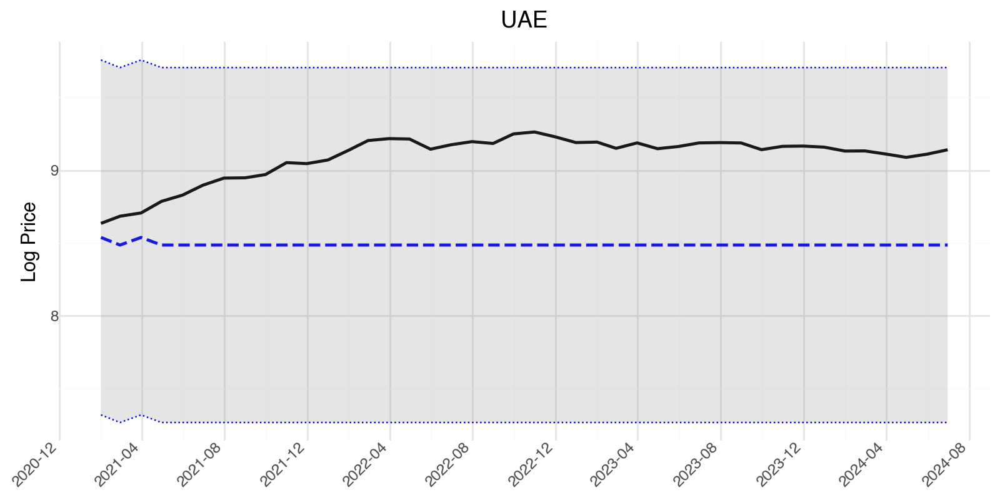

In [150]:
def plot_actual_vs_predicted_ggplot_randomforest(countries_data, predictions, original_dfs):
    plots = []
    for country, test_df in countries_data.items():
        original_df = original_dfs[country]

        y_actual = original_df.loc[test_df.index, 'Price_log_t1']
        y_pred = predictions[country]['Random Forest']

        lower_bound, upper_bound = calculate_confidence_intervals(y_pred, y_actual)

        df_plot = pd.DataFrame({
            'Date': test_df.index,
            'Actual': y_actual,
            'Predicted': y_pred,
            'Lower': lower_bound,
            'Upper': upper_bound
        })

        p = (ggplot(df_plot, aes(x='Date')) +
             geom_line(aes(y='Actual'), color='black', size=1.0) +
             geom_line(aes(y='Predicted'), color='blue', linetype='dashed', size=1.0) +
             geom_ribbon(aes(ymin='Lower', ymax='Upper'), alpha=0.2, fill='grey') +
             geom_line(aes(y='Lower'), linetype='dotted', color='blue', size=0.5) +
             geom_line(aes(y='Upper'), linetype='dotted', color='blue', size=0.5) +
             ggtitle(f'{country}') +
             scale_x_datetime(date_labels='%Y-%m', date_breaks='4 months') +
             xlab('') + 
             ylab('Log Price') +
             theme_minimal() +
             theme(
                 axis_text_x=element_text(rotation=45, hjust=1),
                 figure_size=(8, 4),
             ))

        plots.append(p)

    return plots

plots = plot_actual_vs_predicted_ggplot_randomforest(X_tests, model_predictions, countries)
for p in plots:
    print(p)

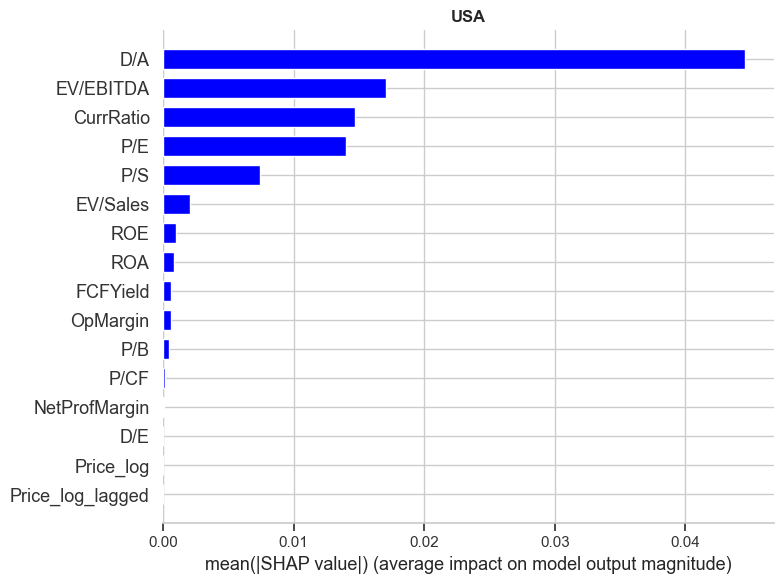

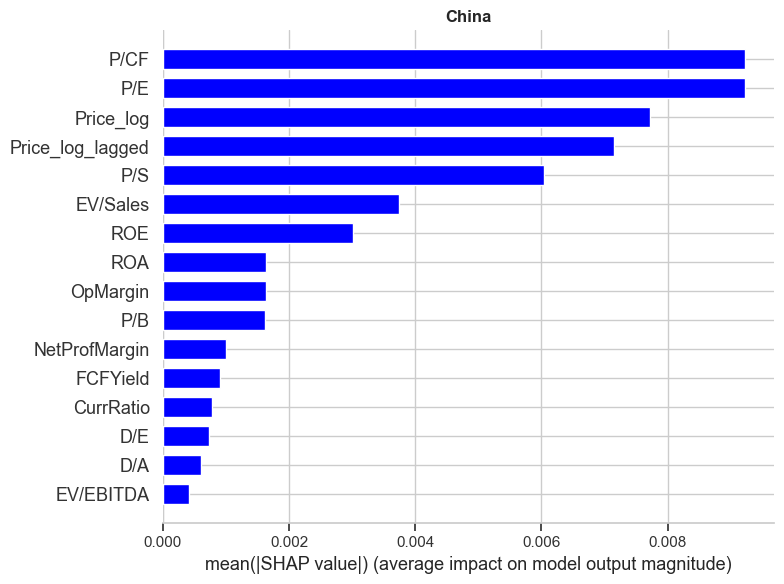

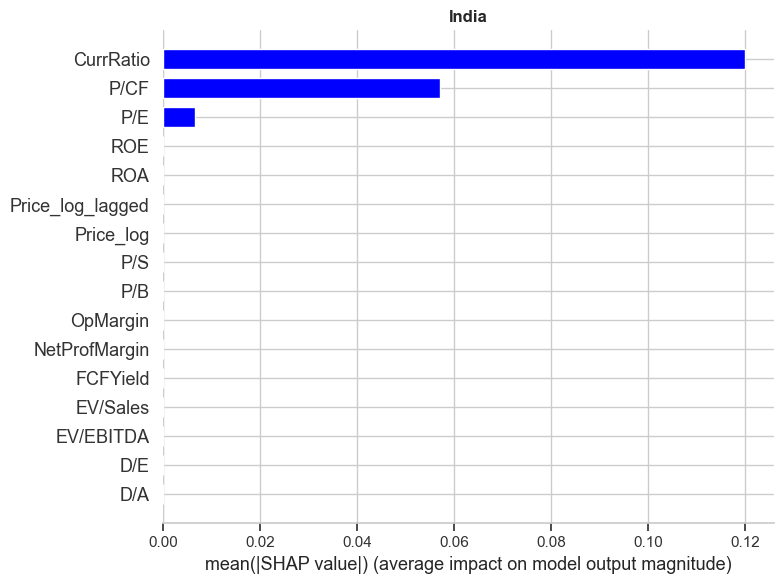

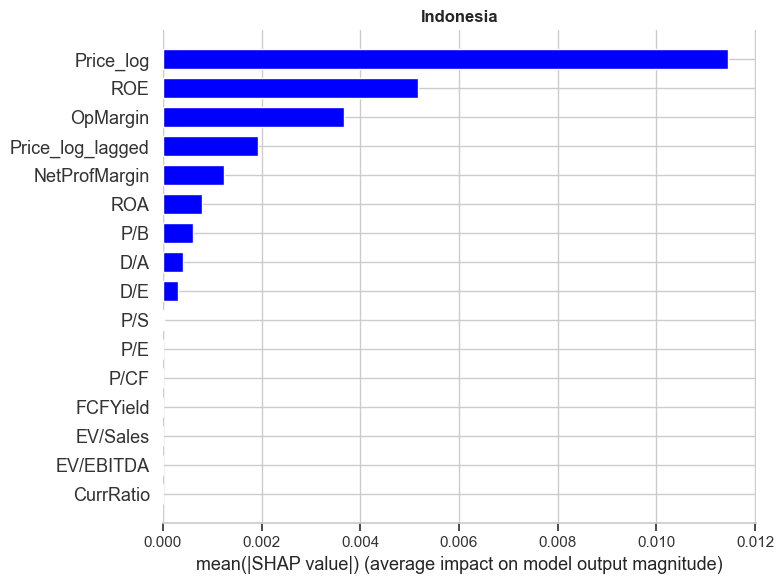

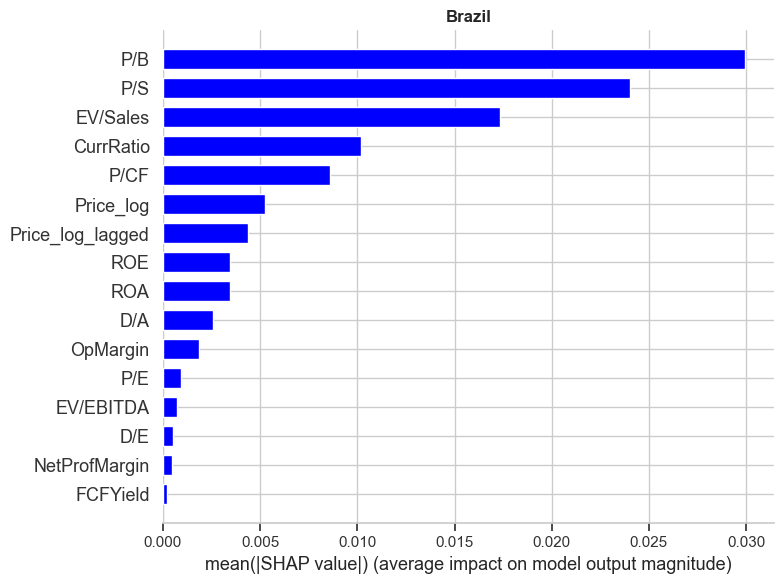

...

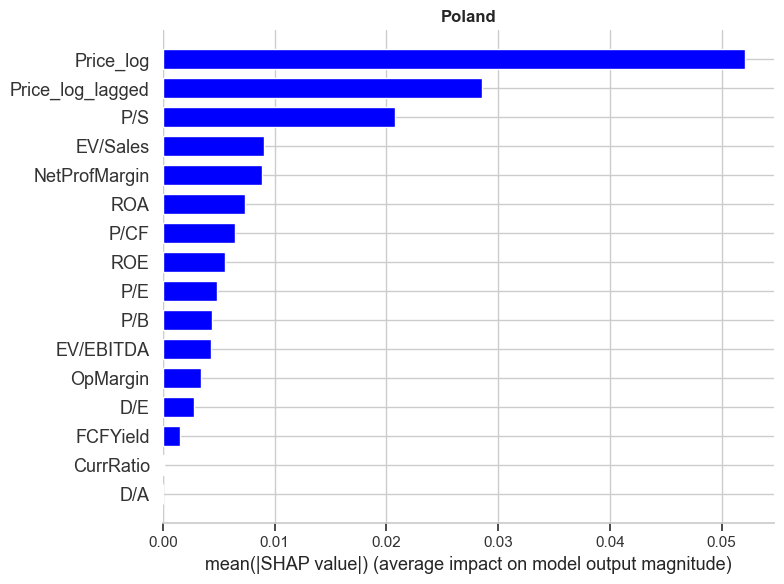

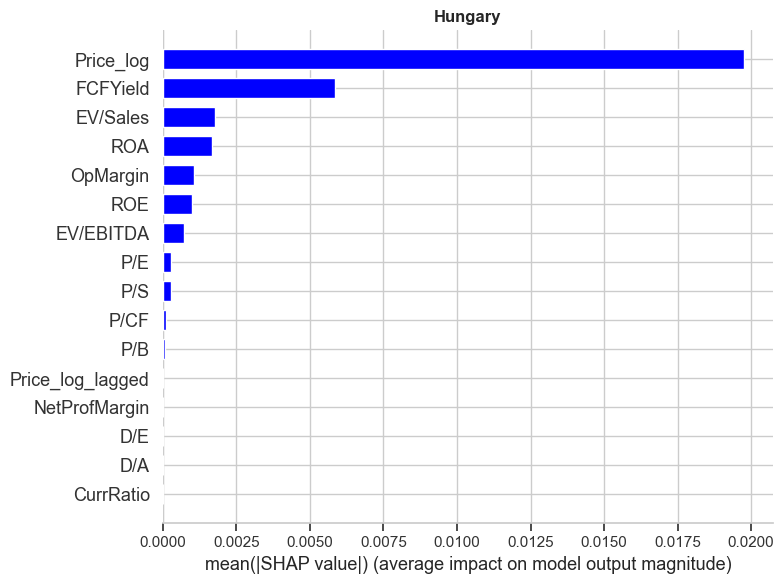

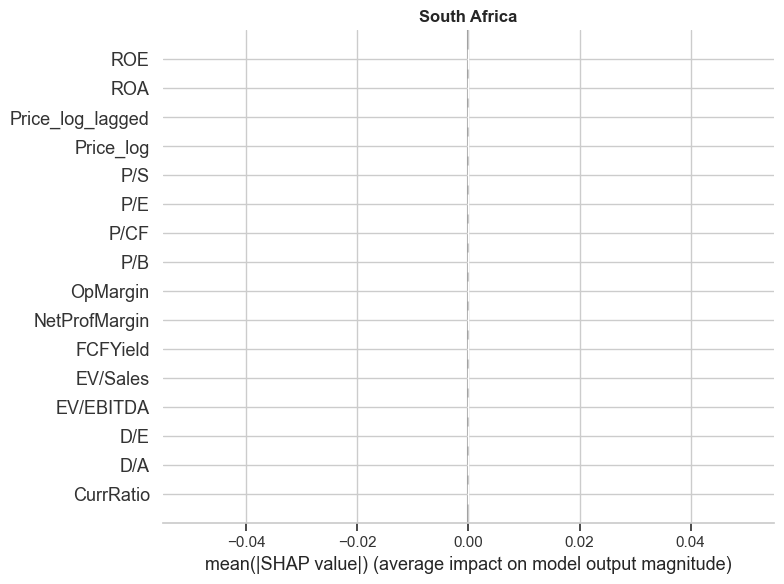

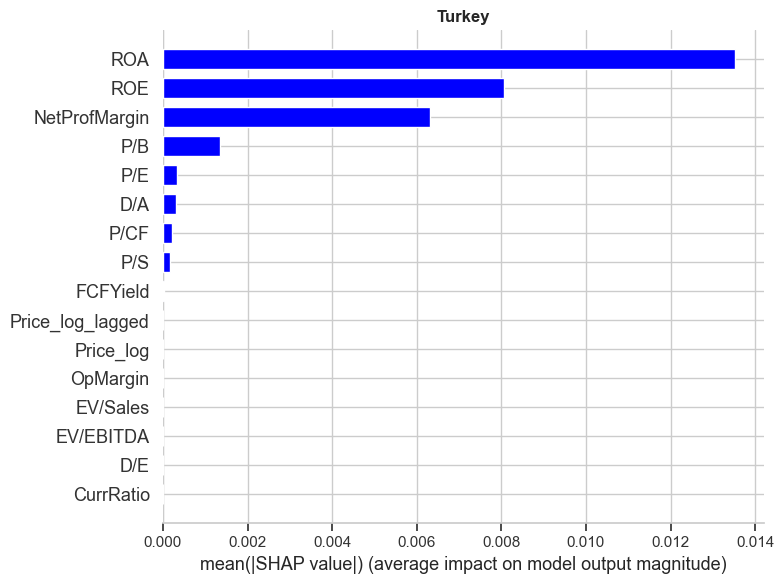

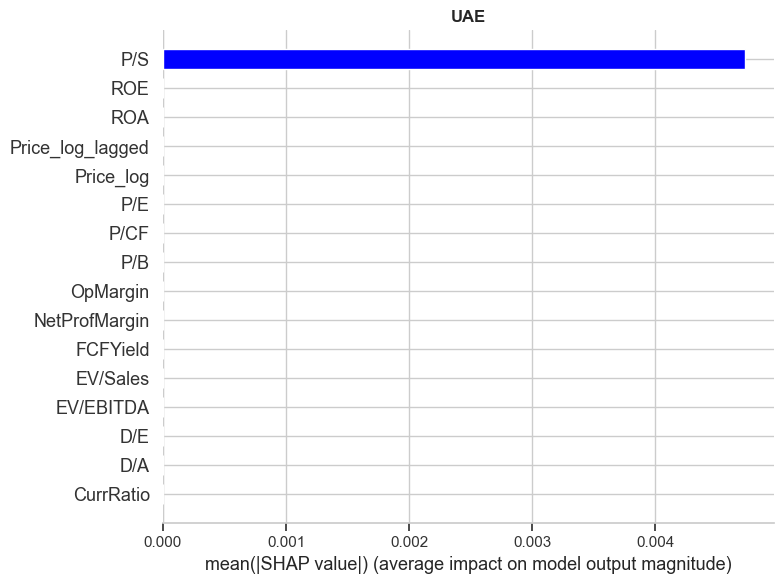

In [151]:
def plot_shap_summary_random_forest(models, X_tests):

    for country in X_tests:
        model_key = f'model_rf_{country}'
        model = models.get(model_key)
        X_test = X_tests.get(country)

        if model is not None and X_test is not None:
            best_model = model.best_estimator_

            explainer = shap.Explainer(best_model, X_test)
            shap_values = explainer(X_test)

            plt.figure()
            plt.title(f'{country}', fontweight='bold')
            shap.summary_plot(shap_values, X_test, plot_type="bar", plot_size=(8, 6), color='blue')
        else:
            print(f"Model or X_test not found for {country} using Random Forest.")

plot_shap_summary_random_forest(models, X_tests)

#### **6. Gradient Boosting**

Execution time: **~5min.**

In [152]:
model_name = 'Gradient Boosting'
parameters = {
    'n_estimators': [100, 200, 300, 500, 1000],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'max_depth': [3, 5, 7, 10]
}

gb = GradientBoostingRegressor(random_state=42)

for country, df in countries.items():
        
    features = df.columns.difference(['Price_log_t1'])
    target_column = 'Price_log_t1'
    
    train_df = df[(df.index >= '2009-09-01') & (df.index <= '2020-12-31')]
    test_df = df[(df.index >= '2021-01-01') & (df.index <= '2024-12-31')]
    
    X_train = train_df[features]
    y_train = train_df[target_column]
    X_test = test_df[features]
    y_test = test_df[target_column]
    
    tscv = TimeSeriesSplit(n_splits=5)
    model_gb = GridSearchCV(
        gb,
        parameters,
        scoring='neg_mean_squared_error',
        cv=tscv,
        n_jobs=-1
    )
    model_gb.fit(X_train, y_train)
    y_pred = model_gb.predict(X_test)

    models[f'model_gb_{country}'] = model_gb
    X_tests[country] = X_test
    
    update_model_evaluation(model_name, country, y_test, y_pred)
    
    residuals = y_test - y_pred
    if country not in model_residuals:
        model_residuals[country] = {}
    model_residuals[country][model_name] = residuals

display_evaluation_tables(['R2', 'MSE', 'RMSE'])

--- R2 Evaluation Table ---


,Linear Regression,Lasso Regression,Ridge Regression,Elastic Net,Random Forest,Gradient Boosting
USA,0.391993,0.589591,0.347337,0.588683,-9.398111,-12.883970
China,-0.158996,0.022098,-0.082900,0.021688,0.116516,0.428169
India,0.295948,-0.214268,-3.235641,-0.163115,-14.326011,-11.778965
Indonesia,0.612949,0.718325,0.296158,0.720917,-1.291548,-3.099613
Brazil,-1.489173,-25.170222,-12.479498,-11.535942,-13.991495,-3.241379
Mexico,-1.215612,-1.103536,-1.452950,-1.508953,-1.556815,-4.440630
Argentina,0.811296,0.961424,0.932782,0.936916,-2.831204,-2.855951
Russia,0.856806,0.842237,0.856484,0.847849,-0.465590,-0.448171
Poland,0.527268,0.406225,0.543432,0.399354,0.504019,0.675472
Hungary,-0.007221,-0.085244,0.080886,-0.123347,-1.373188,-2.403083


--- MSE Evaluation Table ---


,Linear Regression,Lasso Regression,Ridge Regression,Elastic Net,Random Forest,Gradient Boosting
USA,0.006201,0.004186,0.006656,0.004195,0.106047,0.141598
China,0.005368,0.004529,0.005015,0.004531,0.004092,0.002648
India,0.012141,0.020939,0.073041,0.020057,0.264288,0.220366
Indonesia,0.001479,0.001076,0.002689,0.001066,0.008754,0.015661
Brazil,0.014823,0.155839,0.080268,0.074649,0.089271,0.025257
Mexico,0.009497,0.009017,0.010514,0.010754,0.010959,0.023320
Argentina,0.242288,0.049530,0.086305,0.080997,4.919097,4.950871
Russia,0.006574,0.007242,0.006588,0.006985,0.067281,0.066481
Poland,0.009892,0.012424,0.009553,0.012568,0.010378,0.006790
Hungary,0.031218,0.033636,0.028487,0.034817,0.073554,0.105475


--- RMSE Evaluation Table ---


,Linear Regression,Lasso Regression,Ridge Regression,Elastic Net,Random Forest,Gradient Boosting
USA,0.078746,0.064696,0.081586,0.064768,0.325648,0.376295
China,0.073265,0.067299,0.070819,0.067313,0.063967,0.051463
India,0.110186,0.144704,0.270261,0.141624,0.514090,0.469432
Indonesia,0.038452,0.032803,0.051853,0.032651,0.093562,0.125143
Brazil,0.121748,0.394764,0.283316,0.273220,0.298783,0.158923
Mexico,0.097452,0.094955,0.102539,0.103703,0.104687,0.152710
Argentina,0.492227,0.222553,0.293777,0.284599,2.217904,2.225055
Russia,0.081078,0.085102,0.081169,0.083575,0.259385,0.257839
Poland,0.099456,0.111464,0.097741,0.112107,0.101873,0.082404
Hungary,0.176685,0.183401,0.168781,0.186593,0.271209,0.324769


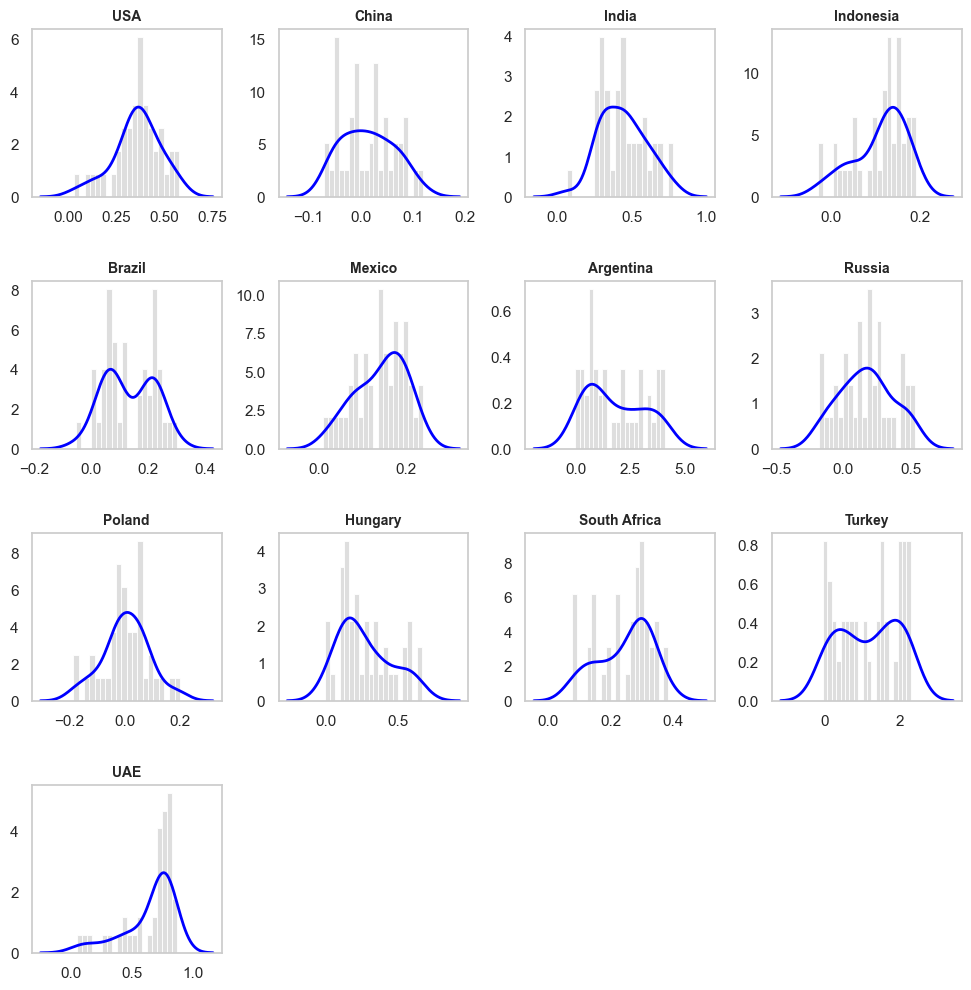

In [153]:
plt.close('all')
sns.set(style="whitegrid")

n_countries = len(countries)
n_cols = 4 
n_rows = (n_countries // n_cols) + (n_countries % n_cols > 0)

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(12, 3 * n_rows))
fig.subplots_adjust(hspace=0.5, wspace=0.3)

axes = axes.flatten()

for i, (country, residual_dict) in enumerate(model_residuals.items()):
    ax = axes[i]
    if 'Gradient Boosting' in residual_dict:
        residuals = residual_dict['Gradient Boosting']

        sns.histplot(residuals, bins=20, kde=False, color="lightgrey", ax=ax, stat="density")
        sns.kdeplot(residuals, color="blue", ax=ax, lw=2)

        ax.set_title(f'{country}', fontsize=10, fontweight='bold')
        ax.set_xlabel(None)
        ax.set_ylabel(None)
        ax.grid(False)

for j in range(i + 1, len(axes)):
    axes[j].set_visible(False)

plt.show()

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/811947689.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


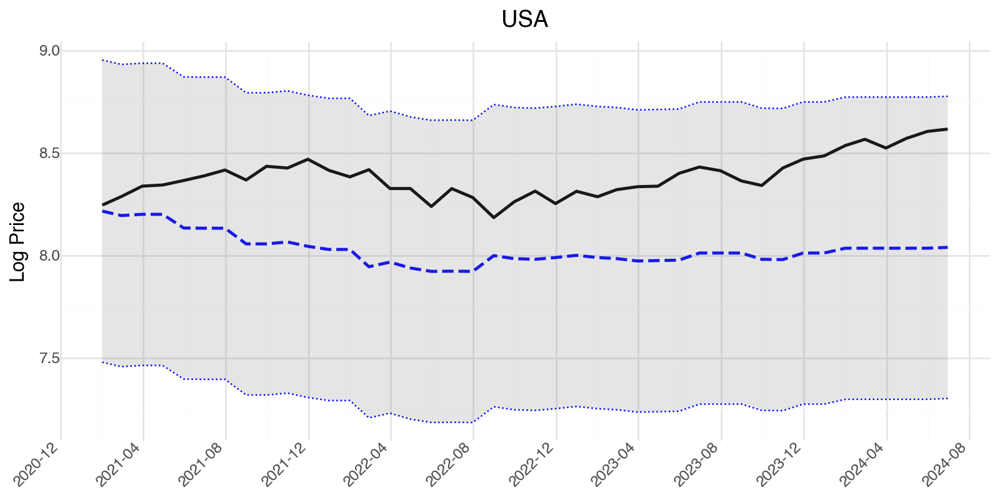

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/811947689.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


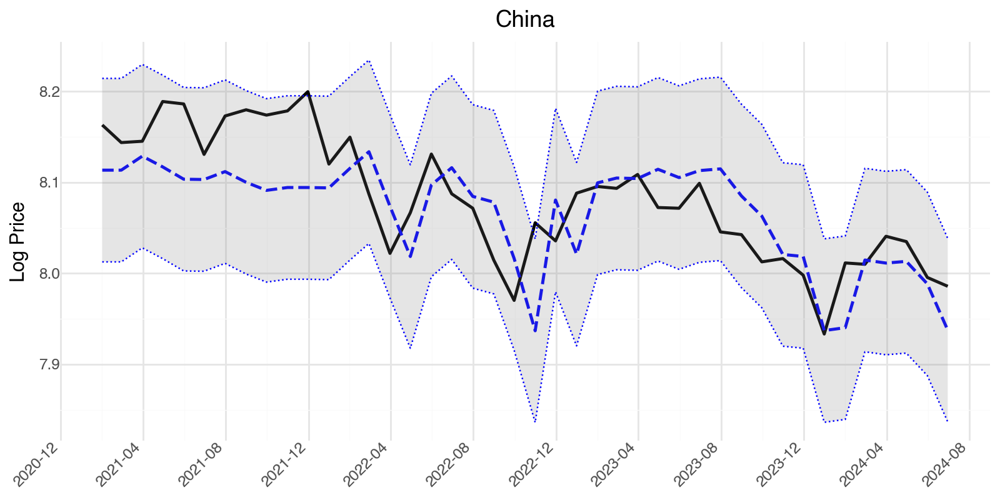

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/811947689.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


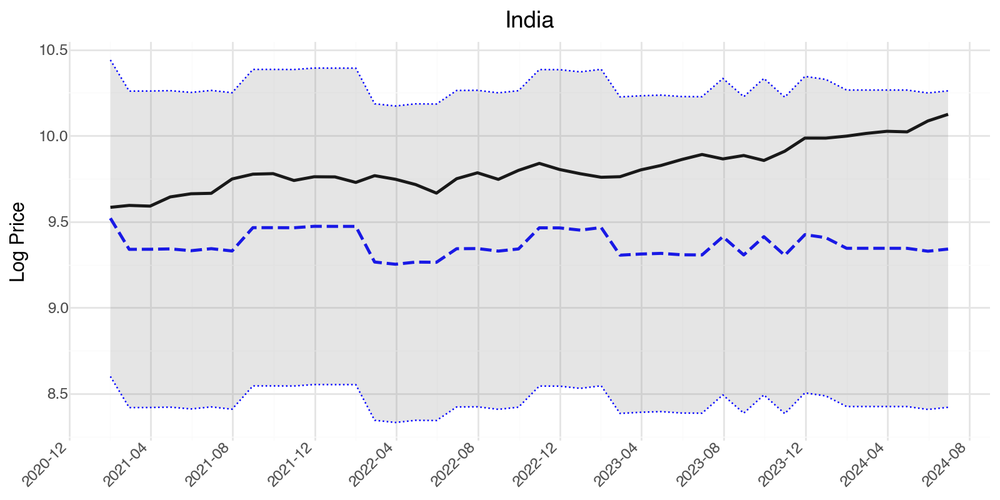

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/811947689.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


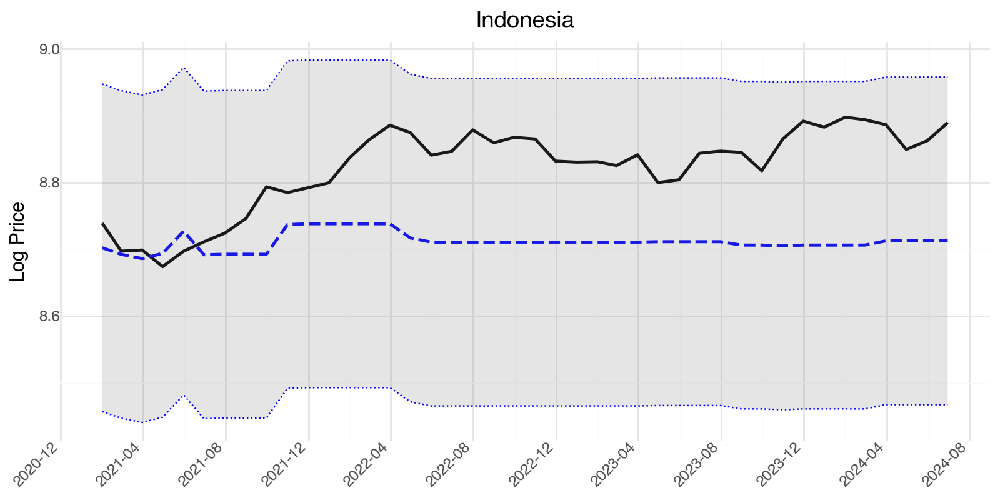

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/811947689.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


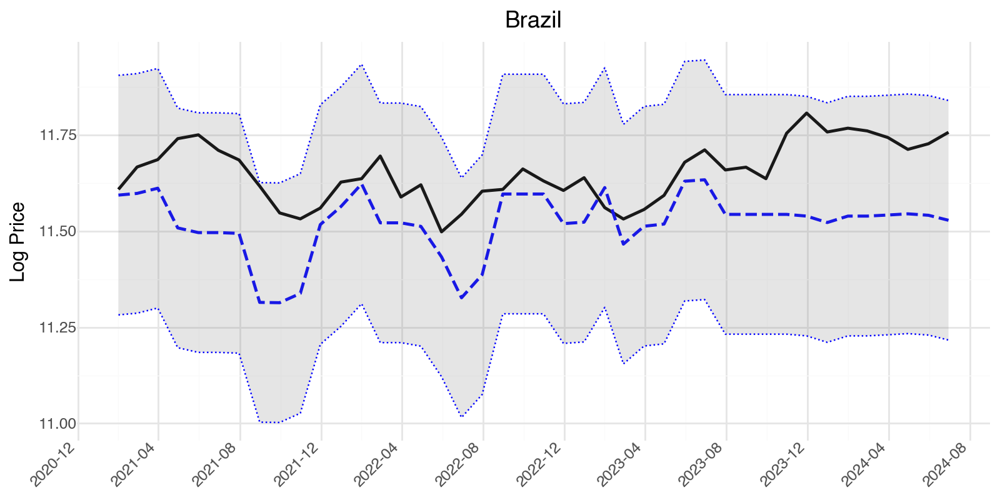

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/811947689.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


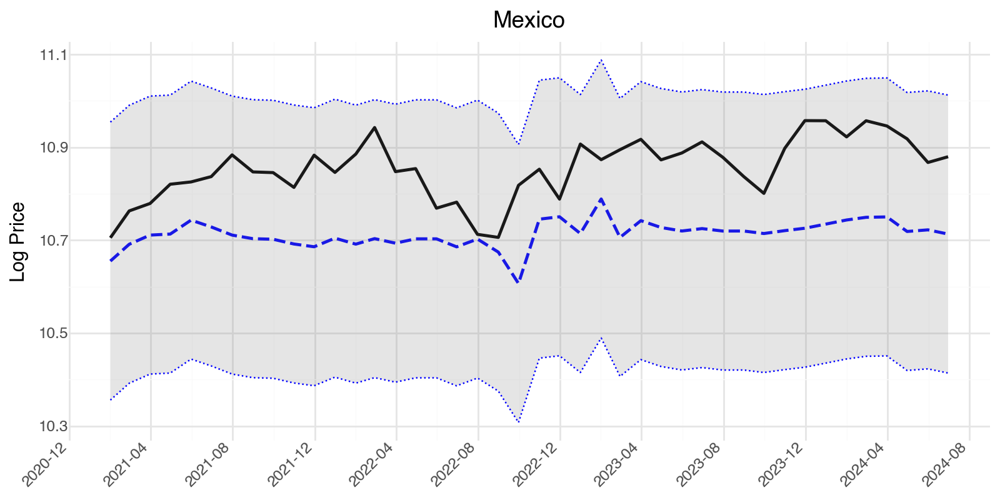

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/811947689.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


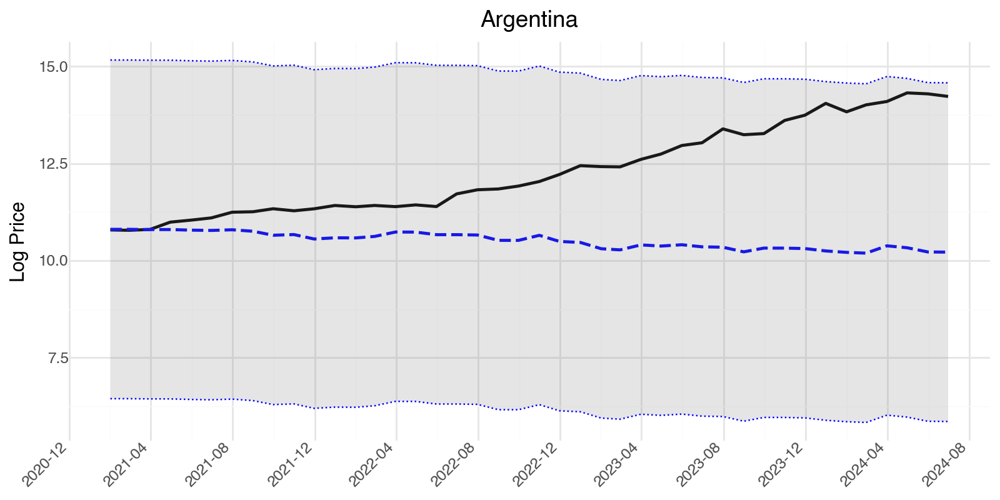

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/811947689.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


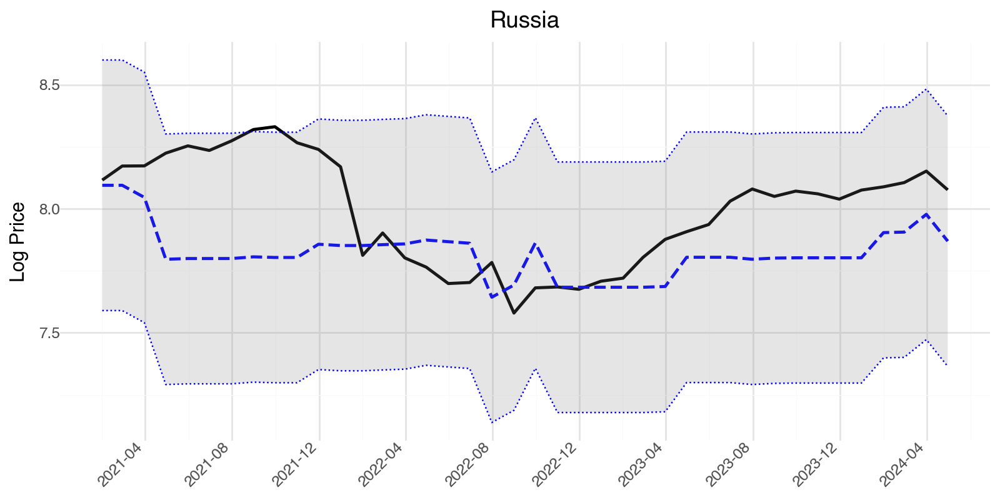

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/811947689.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


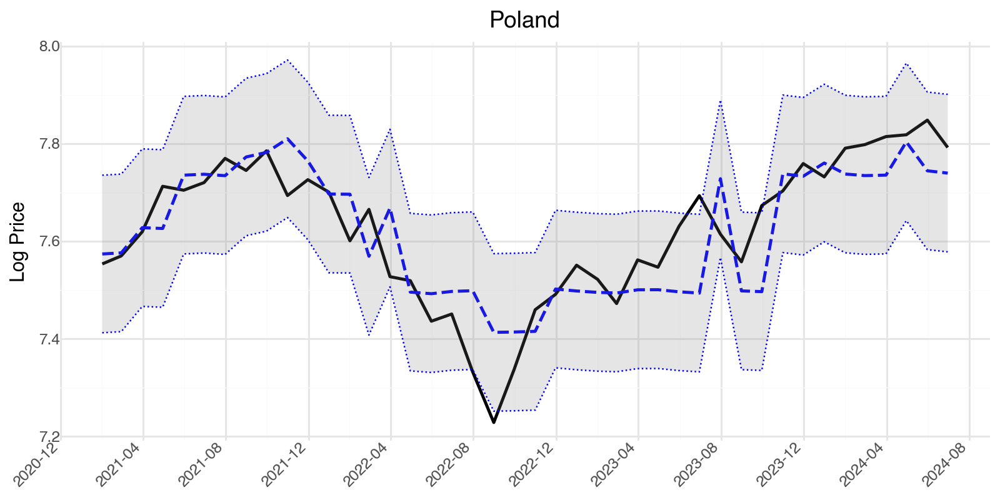

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/811947689.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


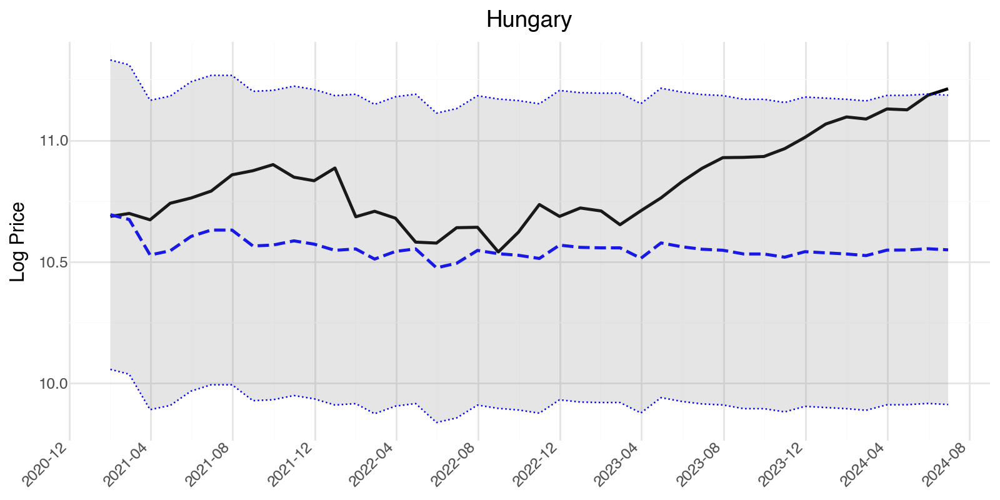

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/811947689.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


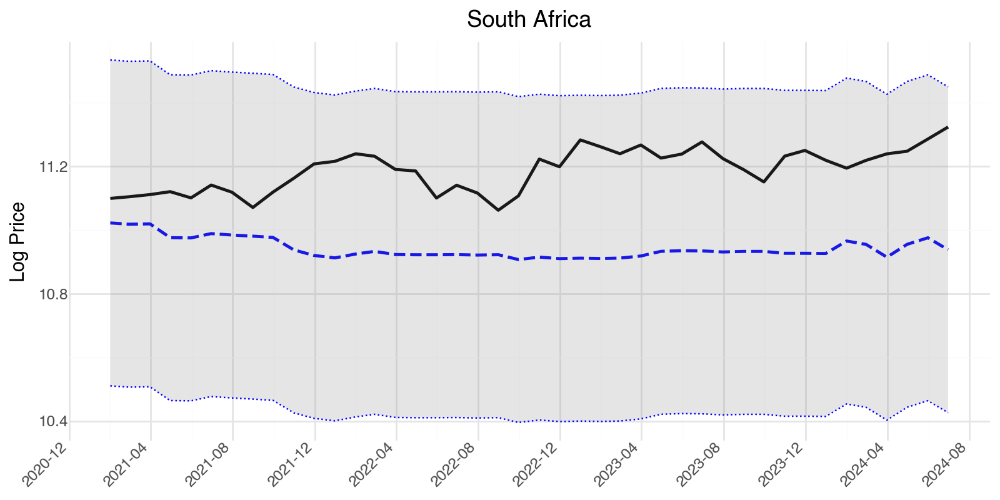

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/811947689.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


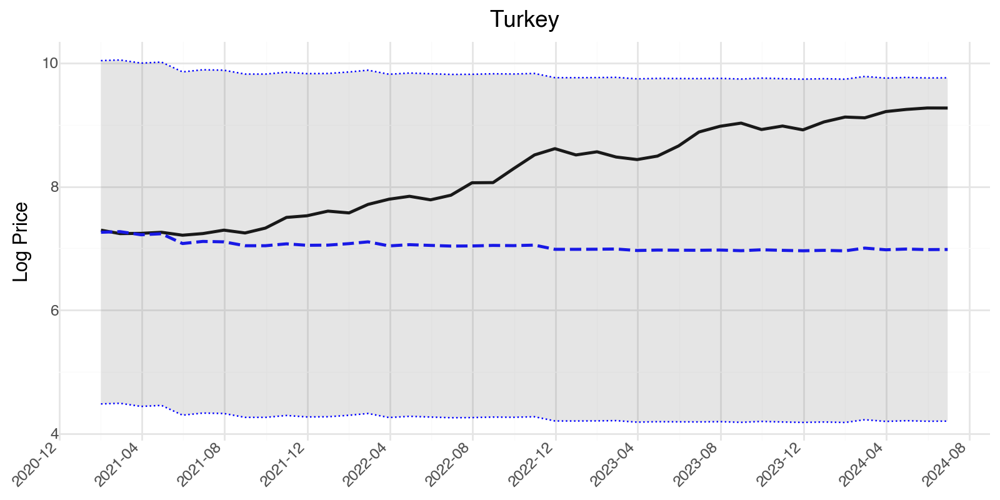

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/811947689.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


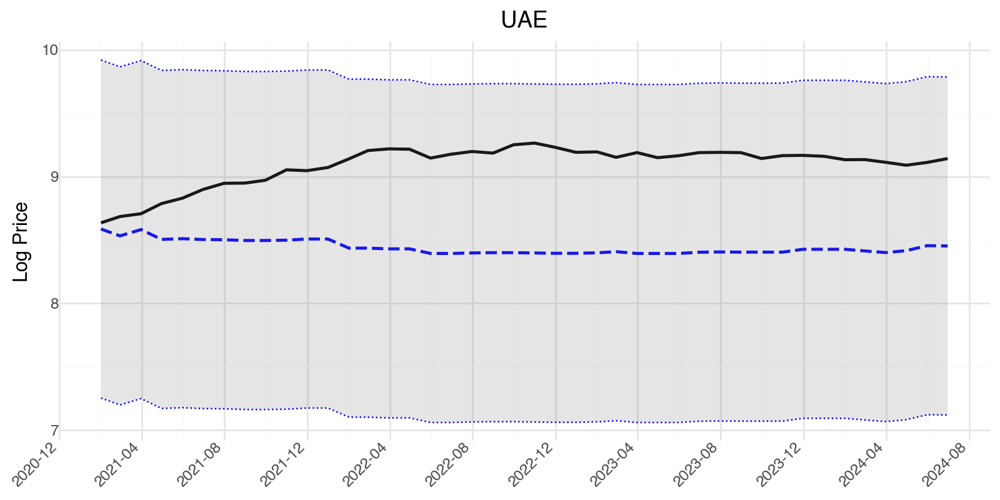

In [154]:
def plot_actual_vs_predicted_ggplot_gb(countries_data, predictions, original_dfs):
    plots = []
    for country, test_df in countries_data.items():
        original_df = original_dfs[country]

        y_actual = original_df.loc[test_df.index, 'Price_log_t1']
        y_pred = predictions[country]['Gradient Boosting']

        lower_bound, upper_bound = calculate_confidence_intervals(y_pred, y_actual)

        df_plot = pd.DataFrame({
            'Date': test_df.index,
            'Actual': y_actual,
            'Predicted': y_pred,
            'Lower': lower_bound,
            'Upper': upper_bound
        })

        p = (ggplot(df_plot, aes(x='Date')) +
             geom_line(aes(y='Actual'), color='black', size=1.0) +
             geom_line(aes(y='Predicted'), color='blue', linetype='dashed', size=1.0) +
             geom_ribbon(aes(ymin='Lower', ymax='Upper'), alpha=0.2, fill='grey') +
             geom_line(aes(y='Lower'), linetype='dotted', color='blue', size=0.5) +
             geom_line(aes(y='Upper'), linetype='dotted', color='blue', size=0.5) +
             ggtitle(f'{country}') +
             scale_x_datetime(date_labels='%Y-%m', date_breaks='4 months') +
             xlab('') + 
             ylab('Log Price') +
             theme_minimal() +
             theme(
                 axis_text_x=element_text(rotation=45, hjust=1),
                 figure_size=(8, 4),
             ))

        plots.append(p)

    return plots

plots = plot_actual_vs_predicted_ggplot_gb(X_tests, model_predictions, countries)
for p in plots:
    print(p)

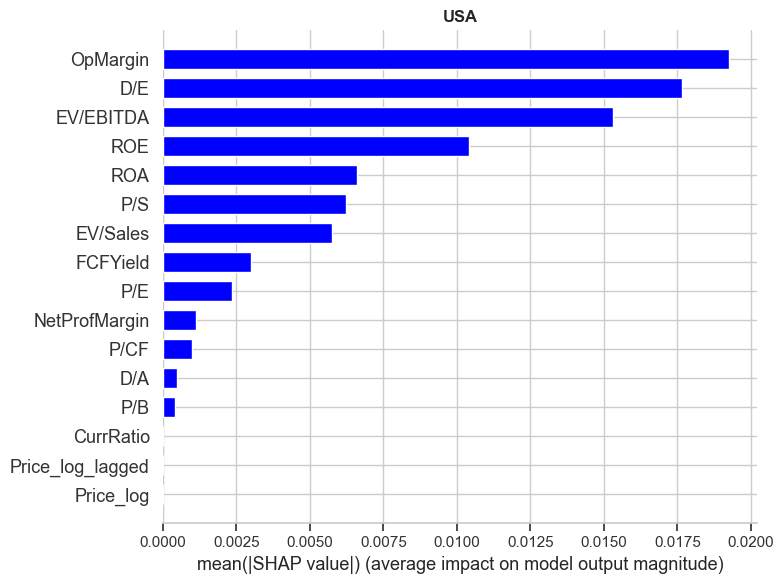

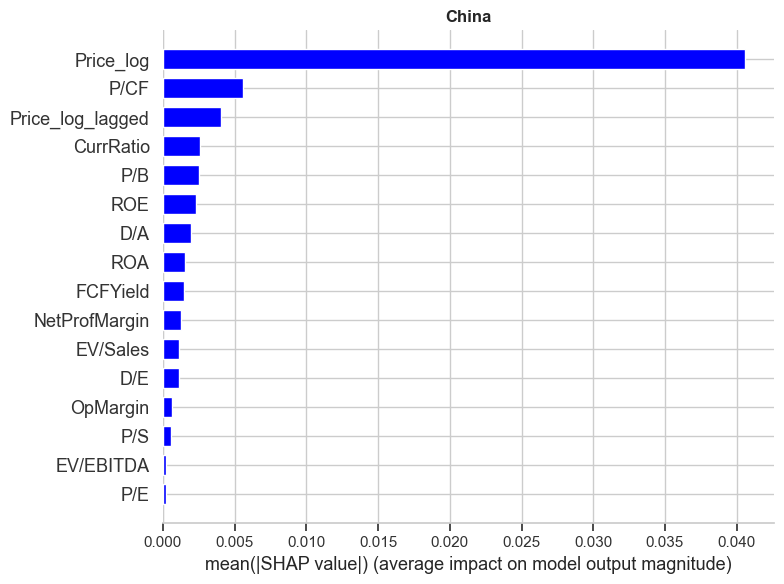

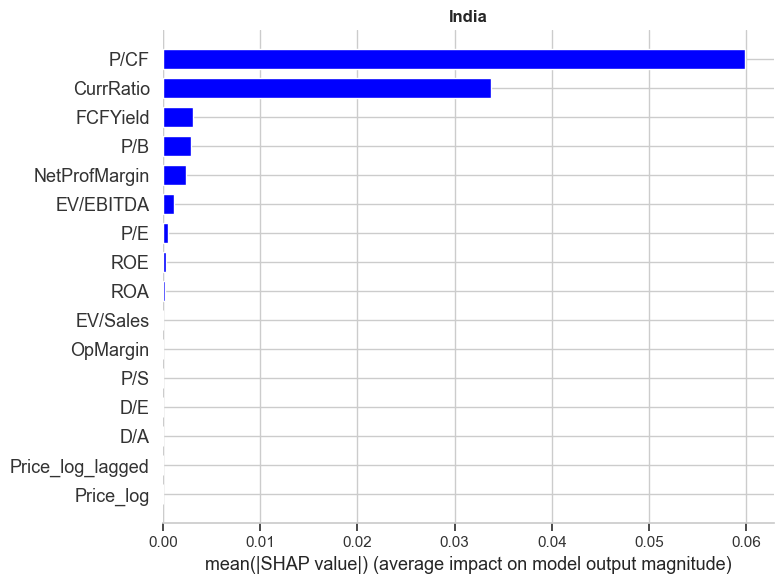

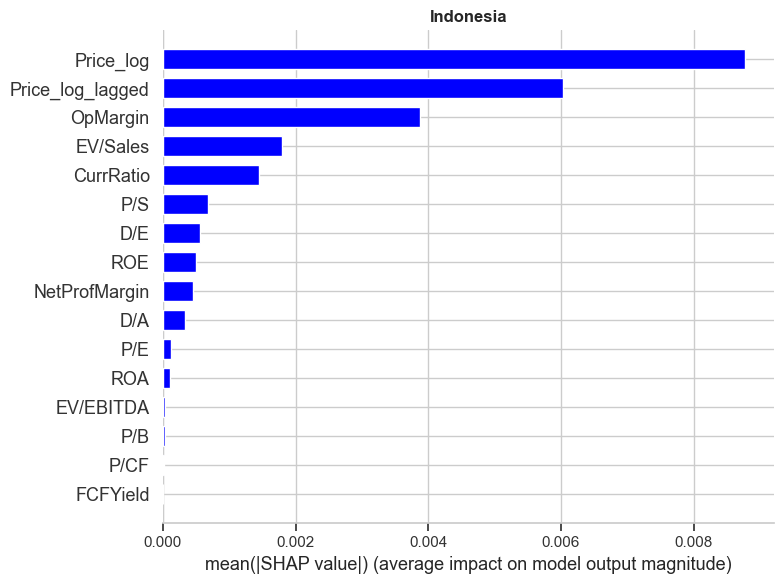

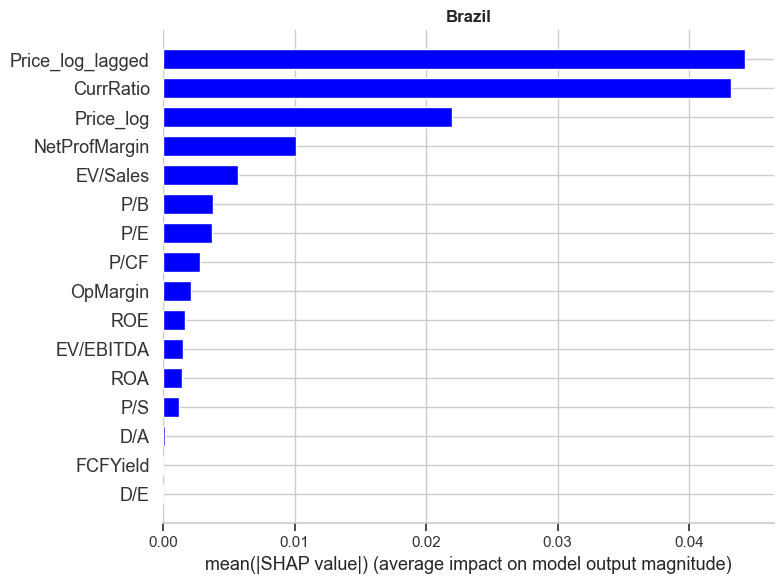

...

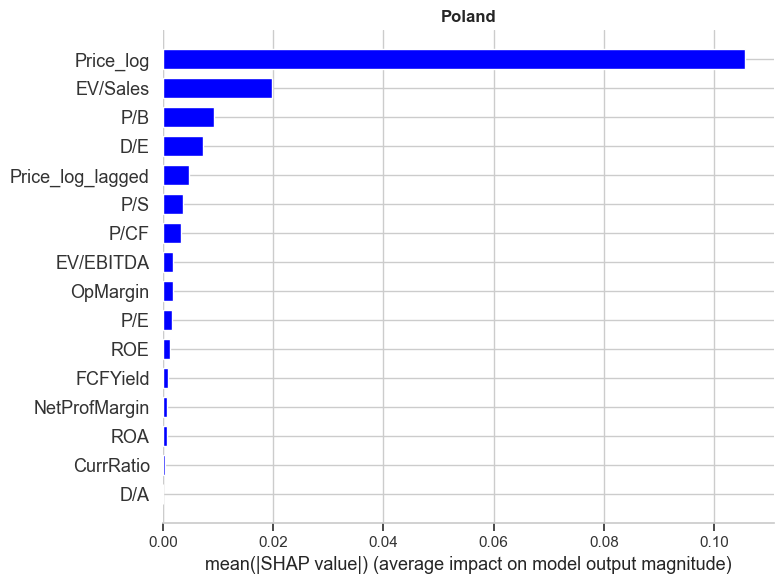

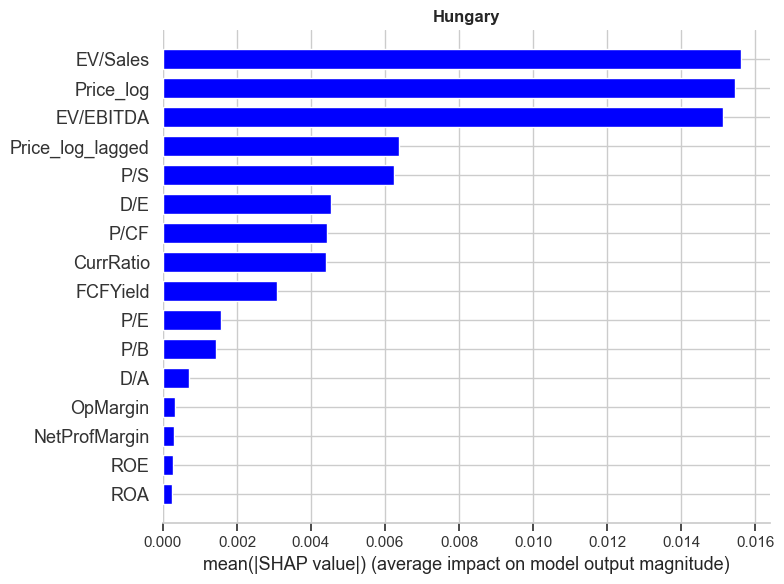

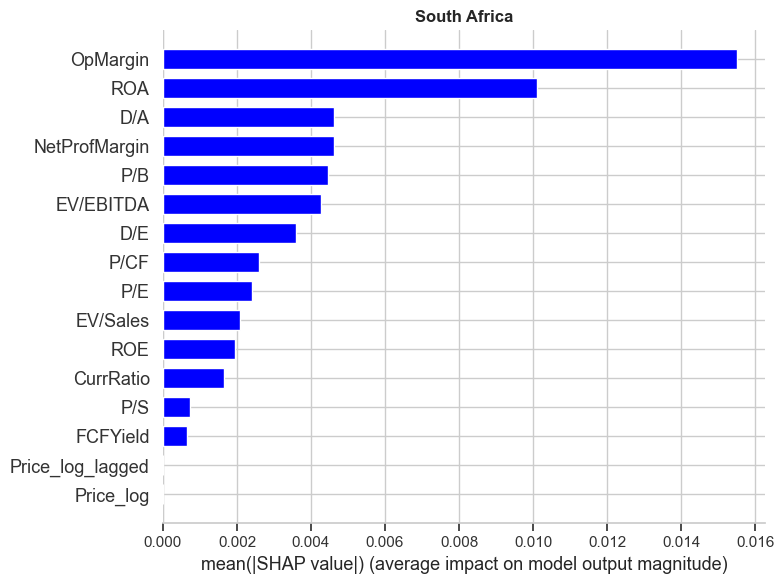

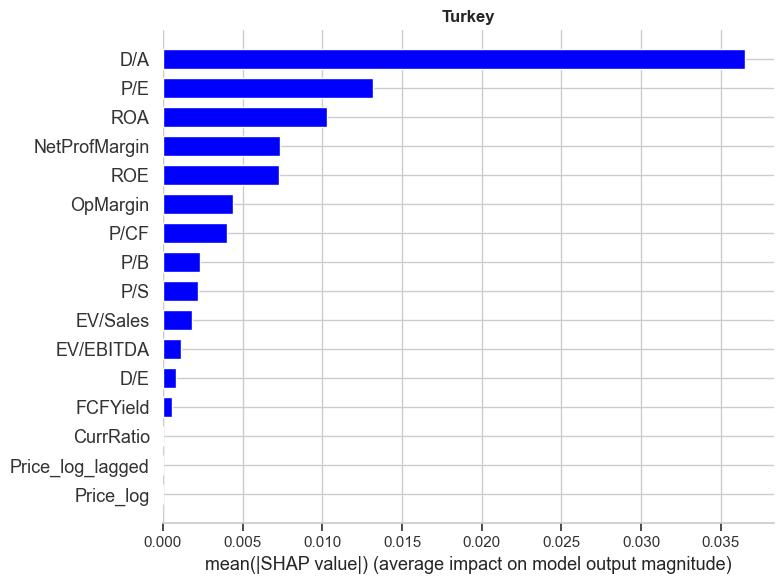

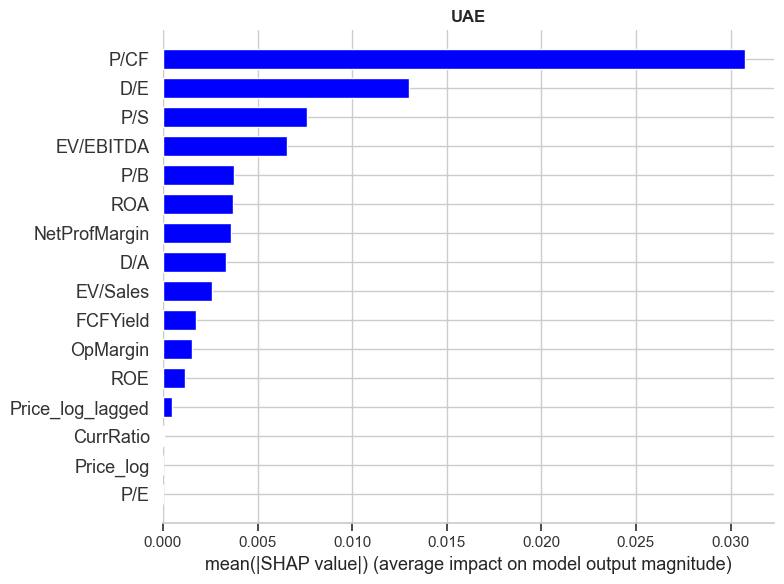

In [155]:
def plot_shap_summary_gradient_boosting(models, X_tests):
    for country in X_tests:
        model_key = f'model_gb_{country}'
        model = models.get(model_key)
        X_test = X_tests.get(country)

        if model is not None and X_test is not None:
            best_model = model.best_estimator_

            explainer = shap.Explainer(best_model, X_test)
            shap_values = explainer(X_test)

            plt.figure()
            plt.title(f'{country}', fontweight='bold')
            shap.summary_plot(shap_values, X_test, plot_type="bar", plot_size=(8, 6), color='blue')
        else:
            print(f"Model or X_test not found for {country} using Gradient Boosting.")

plot_shap_summary_gradient_boosting(models, X_tests)

#### **7. XGBoost**

In [156]:
model_name = 'XGBoost'
xgb_model = xgb.XGBRegressor(objective='reg:squarederror', tree_method='auto', grow_policy='depthwise')

parameters = {
    'n_estimators': [100, 300, 500, 1000],
    'max_depth': [3, 5, 7, 10],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'subsample': [0.6, 0.8, 1.0],
    'colsample_bytree': [0.6, 0.8, 1.0],
    'gamma': [0, 0.1, 0.5],
    'reg_lambda': [0.5, 1, 1.5, 2],
    'reg_alpha': [0, 0.1, 0.5, 1],
    'min_child_weight': [1, 3, 5, 10]
}

for country, df in countries.items():
        
    features = df.columns.difference(['Price_log_t1'])
    target_column = 'Price_log_t1'
    
    train_df = df[(df.index >= '2009-09-01') & (df.index <= '2020-12-31')]
    test_df = df[(df.index >= '2021-01-01') & (df.index <= '2024-12-31')]
    
    X_train = train_df[features]
    y_train = train_df[target_column]
    X_test = test_df[features]
    y_test = test_df[target_column]
    
    tscv = TimeSeriesSplit(n_splits=5)
    model_xgb = RandomizedSearchCV(
        xgb_model,
        param_distributions=parameters,
        n_iter=100,
        scoring='neg_mean_squared_error',
        cv=tscv,
        random_state=42,
        n_jobs=-1
    )
    model_xgb.fit(X_train, y_train)
    y_pred = model_xgb.predict(X_test)

    models[f'model_xgb_{country}'] = model_xgb
    X_tests[country] = X_test
    
    update_model_evaluation(model_name, country, y_test, y_pred)
    
    residuals = y_test - y_pred
    if country not in model_residuals:
        model_residuals[country] = {}
    model_residuals[country][model_name] = residuals

display_evaluation_tables(['R2', 'MSE', 'RMSE'])

--- R2 Evaluation Table ---


,Linear Regression,Lasso Regression,Ridge Regression,Elastic Net,Random Forest,Gradient Boosting,XGBoost
USA,0.391993,0.589591,0.347337,0.588683,-9.398111,-12.883970,-13.586539
China,-0.158996,0.022098,-0.082900,0.021688,0.116516,0.428169,0.035822
India,0.295948,-0.214268,-3.235641,-0.163115,-14.326011,-11.778965,-12.155242
Indonesia,0.612949,0.718325,0.296158,0.720917,-1.291548,-3.099613,-2.741757
Brazil,-1.489173,-25.170222,-12.479498,-11.535942,-13.991495,-3.241379,-6.392371
Mexico,-1.215612,-1.103536,-1.452950,-1.508953,-1.556815,-4.440630,-7.114318
Argentina,0.811296,0.961424,0.932782,0.936916,-2.831204,-2.855951,-3.088142
Russia,0.856806,0.842237,0.856484,0.847849,-0.465590,-0.448171,0.387693
Poland,0.527268,0.406225,0.543432,0.399354,0.504019,0.675472,0.606323
Hungary,-0.007221,-0.085244,0.080886,-0.123347,-1.373188,-2.403083,-2.125255


--- MSE Evaluation Table ---


,Linear Regression,Lasso Regression,Ridge Regression,Elastic Net,Random Forest,Gradient Boosting,XGBoost
USA,0.006201,0.004186,0.006656,0.004195,0.106047,0.141598,0.148763
China,0.005368,0.004529,0.005015,0.004531,0.004092,0.002648,0.004466
India,0.012141,0.020939,0.073041,0.020057,0.264288,0.220366,0.226855
Indonesia,0.001479,0.001076,0.002689,0.001066,0.008754,0.015661,0.014294
Brazil,0.014823,0.155839,0.080268,0.074649,0.089271,0.025257,0.044020
Mexico,0.009497,0.009017,0.010514,0.010754,0.010959,0.023320,0.034781
Argentina,0.242288,0.049530,0.086305,0.080997,4.919097,4.950871,5.248994
Russia,0.006574,0.007242,0.006588,0.006985,0.067281,0.066481,0.028109
Poland,0.009892,0.012424,0.009553,0.012568,0.010378,0.006790,0.008237
Hungary,0.031218,0.033636,0.028487,0.034817,0.073554,0.105475,0.096864


--- RMSE Evaluation Table ---


,Linear Regression,Lasso Regression,Ridge Regression,Elastic Net,Random Forest,Gradient Boosting,XGBoost
USA,0.078746,0.064696,0.081586,0.064768,0.325648,0.376295,0.385699
China,0.073265,0.067299,0.070819,0.067313,0.063967,0.051463,0.066825
India,0.110186,0.144704,0.270261,0.141624,0.514090,0.469432,0.476293
Indonesia,0.038452,0.032803,0.051853,0.032651,0.093562,0.125143,0.119556
Brazil,0.121748,0.394764,0.283316,0.273220,0.298783,0.158923,0.209810
Mexico,0.097452,0.094955,0.102539,0.103703,0.104687,0.152710,0.186496
Argentina,0.492227,0.222553,0.293777,0.284599,2.217904,2.225055,2.291068
Russia,0.081078,0.085102,0.081169,0.083575,0.259385,0.257839,0.167657
Poland,0.099456,0.111464,0.097741,0.112107,0.101873,0.082404,0.090760
Hungary,0.176685,0.183401,0.168781,0.186593,0.271209,0.324769,0.311230


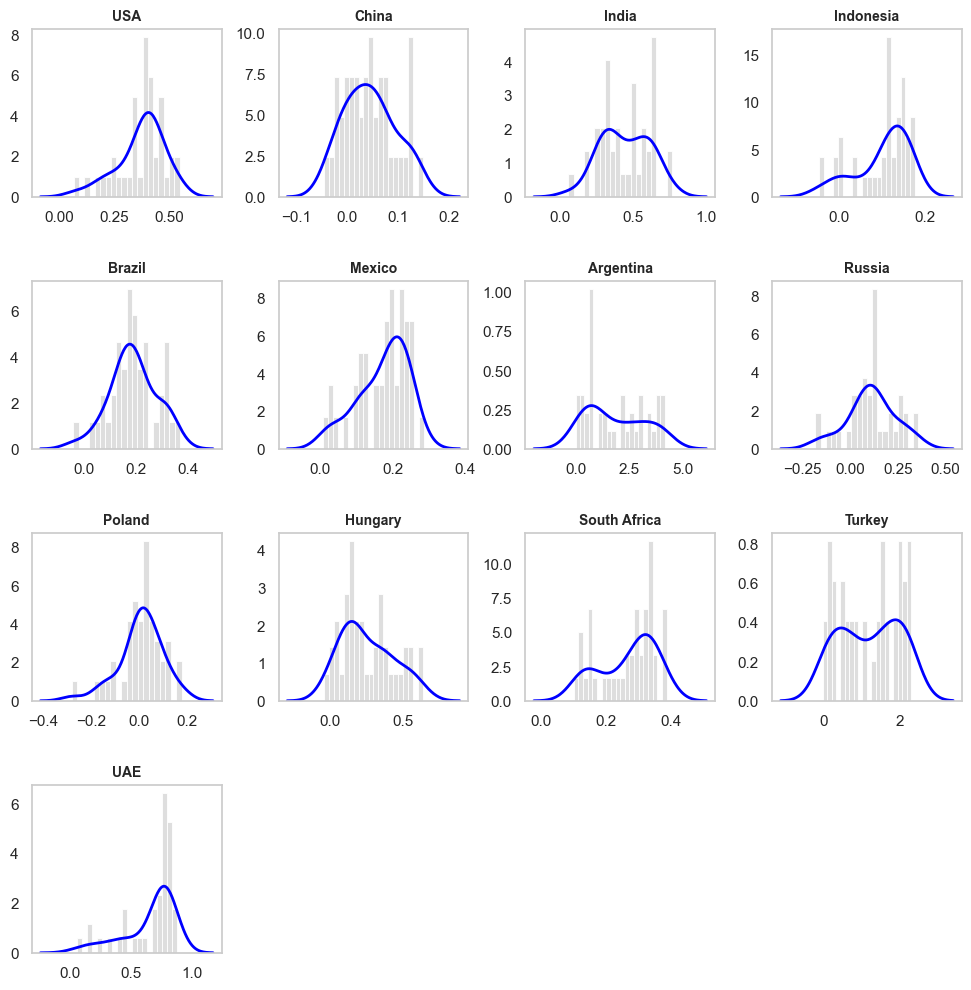

In [157]:
plt.close('all')
sns.set(style="whitegrid")

n_countries = len(countries)
n_cols = 4
n_rows = (n_countries // n_cols) + (n_countries % n_cols > 0)

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(12, 3 * n_rows))
fig.subplots_adjust(hspace=0.5, wspace=0.3)

axes = axes.flatten()

for i, (country, residual_dict) in enumerate(model_residuals.items()):
    ax = axes[i]
    if 'XGBoost' in residual_dict:
        residuals = residual_dict['XGBoost']

        sns.histplot(residuals, bins=20, kde=False, color="lightgrey", ax=ax, stat="density")
        sns.kdeplot(residuals, color="blue", ax=ax, lw=2)

        ax.set_title(f'{country}', fontsize=10, fontweight='bold')
        ax.set_xlabel(None)
        ax.set_ylabel(None)
        ax.grid(False)

for j in range(i + 1, len(axes)):
    axes[j].set_visible(False)

plt.show()

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/3870931591.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


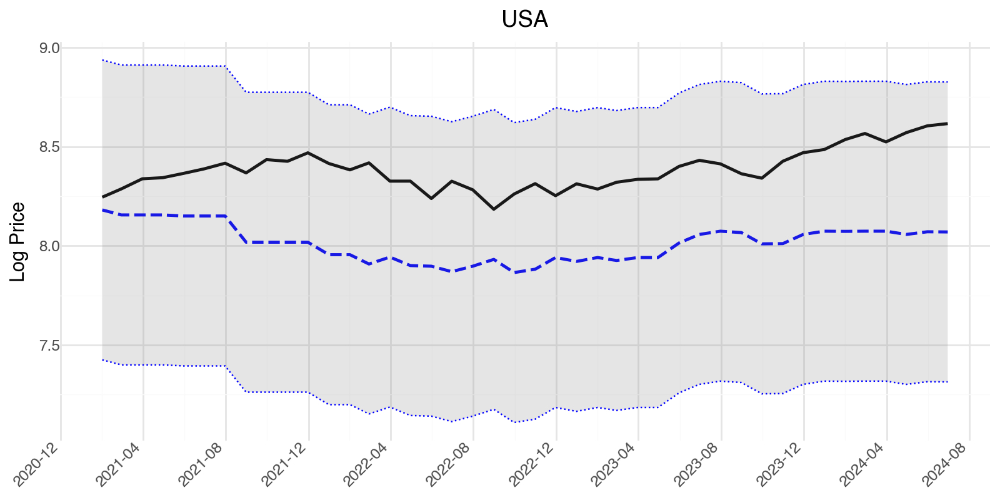

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/3870931591.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


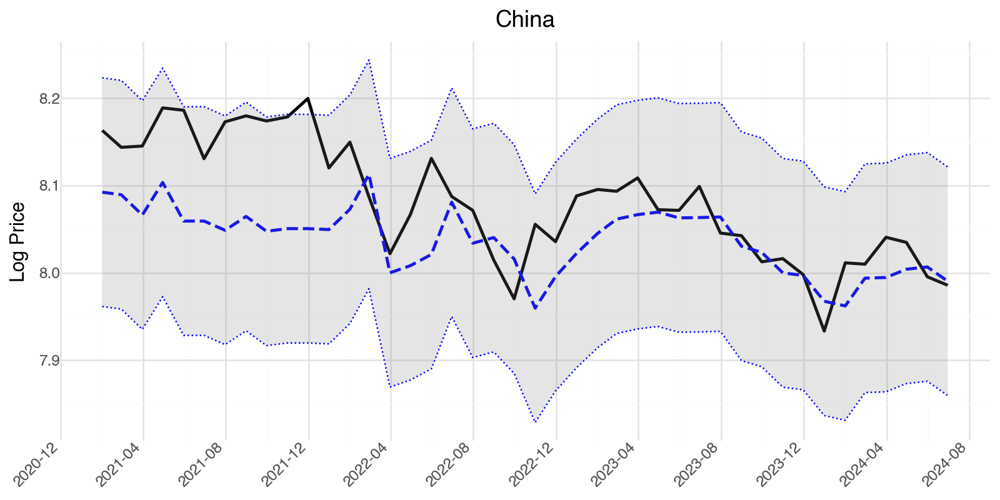

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/3870931591.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


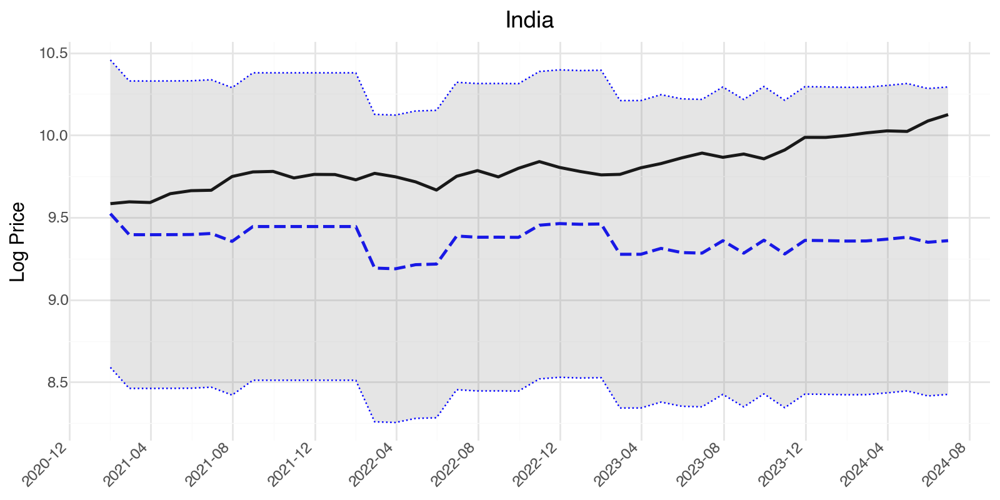

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/3870931591.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


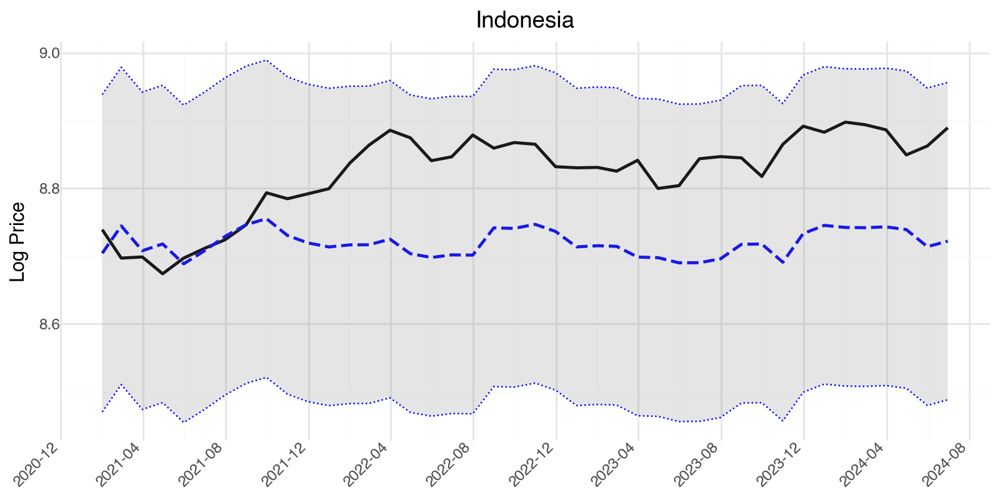

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/3870931591.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


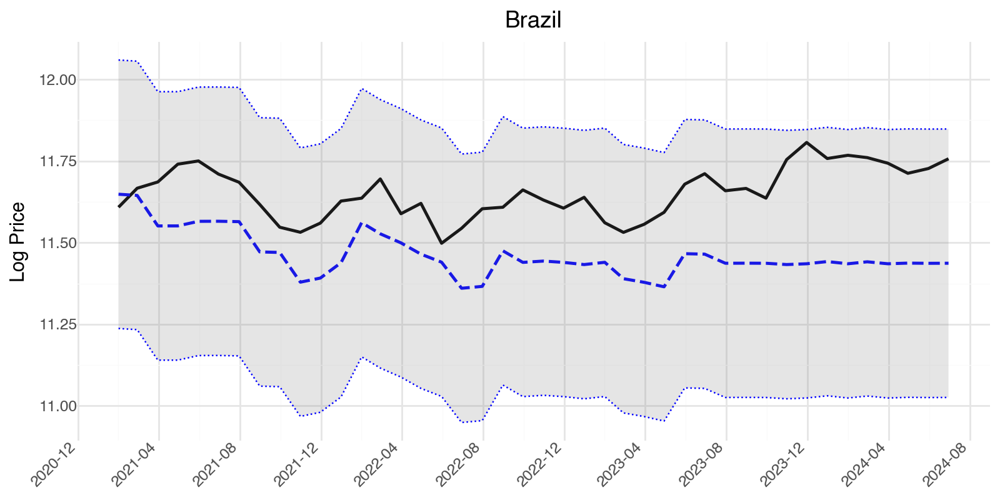

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/3870931591.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


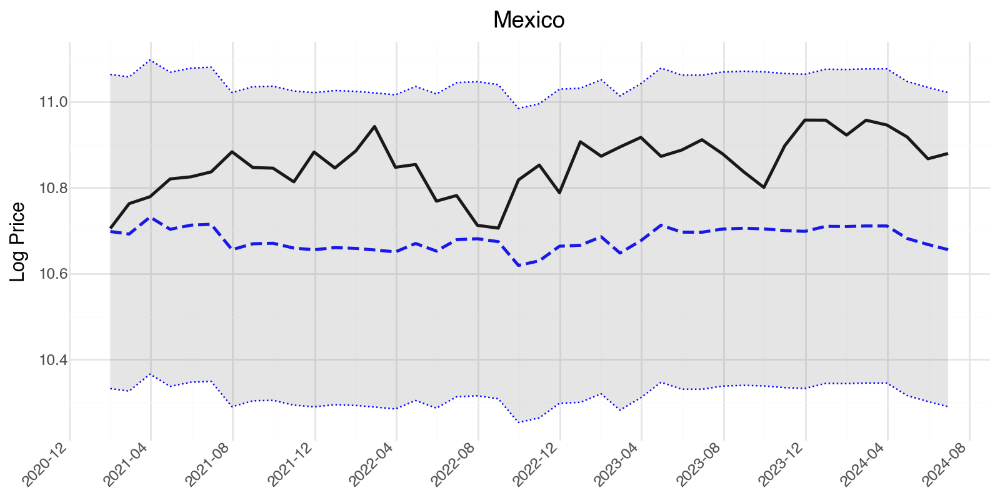

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/3870931591.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


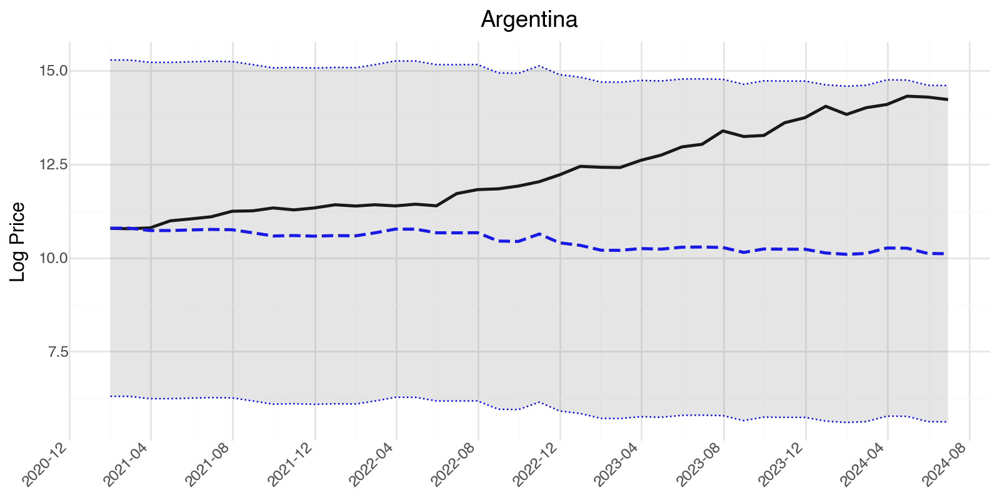

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/3870931591.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


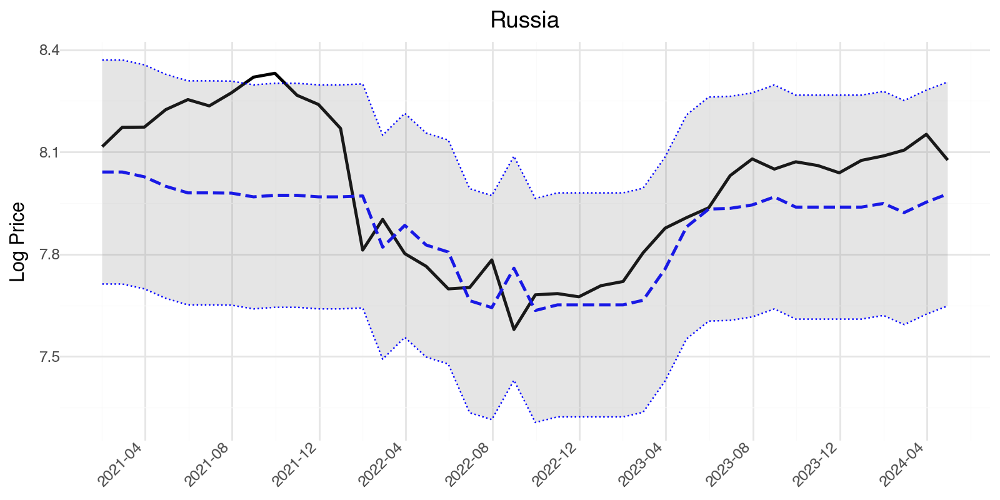

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/3870931591.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


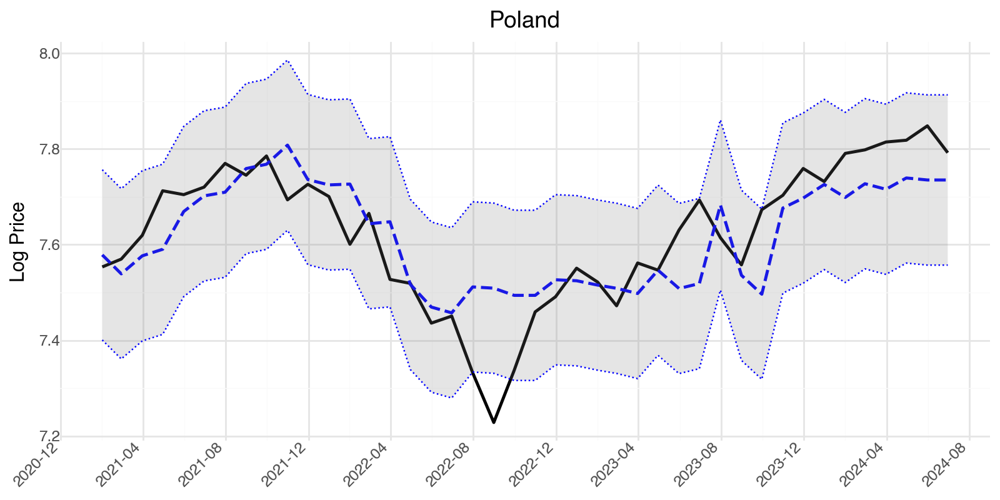

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/3870931591.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


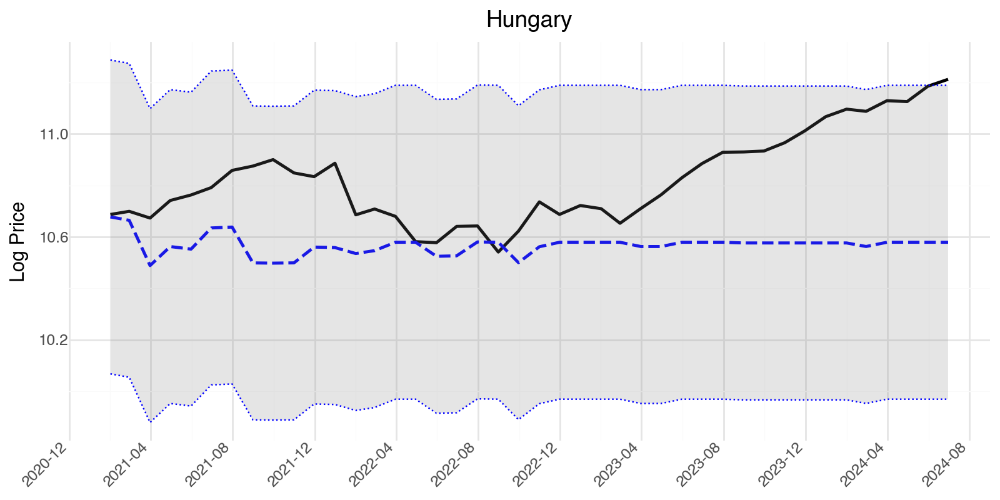

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/3870931591.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


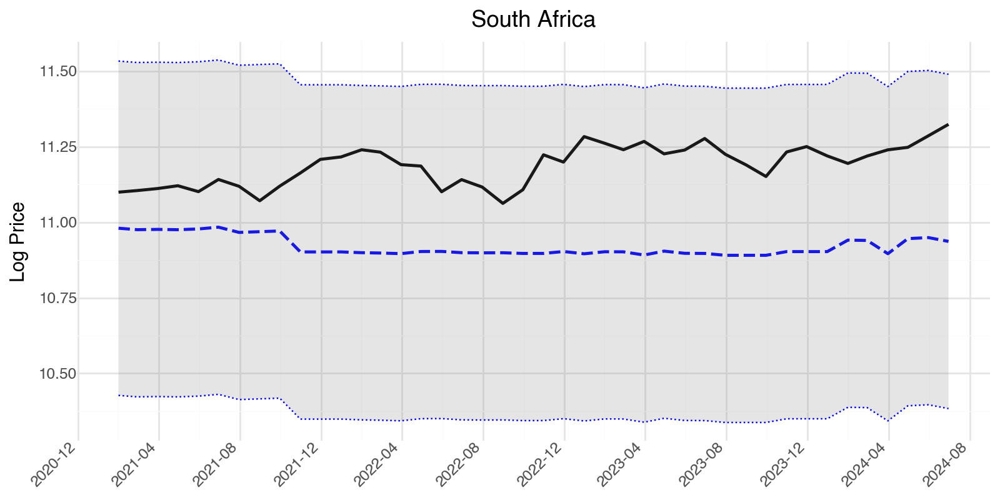

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/3870931591.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


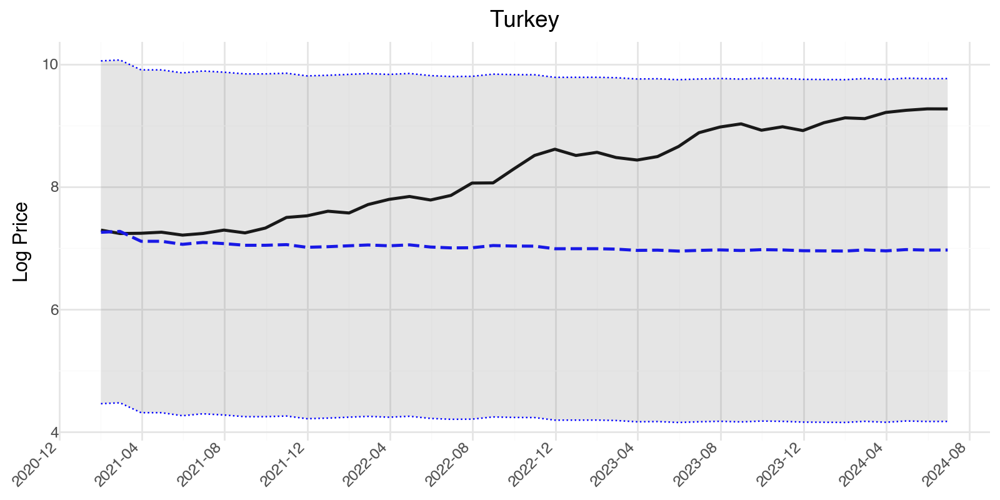

/var/folders/1q/twm_2bh13tq4lzzc3_1xf9yc0000gn/T/ipykernel_66062/3870931591.py:41: FutureWarning: Using print(plot) to draw and show the plot figure is deprecated and will be removed in a future version. Use plot.show().


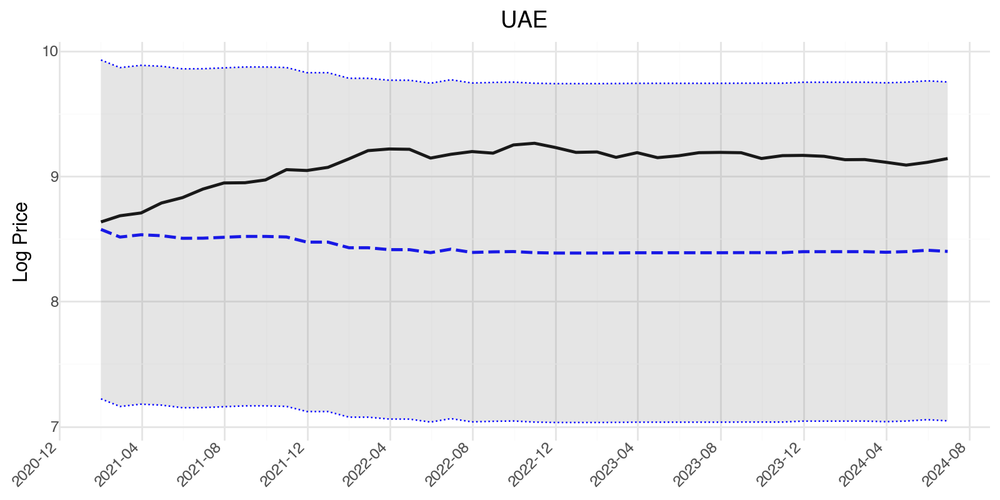

In [158]:
def plot_actual_vs_predicted_ggplot_xgboost(countries_data, predictions, original_dfs):
    plots = []
    for country, test_df in countries_data.items():
        original_df = original_dfs[country]

        y_actual = original_df.loc[test_df.index, 'Price_log_t1']
        y_pred = predictions[country]['XGBoost']

        lower_bound, upper_bound = calculate_confidence_intervals(y_pred, y_actual)

        df_plot = pd.DataFrame({
            'Date': test_df.index,
            'Actual': y_actual,
            'Predicted': y_pred,
            'Lower': lower_bound,
            'Upper': upper_bound
        })

        p = (ggplot(df_plot, aes(x='Date')) +
             geom_line(aes(y='Actual'), color='black', size=1.0) +
             geom_line(aes(y='Predicted'), color='blue', linetype='dashed', size=1.0) +
             geom_ribbon(aes(ymin='Lower', ymax='Upper'), alpha=0.2, fill='grey') +
             geom_line(aes(y='Lower'), linetype='dotted', color='blue', size=0.5) +
             geom_line(aes(y='Upper'), linetype='dotted', color='blue', size=0.5) +
             ggtitle(f'{country}') +
             scale_x_datetime(date_labels='%Y-%m', date_breaks='4 months') +
             xlab('') + 
             ylab('Log Price') +
             theme_minimal() +
             theme(
                 axis_text_x=element_text(rotation=45, hjust=1),
                 figure_size=(8, 4),
             ))

        plots.append(p)

    return plots

plots = plot_actual_vs_predicted_ggplot_xgboost(X_tests, model_predictions, countries)
for p in plots:
    print(p)

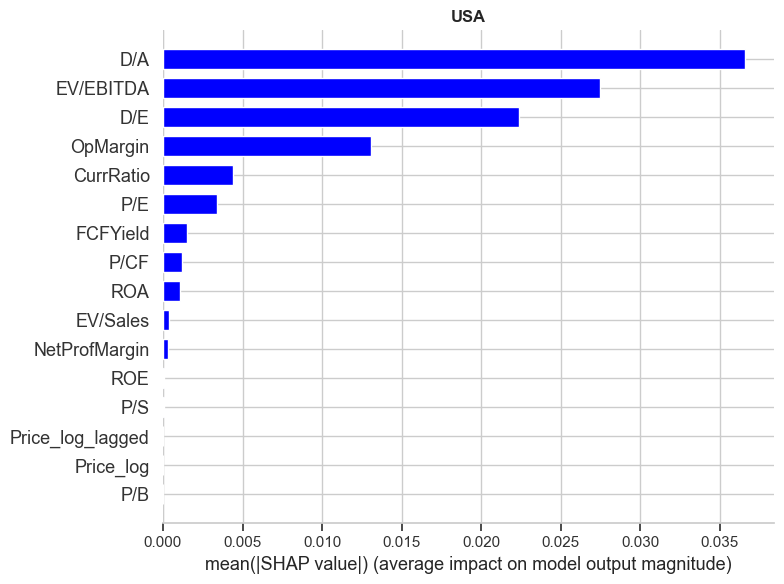

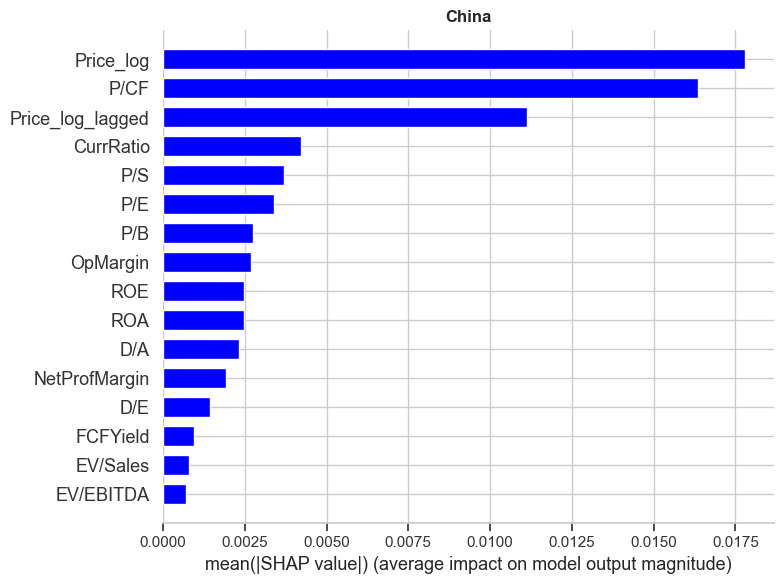

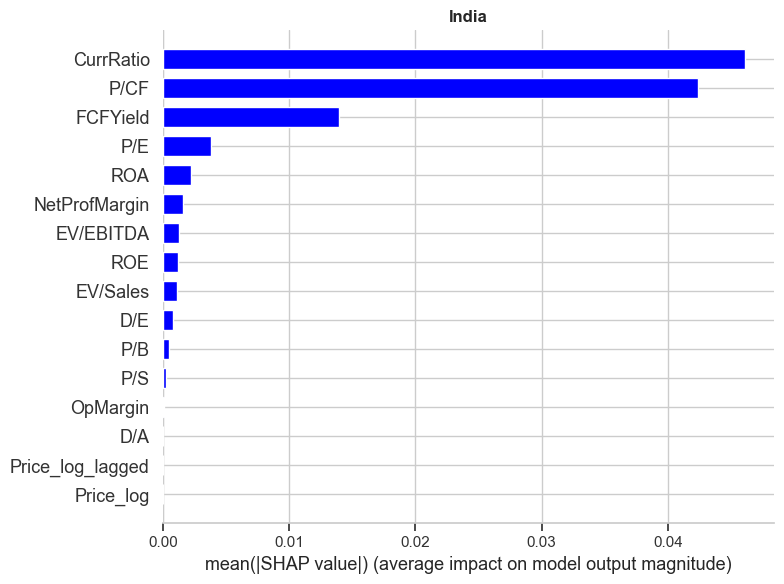

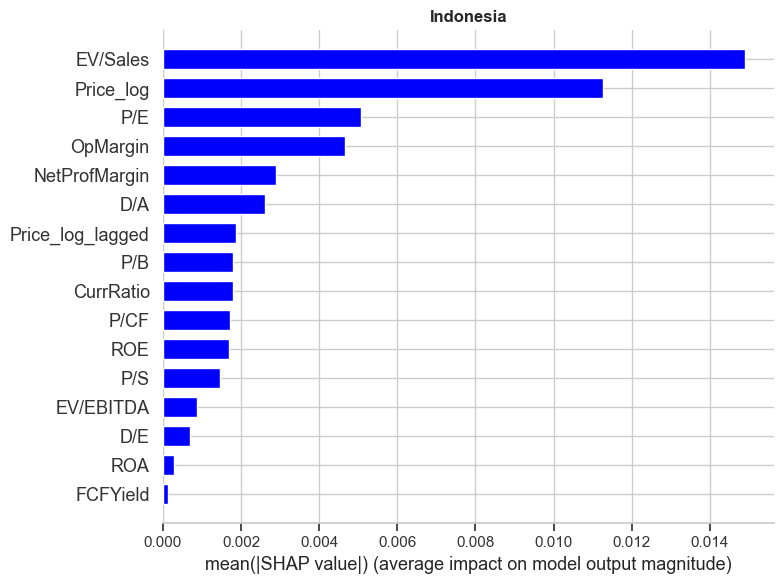

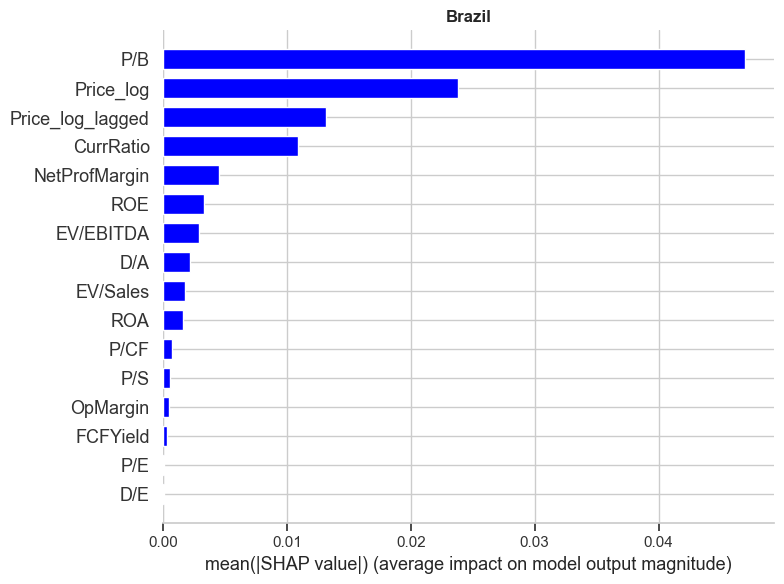

...

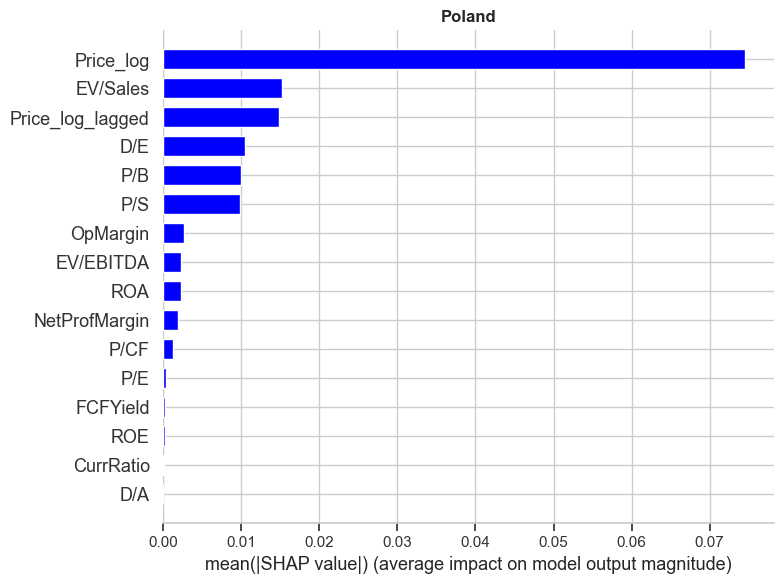

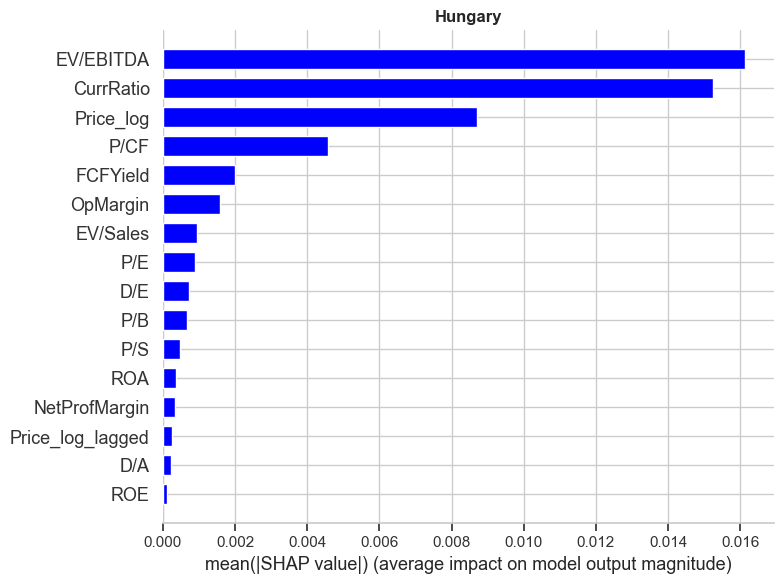

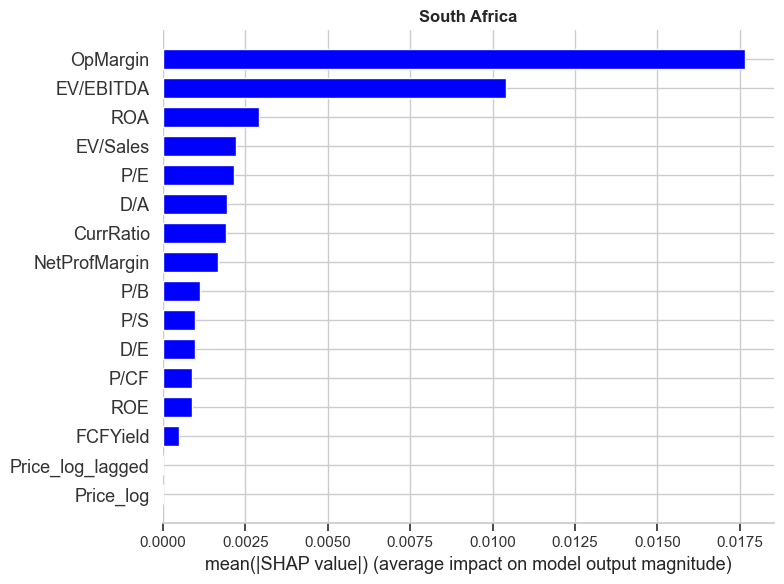

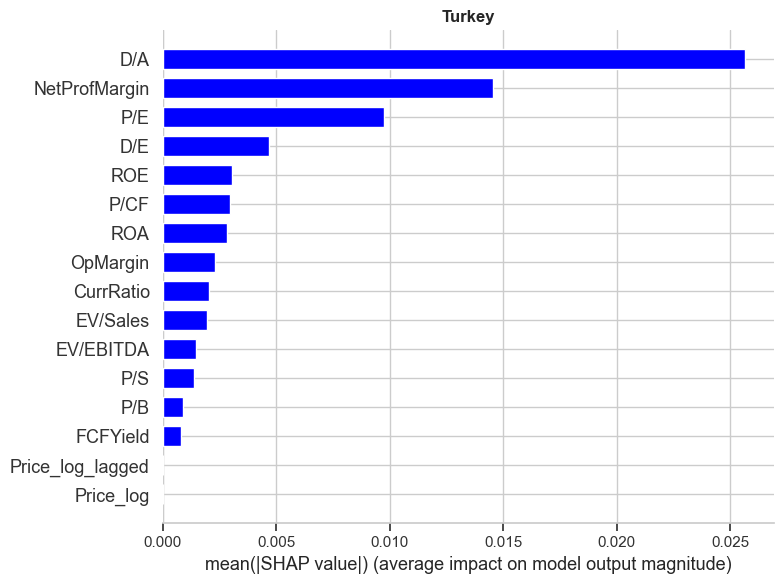

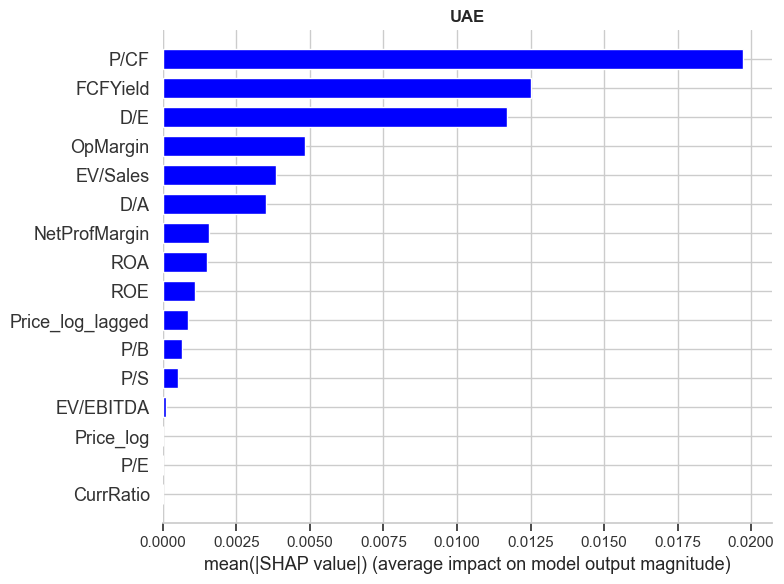

In [159]:
def plot_shap_summary_xgboost(models, X_tests):
    for country in X_tests:
        model_key = f'model_xgb_{country}'
        model = models.get(model_key)
        X_test = X_tests.get(country)

        if model is not None and X_test is not None:
            best_model = model.best_estimator_

            explainer = shap.Explainer(best_model, X_test)
            shap_values = explainer(X_test)

            plt.figure()
            plt.title(f'{country}', fontweight='bold')
            shap.summary_plot(shap_values, X_test, plot_type="bar", plot_size=(8, 6), color='blue')
        else:
            print(f"Model or X_test not found for {country} using XGBoost.")

plot_shap_summary_xgboost(models, X_tests)